In [6]:
import pandas as pd
import time
import numpy as np
from matplotlib import pyplot as plt
from sklearn import linear_model
from sklearn import model_selection
import datetime
from sklearn import preprocessing
from scipy import signal
import tensorflow as tf


In [8]:

df = pd.read_csv('m5-forecasting-accuracy/sales_train_evaluation.csv')
calendar = pd.read_csv('m5-forecasting-accuracy/sell_prices.csv')
prices = pd.read_csv('m5-forecasting-accuracy/calendar.csv')

In [11]:
#unique values
cats = df.cat_id.unique()
depts = df.dept_id.unique()
states = df.state_id.unique()
stores = df.store_id.unique()

In [17]:
#the price dataframe has a list of all time indicies
all_forecast_features = list(prices.d.values)

#time range based on train, validation forecast windows
all_features =['d_'+str(i) for i in range(1,1942)]
features =['d_'+str(i) for i in range(1,1914)]

#merge calendar info with price (price over time)
price_series = prices.merge(calendar,on='wm_yr_wk')

In [14]:
#remove evaluation data tag
df.id = df.id.apply(lambda x: x.replace('_evaluation',''))

In [18]:
#create the id tag from the item id and store id
price_series['id'] = price_series['item_id']+'_'+price_series['store_id']
#create a price pivot table for id and time index
price_series = price_series[['d','sell_price','id']]
price_series = price_series.pivot(index='id',columns='d',values='sell_price')

In [19]:
#null values in the pivot table
no_sales = price_series[all_forecast_features].isnull().astype(np.int16).reset_index()
no_sales

d,id,d_1,d_2,d_3,d_4,d_5,d_6,d_7,d_8,d_9,...,d_1960,d_1961,d_1962,d_1963,d_1964,d_1965,d_1966,d_1967,d_1968,d_1969
0,FOODS_1_001_CA_1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,FOODS_1_001_CA_2,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,FOODS_1_001_CA_3,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,FOODS_1_001_CA_4,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,FOODS_1_001_TX_1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30485,HOUSEHOLD_2_516_TX_2,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
30486,HOUSEHOLD_2_516_TX_3,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
30487,HOUSEHOLD_2_516_WI_1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
30488,HOUSEHOLD_2_516_WI_2,1,1,1,1,1,1,1,1,1,...,0,0,0,0,0,0,0,0,0,0


In [97]:
price_series = price_series[all_forecast_features].copy().reset_index()

In [26]:
_min_ = df[features].min(axis=1).values.reshape(-1,1)
_max_ = df[features].max(axis=1).values.reshape(-1,1)

In [27]:
#unit normalize each series 
df_norm = pd.DataFrame((df[all_features].values-_min_)/(_max_-_min_),columns=all_features)
df_norm = pd.concat([df[['id','item_id','cat_id','dept_id','state_id','store_id']],df_norm],axis=1)


In [28]:
#cluster correlated time series together 
def maxShiftCorr(a,shift):
    b = a[:,shift:].dot(a.T[:a.shape[1]-shift])
    return b/a.shape[1]-shift

mat = maxShiftCorr(df_norm[get_prev_100_days(N+28)].values,0)

from sklearn import cluster

kmeans = cluster.KMeans(30)

kmeans.fit(mat)

clstrs = kmeans.predict(mat)

np.save('kmeans_clstrs.npy',clstrs)

In [ ]:
clstrs = np.load('kmeans_clstrs.npy')

In [26]:
# np.save('stores.npy',stores,allow_pickle=True)
# np.save('states.npy',states,allow_pickle=True)
# np.save('depts.npy',depts,allow_pickle=True)
# np.save('cats.npy',depts,allow_pickle=True)

# stores = np.load('stores.npy',allow_pickle=True)
# states = np.load('states.npy',allow_pickle=True)
# depts = np.load('depts.npy',allow_pickle=True)
# cats = np.load('cats.npy',allow_pickle=True)

# Model Definition

In [ ]:
def create_model(series_num,layer_sizes):

    series_input = tf.keras.Input(shape=(48,series_num))
    
    series_lstm0 = tf.keras.layers.LSTM(layer_sizes[0], return_sequences = True)(series_input)

    series_dropout0 = tf.keras.layers.Dropout(0.1)(series_lstm0)
    
    series_lstm1 = tf.keras.layers.LSTM(layer_sizes[1], return_sequences = True)(series_dropout0)

    series_dropout1 = tf.keras.layers.Dropout(0.2)(series_lstm1)
    
    series_lstm2 = tf.keras.layers.LSTM(layer_sizes[1])(series_dropout1)

    series_dropout2 = tf.keras.layers.Dropout(0.2)(series_lstm2)
    
    output = tf.keras.layers.Dense(series_num, activation="linear")(series_dropout2)
    
    inputs = [series_input]

    model = tf.keras.Model(inputs, output)
    
    return model

optimizer = tf.keras.optimizers.Adam(learning_rate=0.001)


In [55]:
from tensorflow.python.framework import ops
from tensorflow.python.ops import math_ops
from tensorflow.python.keras import backend as K

@tf.function()
def mean_squared_percentage_error(y_true, y_pred):
    y_pred = ops.convert_to_tensor_v2(y_pred)
    y_true = math_ops.cast(y_true, y_pred.dtype)
    diff = K.mean( (math_ops.squared_difference(
        y_pred,y_true) / K.maximum(math_ops.abs(y_true), 1.0)),axis=-1)
    return 100. * diff

@tf.function()
def custom_mean_squared_error(y_true, y_pred,sw):

    sw = ops.convert_to_tensor_v2(sw)
    y_pred = ops.convert_to_tensor_v2(y_pred)
    y_true = math_ops.cast(y_true, y_pred.dtype)

    y_true_sum = tf.reduce_sum(y_true)
    y_pred_sum = tf.reduce_sum(y_pred)
    
    item_loss = K.mean(math_ops.squared_difference(y_pred,y_true)*sw)
    return item_loss

custom_loss = custom_mean_squared_error

In [56]:
def get_prev_365_days(day):
    return list(reversed(['d_'+str(day-i) for i in np.arange(0,365)]))

def get_prev_56_days(day):
    return list(reversed(['d_'+str(day-i) for i in np.arange(0,56)]))

def get_next_56_days(day):
    return ['d_'+str(day+i) for i in np.arange(1,57)]




def get_lag_1_days(day):
    return ['d_'+str(day-i) for i in np.arange(0,1)]

def get_lag_2_days(day):
    return ['d_'+str(day-i) for i in np.arange(1,2)]



def get_lag_7_days(day):
    return list(reversed(['d_'+str(day-i) for i in np.arange(6,7)]))


def get_lag_14_days(day):
    return list(reversed(['d_'+str(day-i) for i in np.arange(13,14)]))

def get_lag_28_days(day):
    return list(reversed(['d_'+str(day-i) for i in np.arange(27,28)]))




def get_prev_1_days(day):
    return ['d_'+str(day-i) for i in np.arange(0,1)]

def get_prev_7_days(day):
    return list(reversed(['d_'+str(day-i) for i in np.arange(0,7)]))

def get_prev_14_days(day):
    return list(reversed(['d_'+str(day-i) for i in np.arange(0,14)]))

def get_prev_21_days(day):
    return list(reversed(['d_'+str(day-i) for i in np.arange(0,21)]))

def get_prev_28_days(day):
    return list(reversed(['d_'+str(day-i) for i in np.arange(0,28)]))

def get_prev_35_days(day):
    return list(reversed(['d_'+str(day-i) for i in np.arange(0,35)]))

def get_prev_42_days(day):
    return list(reversed(['d_'+str(day-i) for i in np.arange(0,42)]))

def get_prev_48_days(day):
    return list(reversed(['d_'+str(day-i) for i in np.arange(0,48)]))


def get_prev_100_days(day):
    return list(reversed(['d_'+str(day-i) for i in np.arange(0,100)]))


def get_next_1_days(day):
    return ['d_'+str(day+i) for i in np.arange(1,2)]


def get_prev_1_next_1_days(day):
    return ['d_'+str(day+i) for i in np.arange(0,2)]


def get_prev_7_next_1_days(day):
    return ['d_'+str(day+i) for i in np.arange(-6,2)]


def get_prev_27_next_1_days(day):
    return ['d_'+str(day+i) for i in np.arange(-26,2)]


def get_prev_99_next_1_days(day):
    return ['d_'+str(day+i) for i in np.arange(-98,2)]

# Training Loop

In [ ]:
def train(dfx,model,modelid,iters=20):

    print('starting at {}'.format(1024))
    
    no_sl = dfx[['id']].merge(no_sales,on='id')
    
    for _ in range(iters):


        chunks = np.arange(1000,N,100)
        for window in range(20):
            
            preds = []
            actuals = []

            cnt = 0
            
            
            with tf.GradientTape() as tape:
                
                _tmi_ = []
                _y_ = []
                _sw_ = []
                
            
                random_selection = np.random.choice(np.arange(1000,N+28),size=64)
                for day in random_selection:

                    tmi_48 = dfx[get_prev_48_days(day)]   
        
                    tmi_48 = tmi_48.T.values.astype(np.float32)
            
                    tmi = np.expand_dims(tmi_48,axis=0)
                    _tmi_.append(tmi)

                    y = dfx[get_next_1_days(day)].values.astype(np.float32).reshape(1,-1)
                    _y_.append(y)
        


                    sw=(1-no_sl[get_prev_1_days(day)]).values.astype(np.float32).reshape(1,-1)
                    _sw_.append(sw)
                    

                _tmi_ = np.concatenate(_tmi_,axis=0)
                
                _y_ = np.concatenate(_y_,axis=0)
                
                
                _sw_ = np.concatenate(_sw_,axis=0)
                
                out = model([_tmi_],training=True)

                loss_value = custom_loss(_y_,out,_sw_)

                grads = tape.gradient(loss_value, model.trainable_variables)
                optimizer.apply_gradients(zip(grads, model.trainable_variables))



        print(modelid,_,loss_value.numpy())

        
        _cat_ = []
        _tmi_ = []

        _y_ = []
        
        for day in np.arange(len(features)-28,len(features)+28):


            tmi_48 = dfx[get_prev_48_days(day)]   

            tmi_48 = tmi_48.T.values.astype(np.float32)

            tmi = np.expand_dims(tmi_48,axis=0)
            _tmi_.append(tmi)

            y = dfx[get_next_1_days(day)].values.astype(np.float32).reshape(1,-1)
    
            _y_.append(y)



        _tmi_ = np.concatenate(_tmi_,axis=0)


        _y_ = np.concatenate(_y_,axis=0)


        y_pred = model.predict([_tmi_])

        loss_value = tf.keras.losses.MeanSquaredError()(_y_,y_pred)
        
        rand = np.random.choice(dfx.shape[0],1)[0]

        plt.plot(y_pred[:,rand])
        plt.plot(_y_[:,rand])
        plt.show()

        print('validation',loss_value.numpy())
        
#     model.save('m5autoreg/model_'+str(modelid))
    tf.saved_model.save(model,'m5autoreg/model_'+str(modelid))

In [78]:
N = len(features)

df shape 1045
starting at 1024
0_lstm 0 0.02135382


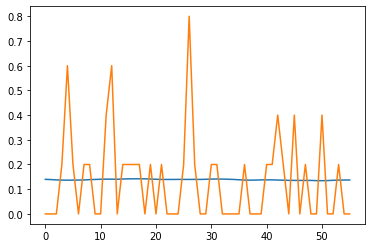

validation 0.02972834
0_lstm 1 0.021159654


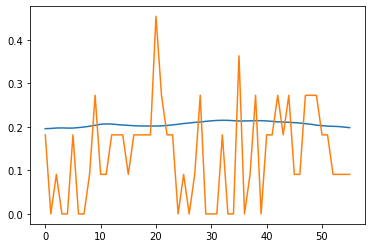

validation 0.029190736
0_lstm 2 0.020600809


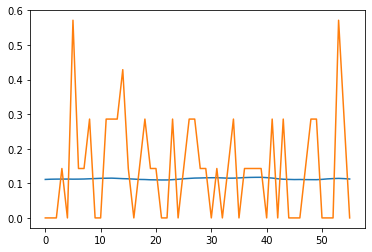

validation 0.029095626
0_lstm 3 0.020606857


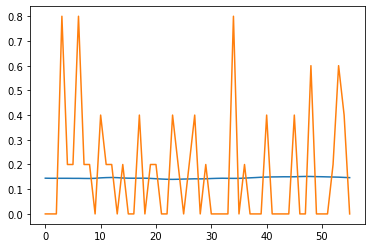

validation 0.028390205
0_lstm 4 0.019589908


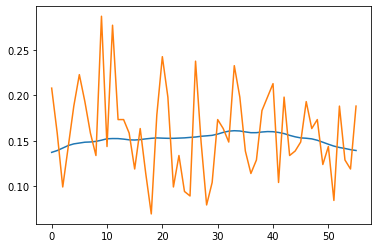

validation 0.0280683
0_lstm 5 0.018800167


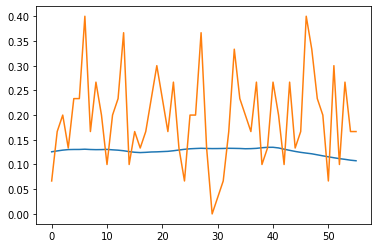

validation 0.027897839
0_lstm 6 0.019183803


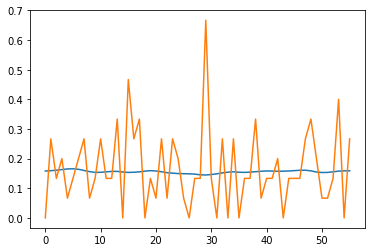

validation 0.02772591
0_lstm 7 0.020512296


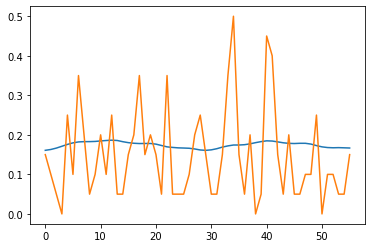

validation 0.027348667
0_lstm 8 0.019704087


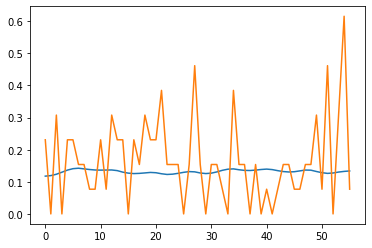

validation 0.027562294
0_lstm 9 0.01857517


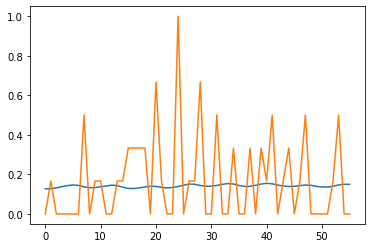

validation 0.02716876
0_lstm 10 0.019425854


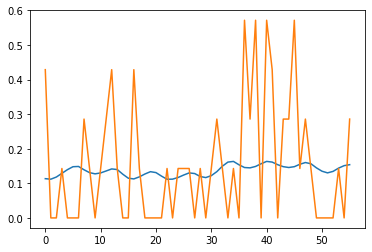

validation 0.026954005
0_lstm 11 0.01820701


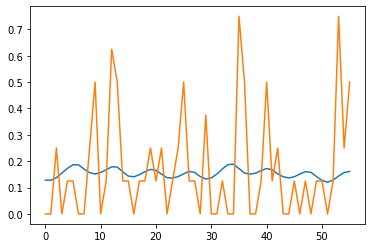

validation 0.026798751
0_lstm 12 0.018288968


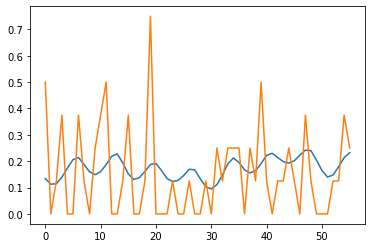

validation 0.026799956
0_lstm 13 0.018611846


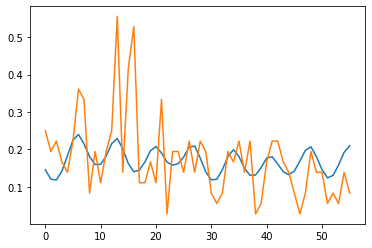

validation 0.02661485
0_lstm 14 0.01840457


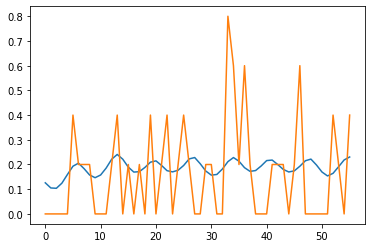

validation 0.026402827
0_lstm 15 0.018886128


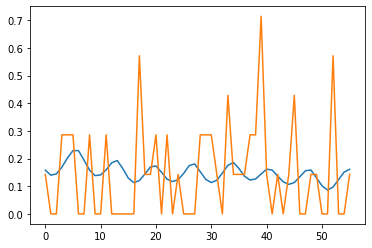

validation 0.026242448
0_lstm 16 0.018548422


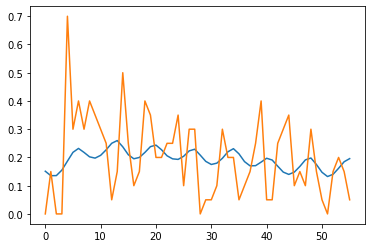

validation 0.026213527
0_lstm 17 0.018508408


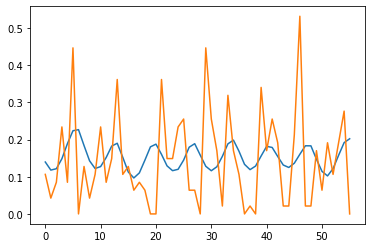

validation 0.026210265
0_lstm 18 0.017023267


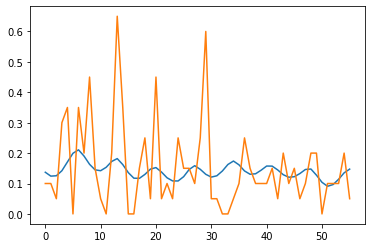

validation 0.025907537
0_lstm 19 0.018541208


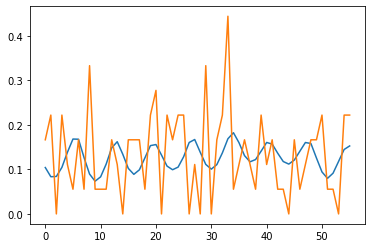

validation 0.025775287
0_lstm 20 0.017853992


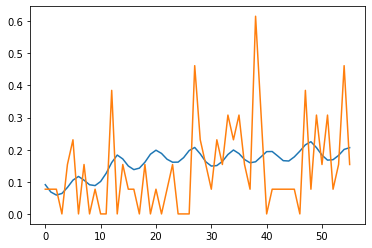

validation 0.025667993
0_lstm 21 0.017188702


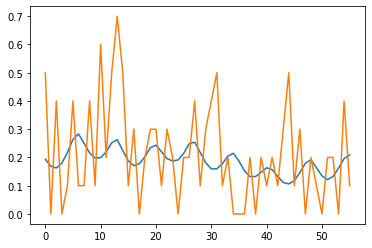

validation 0.025628757
0_lstm 22 0.017836412


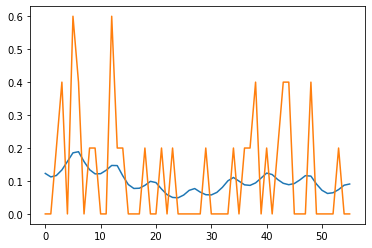

validation 0.02546571
0_lstm 23 0.01892693


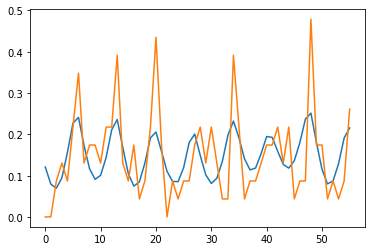

validation 0.02533144
0_lstm 24 0.01818192


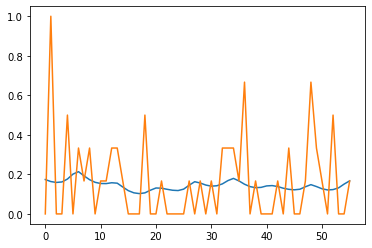

validation 0.02519877
0_lstm 25 0.018946854


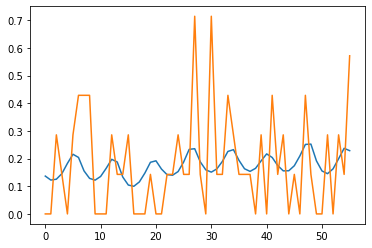

validation 0.025053402
0_lstm 26 0.017855763


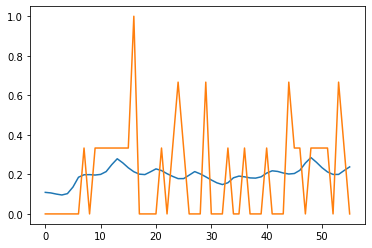

validation 0.024939483
0_lstm 27 0.017944492


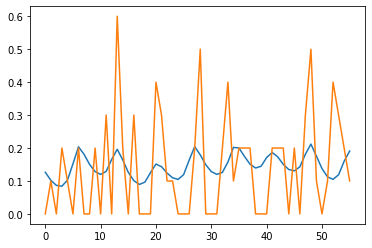

validation 0.024895072
0_lstm 28 0.017954074


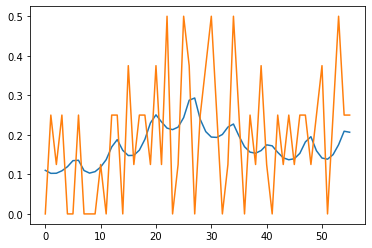

validation 0.02480965
0_lstm 29 0.01813441


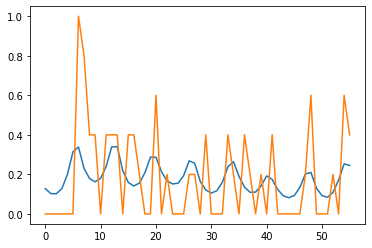

validation 0.024737434
Instructions for updating:
If using Keras pass *_constraint arguments to layers.
INFO:tensorflow:Assets written to: m5autoreg/model_0_lstm/assets
df shape 2231
starting at 1024
1_lstm 0 0.008887028


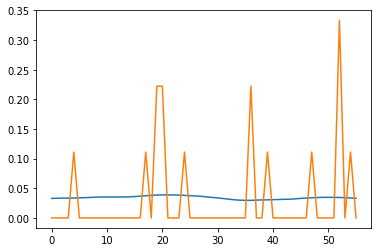

validation 0.007888769
1_lstm 1 0.009008469


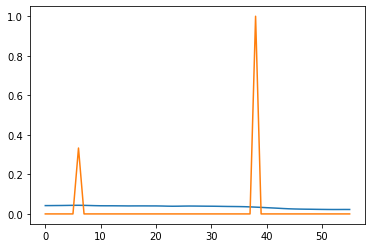

validation 0.0078036976
1_lstm 2 0.009012624


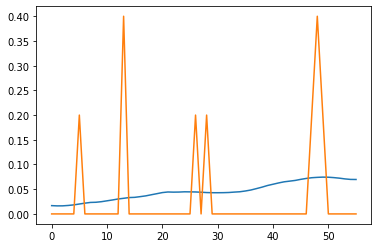

validation 0.0077411723
1_lstm 3 0.008471713


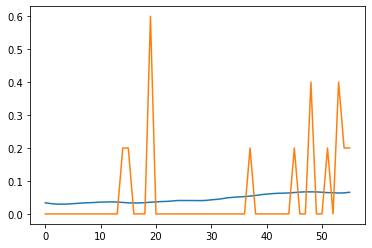

validation 0.0076316684
1_lstm 4 0.008548419


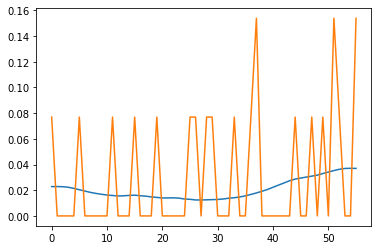

validation 0.007560047
1_lstm 5 0.008677341


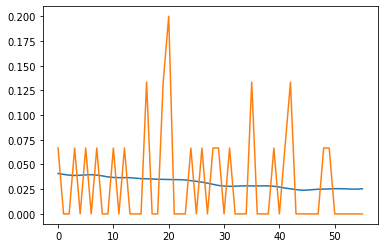

validation 0.0075573805
1_lstm 6 0.0086998595


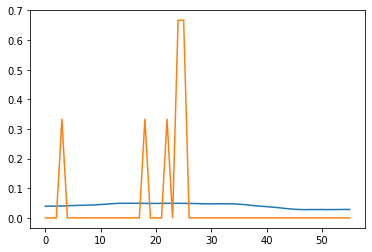

validation 0.007476848
1_lstm 7 0.008742676


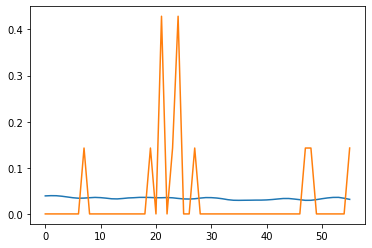

validation 0.0074527627
1_lstm 8 0.0086496025


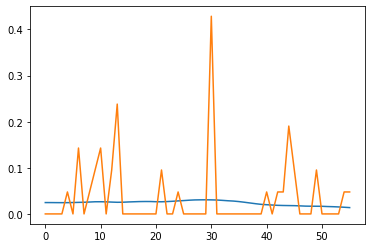

validation 0.0074363756
1_lstm 9 0.00810462


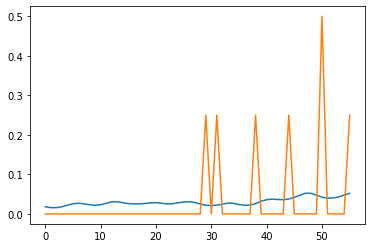

validation 0.0073978365
1_lstm 10 0.008360518


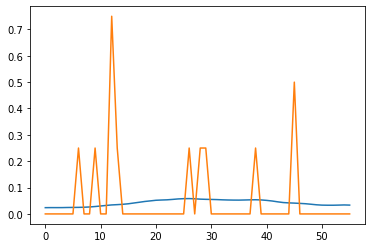

validation 0.0073799393
1_lstm 11 0.008473506


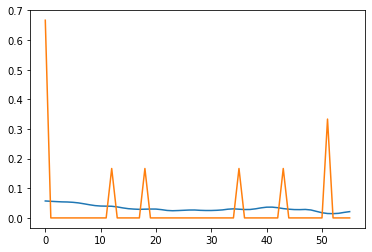

validation 0.007354143
1_lstm 12 0.007971302


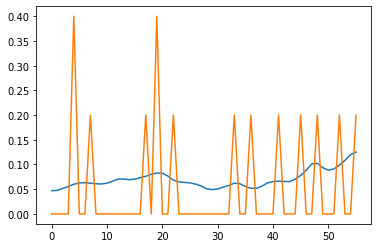

validation 0.007332507
1_lstm 13 0.008280274


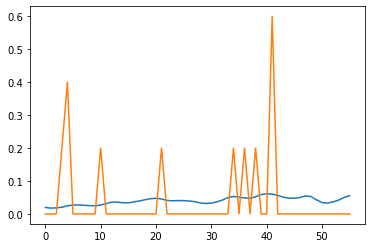

validation 0.0072825626
1_lstm 14 0.008364697


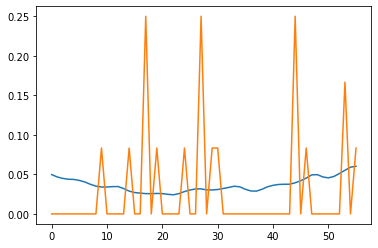

validation 0.007276933
1_lstm 15 0.008329249


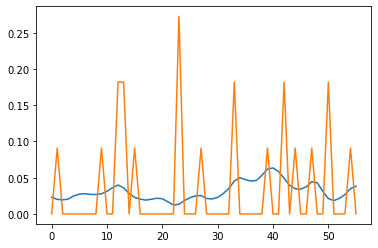

validation 0.0072454144
1_lstm 16 0.007958099


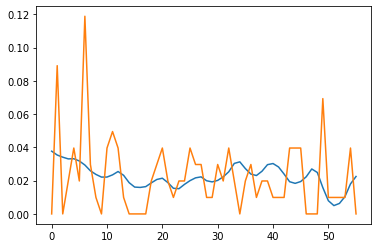

validation 0.0072078207
1_lstm 17 0.008185429


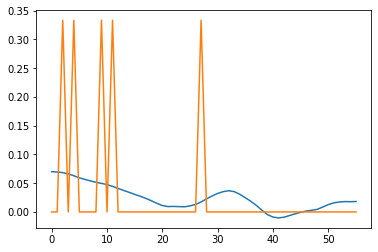

validation 0.007159497
1_lstm 18 0.007992214


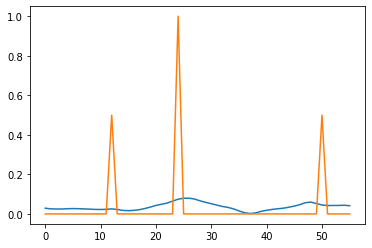

validation 0.007163745
1_lstm 19 0.008062577


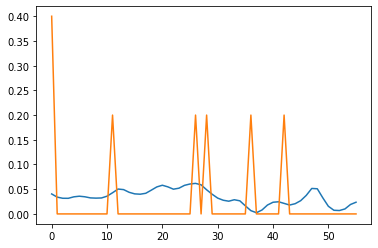

validation 0.0071176537
1_lstm 20 0.008203991


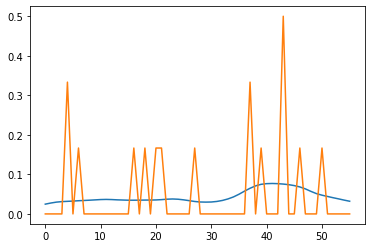

validation 0.007104949
1_lstm 21 0.008072952


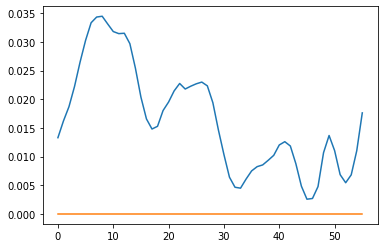

validation 0.0070886393
1_lstm 22 0.008025463


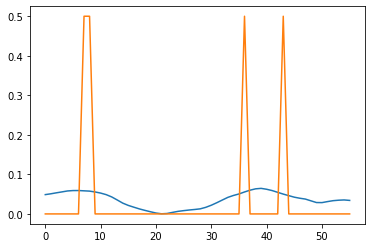

validation 0.0070586577
1_lstm 23 0.008166536


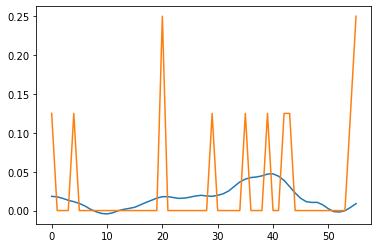

validation 0.0070131454
1_lstm 24 0.0080367895


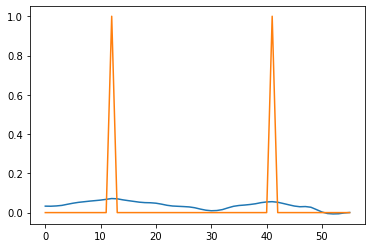

validation 0.007002431
1_lstm 25 0.0076391357


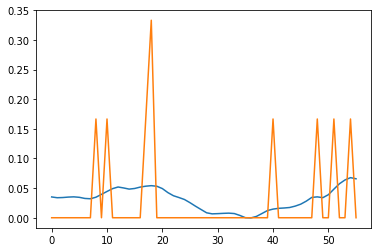

validation 0.006999715
1_lstm 26 0.007703376


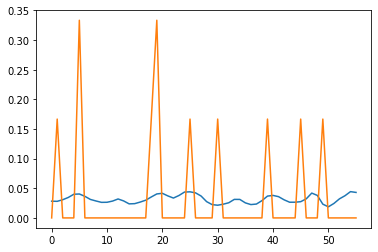

validation 0.0069980645
1_lstm 27 0.007680932


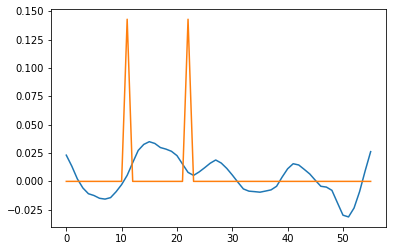

validation 0.006949982
1_lstm 28 0.007791693


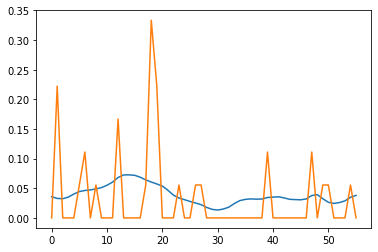

validation 0.0069614686
1_lstm 29 0.007987367


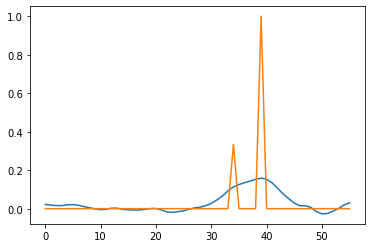

validation 0.0069291885
INFO:tensorflow:Assets written to: m5autoreg/model_1_lstm/assets
df shape 436
starting at 1024
2_lstm 0 0.02833528


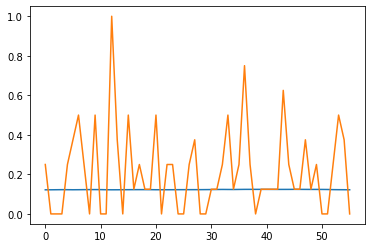

validation 0.042726
2_lstm 1 0.024674563


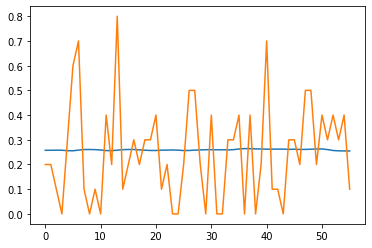

validation 0.03856055
2_lstm 2 0.025861377


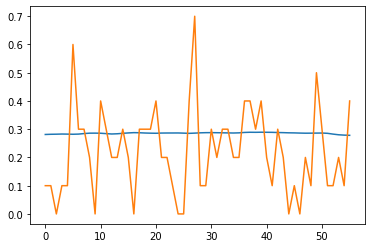

validation 0.037939787
2_lstm 3 0.025521642


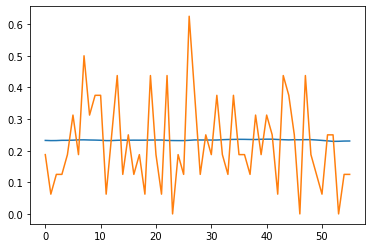

validation 0.036979932
2_lstm 4 0.023612464


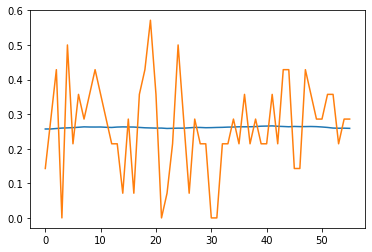

validation 0.036458425
2_lstm 5 0.02286166


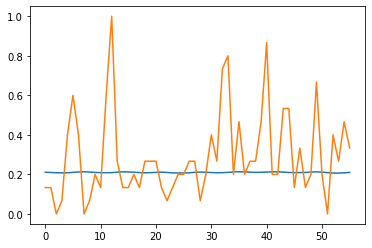

validation 0.036293168
2_lstm 6 0.024267087


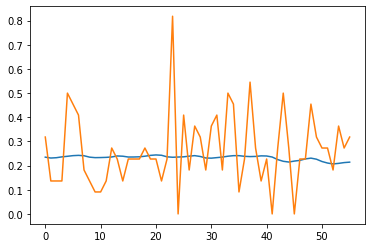

validation 0.035769813
2_lstm 7 0.023667583


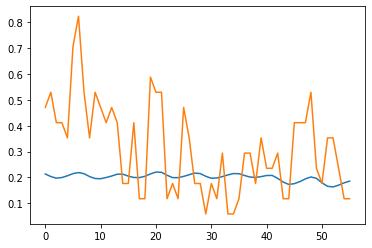

validation 0.035647083
2_lstm 8 0.02151435


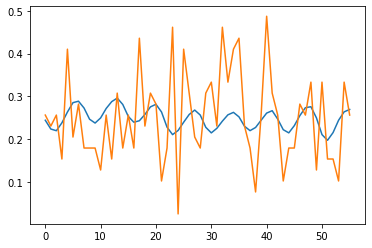

validation 0.03466645
2_lstm 9 0.023535054


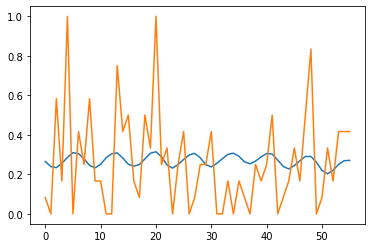

validation 0.034526166
2_lstm 10 0.02081416


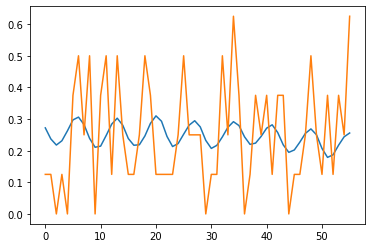

validation 0.034042887
2_lstm 11 0.02181953


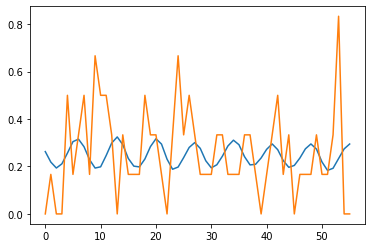

validation 0.033651676
2_lstm 12 0.021949355


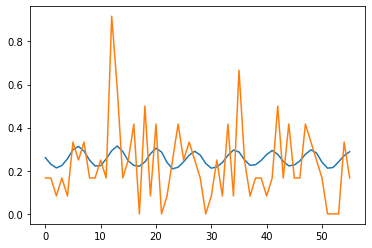

validation 0.033926614
2_lstm 13 0.02329247


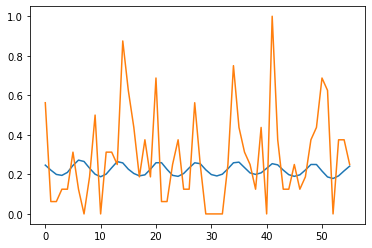

validation 0.033825442
2_lstm 14 0.021318808


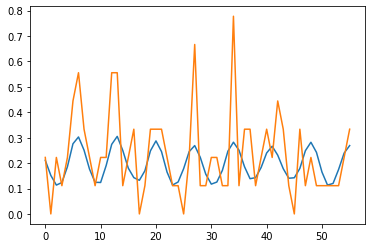

validation 0.033487428
2_lstm 15 0.02074836


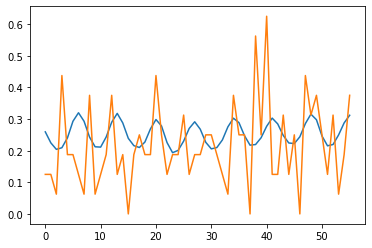

validation 0.033424526
2_lstm 16 0.022588935


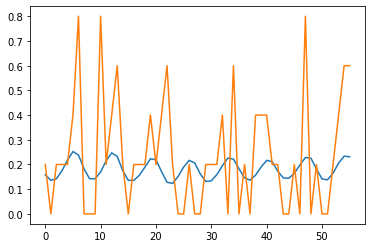

validation 0.033249687
2_lstm 17 0.021060117


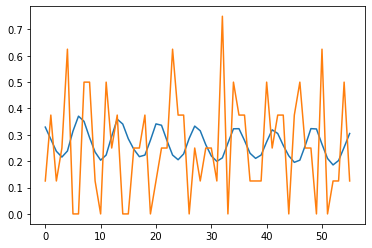

validation 0.032889657
2_lstm 18 0.021321688


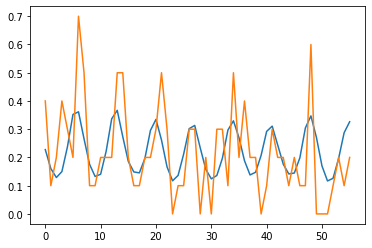

validation 0.032613438
2_lstm 19 0.021806778


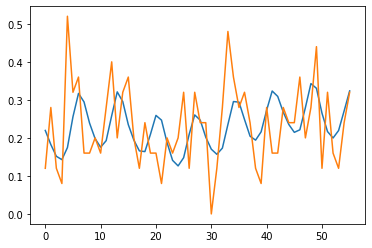

validation 0.0324121
2_lstm 20 0.020461466


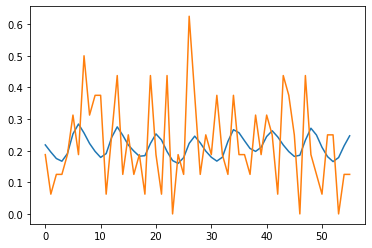

validation 0.032738045
2_lstm 21 0.019949948


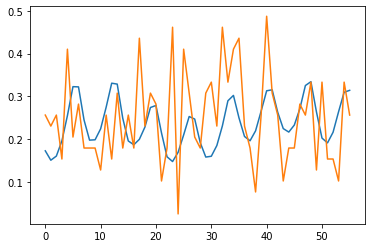

validation 0.032238096
2_lstm 22 0.020854702


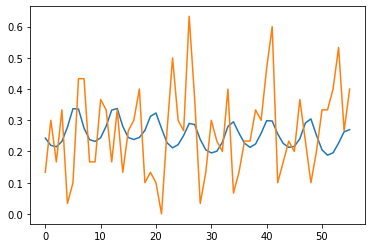

validation 0.032082465
2_lstm 23 0.02067463


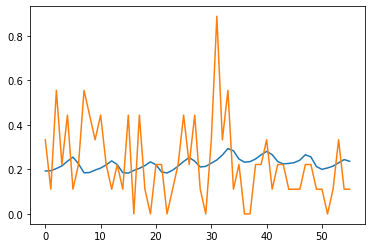

validation 0.03214262
2_lstm 24 0.01951907


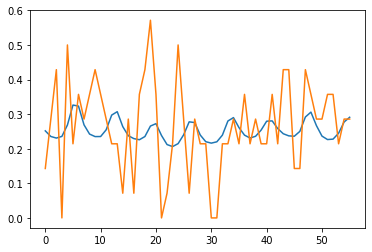

validation 0.032346662
2_lstm 25 0.020601774


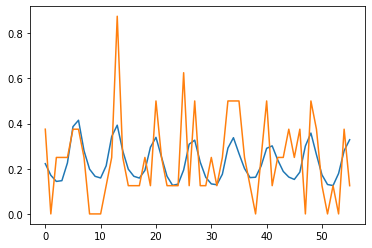

validation 0.031954013
2_lstm 26 0.01993745


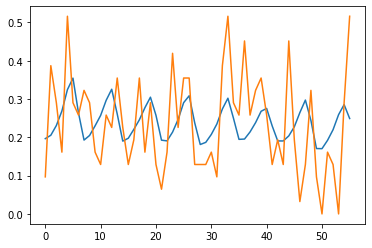

validation 0.031717755
2_lstm 27 0.021123383


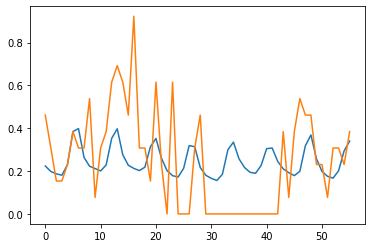

validation 0.031568564
2_lstm 28 0.021156464


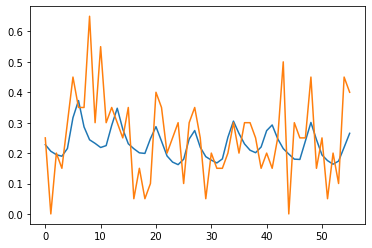

validation 0.031580202
2_lstm 29 0.018871145


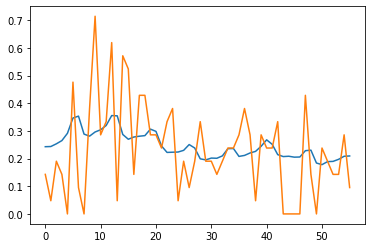

validation 0.03132501
INFO:tensorflow:Assets written to: m5autoreg/model_2_lstm/assets
df shape 1398
starting at 1024
3_lstm 0 0.017956497


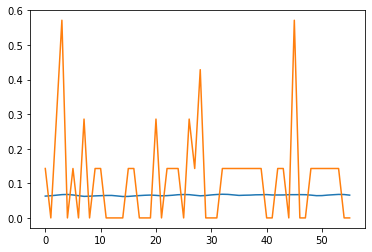

validation 0.019933565
3_lstm 1 0.018054483


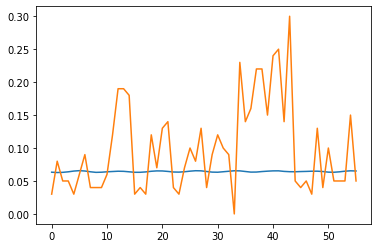

validation 0.019900749
3_lstm 2 0.01790514


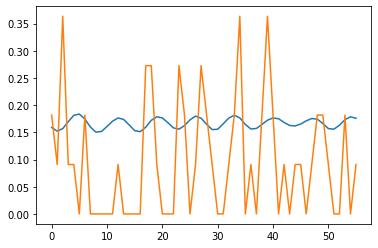

validation 0.0198448
3_lstm 3 0.017402733


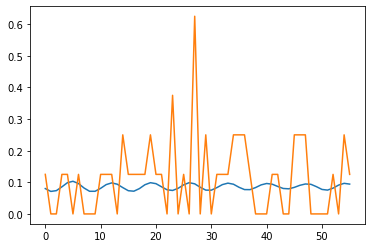

validation 0.019624168
3_lstm 4 0.01752843


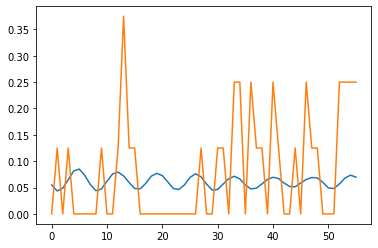

validation 0.019627113
3_lstm 5 0.017807016


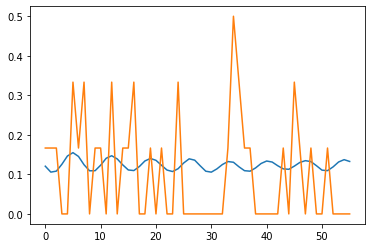

validation 0.019550307
3_lstm 6 0.01668507


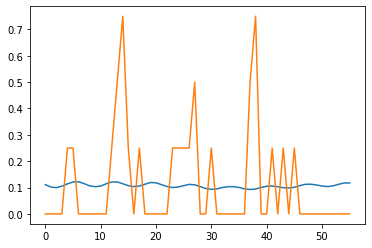

validation 0.019436177
3_lstm 7 0.017655587


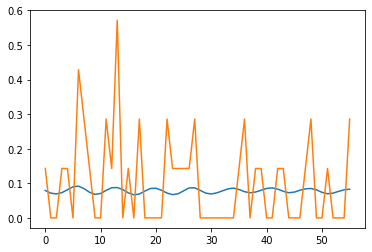

validation 0.019410579
3_lstm 8 0.016939722


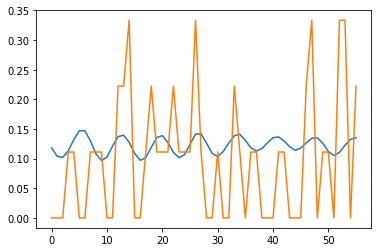

validation 0.01945962
3_lstm 9 0.018004654


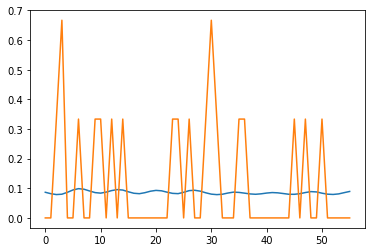

validation 0.019357417
3_lstm 10 0.016536336


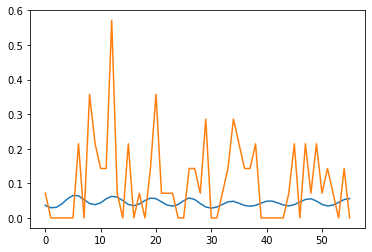

validation 0.01938435
3_lstm 11 0.017067729


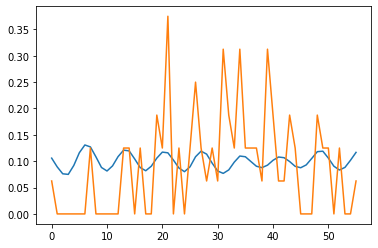

validation 0.019286036
3_lstm 12 0.017043218


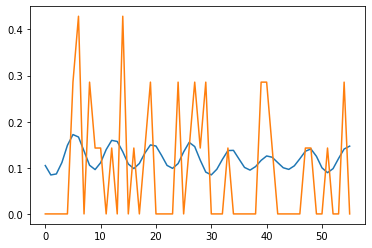

validation 0.019311665
3_lstm 13 0.01646154


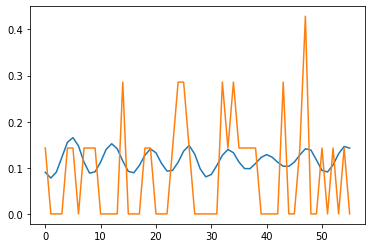

validation 0.019099286
3_lstm 14 0.016372073


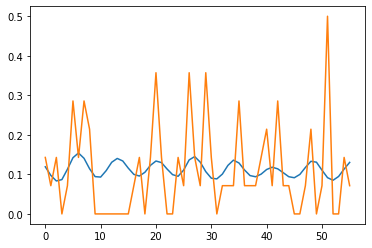

validation 0.019019127
3_lstm 15 0.016440501


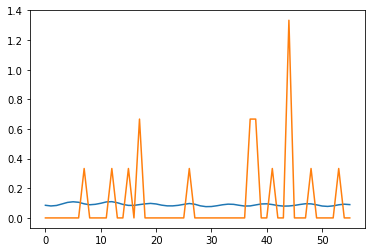

validation 0.019032475
3_lstm 16 0.016113628


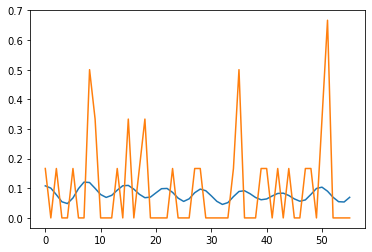

validation 0.019001931
3_lstm 17 0.016187182


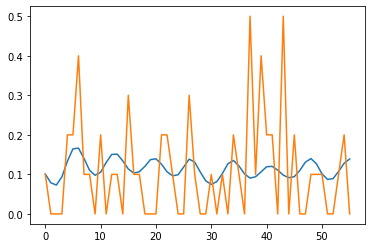

validation 0.018935665
3_lstm 18 0.016307982


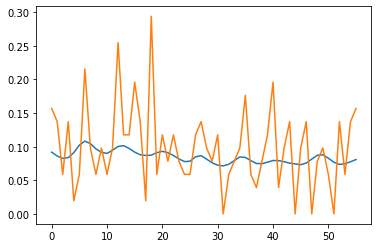

validation 0.018871218
3_lstm 19 0.016127242


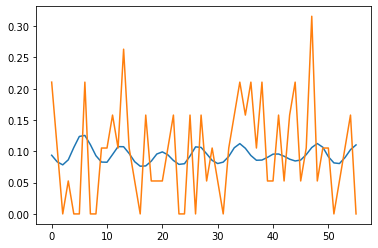

validation 0.018804302
3_lstm 20 0.015587262


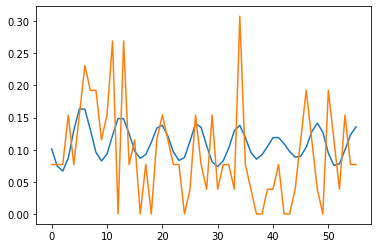

validation 0.018759431
3_lstm 21 0.016037866


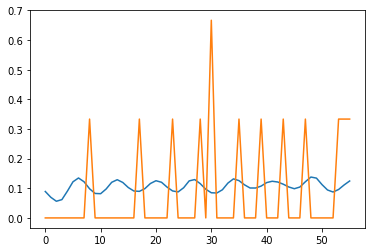

validation 0.018719802
3_lstm 22 0.017021412


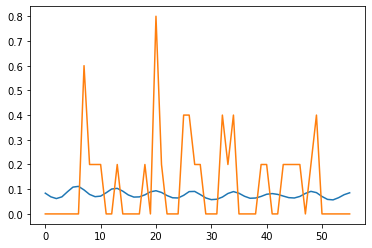

validation 0.018769985
3_lstm 23 0.015658496


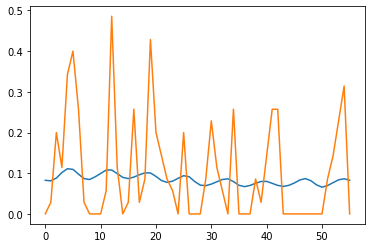

validation 0.018767696
3_lstm 24 0.015812932


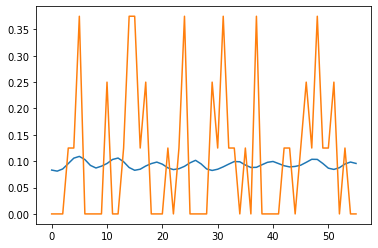

validation 0.018767353
3_lstm 25 0.015376638


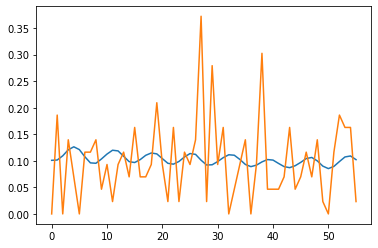

validation 0.018747734
3_lstm 26 0.016499592


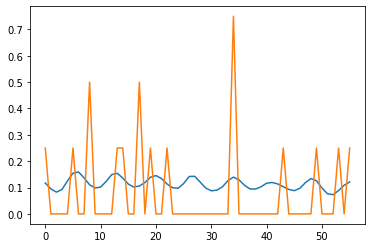

validation 0.018697364
3_lstm 27 0.016446214


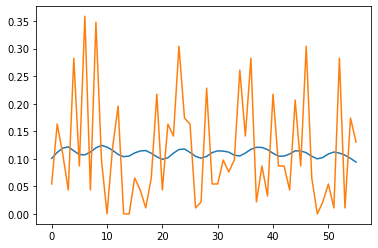

validation 0.018666307
3_lstm 28 0.015428901


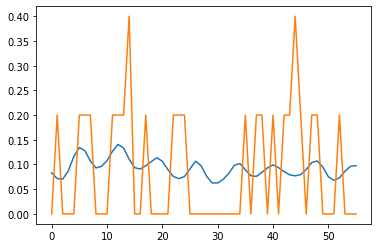

validation 0.018600425
3_lstm 29 0.0148634985


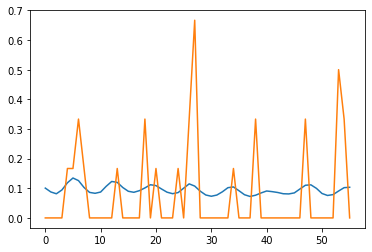

validation 0.01861347
INFO:tensorflow:Assets written to: m5autoreg/model_3_lstm/assets
df shape 1245
starting at 1024
4_lstm 0 0.0070113223


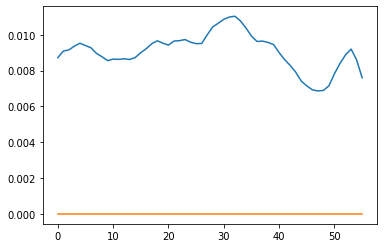

validation 0.0021709858
4_lstm 1 0.0070522814


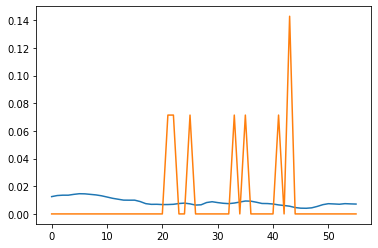

validation 0.0019332541
4_lstm 2 0.006803361


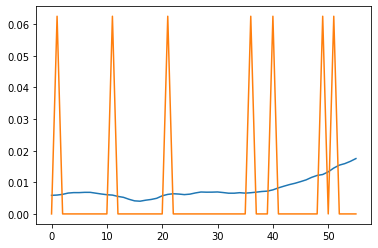

validation 0.0018832235
4_lstm 3 0.0070549333


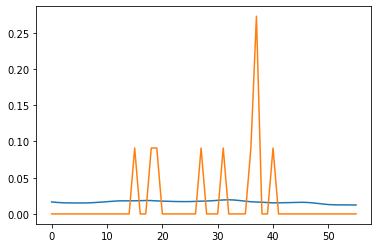

validation 0.0018872925
4_lstm 4 0.006418837


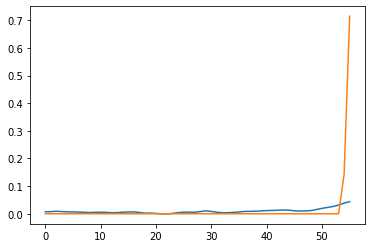

validation 0.0018694598
4_lstm 5 0.006842492


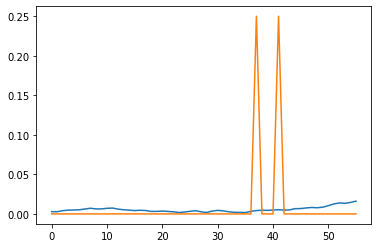

validation 0.0018740209
4_lstm 6 0.006353293


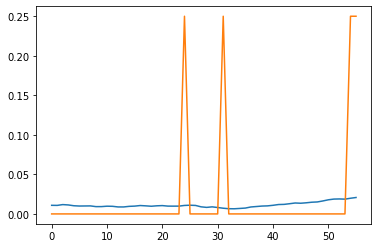

validation 0.0018683383
4_lstm 7 0.0065859645


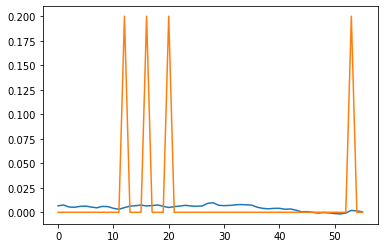

validation 0.0018607157
4_lstm 8 0.006771919


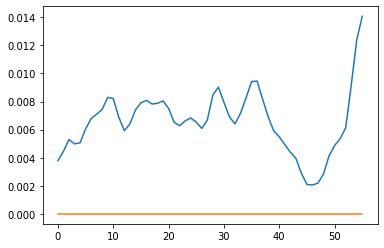

validation 0.001853064
4_lstm 9 0.0066549843


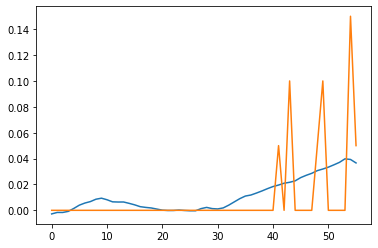

validation 0.0018442153
4_lstm 10 0.00657131


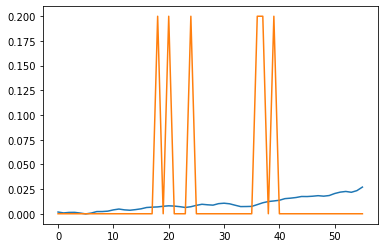

validation 0.0018323517
4_lstm 11 0.0061604735


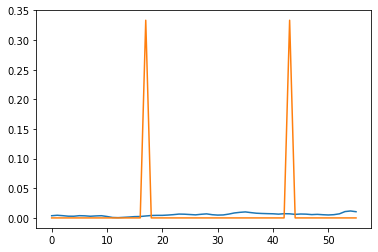

validation 0.001836728
4_lstm 12 0.005847833


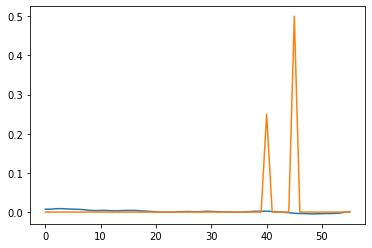

validation 0.0018217819
4_lstm 13 0.006737051


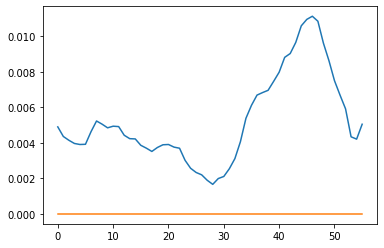

validation 0.001821287
4_lstm 14 0.006419258


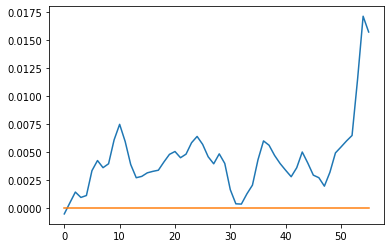

validation 0.0018194927
4_lstm 15 0.0055412143


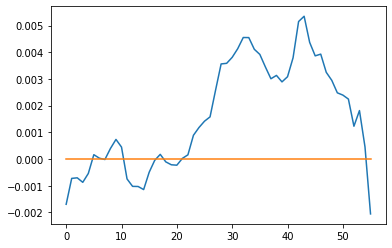

validation 0.0018221417
4_lstm 16 0.006148133


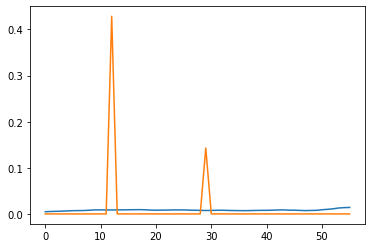

validation 0.001816867
4_lstm 17 0.0059144865


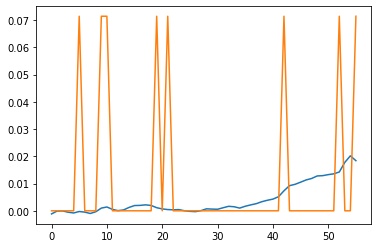

validation 0.0018111903
4_lstm 18 0.006579576


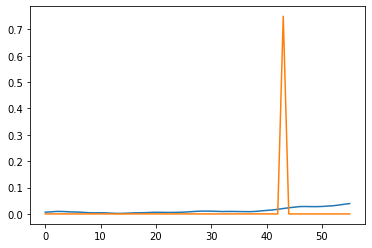

validation 0.001816259
4_lstm 19 0.0062944605


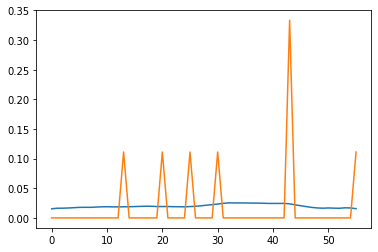

validation 0.0018122948
4_lstm 20 0.0062026954


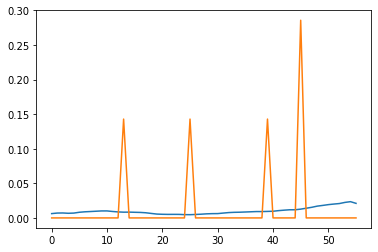

validation 0.0018112542
4_lstm 21 0.0059912363


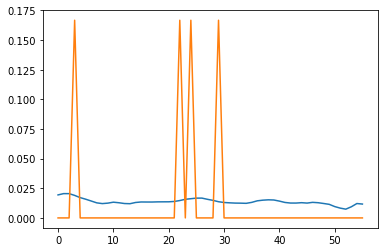

validation 0.0017927004
4_lstm 22 0.005919766


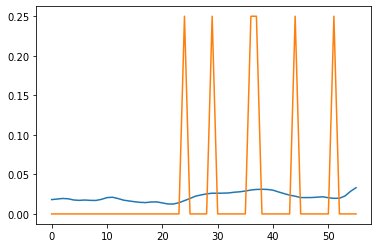

validation 0.0017912698
4_lstm 23 0.006494642


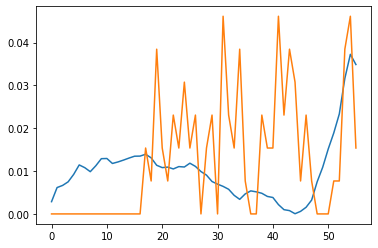

validation 0.001790602
4_lstm 24 0.0062056393


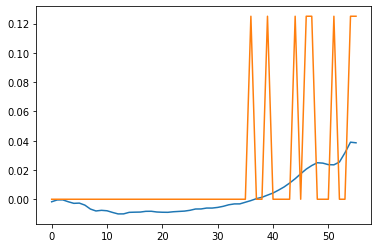

validation 0.0017886143
4_lstm 25 0.0056973333


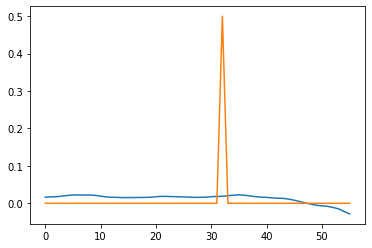

validation 0.0017898205
4_lstm 26 0.00624947


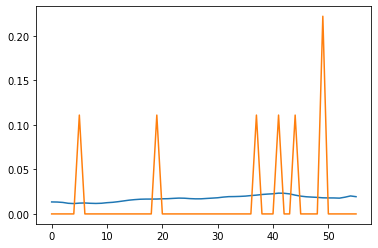

validation 0.0017749809
4_lstm 27 0.0062048347


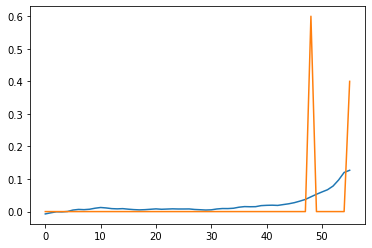

validation 0.0017752551
4_lstm 28 0.005957682


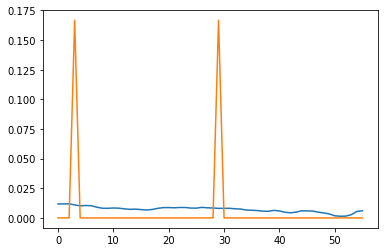

validation 0.0017804261
4_lstm 29 0.0063518346


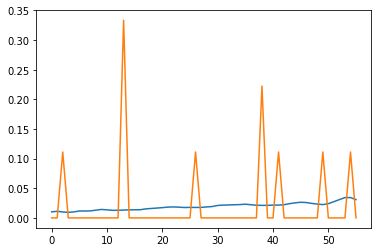

validation 0.0017875402
INFO:tensorflow:Assets written to: m5autoreg/model_4_lstm/assets
df shape 577
starting at 1024
5_lstm 0 0.015814908


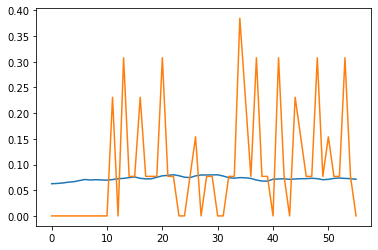

validation 0.02583426
5_lstm 1 0.014852522


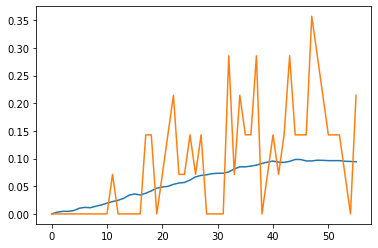

validation 0.024619823
5_lstm 2 0.014694209


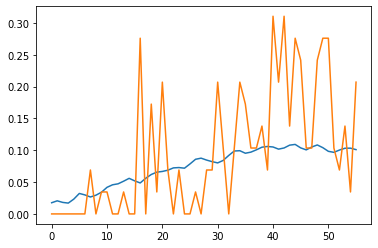

validation 0.023947868
5_lstm 3 0.014028287


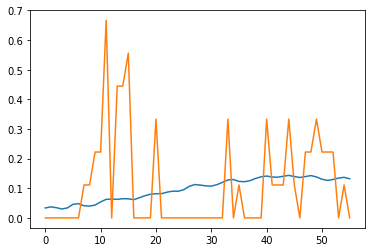

validation 0.023700446
5_lstm 4 0.013779495


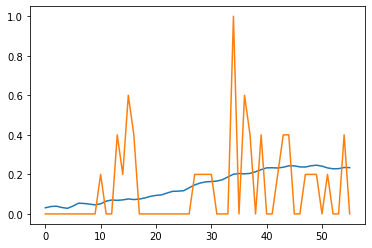

validation 0.023254246
5_lstm 5 0.01377593


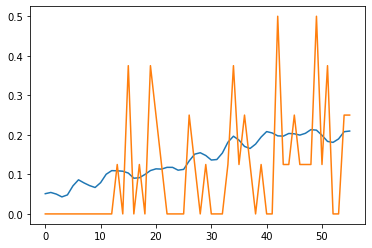

validation 0.022819206
5_lstm 6 0.013908604


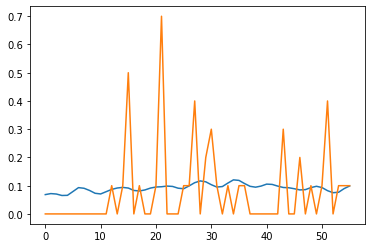

validation 0.022651616
5_lstm 7 0.014137432


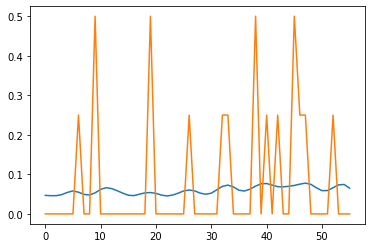

validation 0.022377705
5_lstm 8 0.014100386


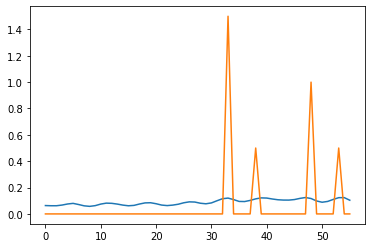

validation 0.022200672
5_lstm 9 0.013212601


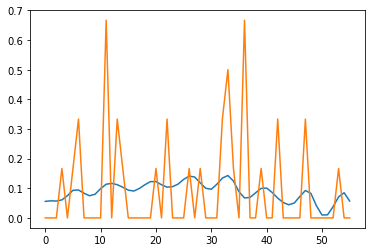

validation 0.021959597
5_lstm 10 0.013857426


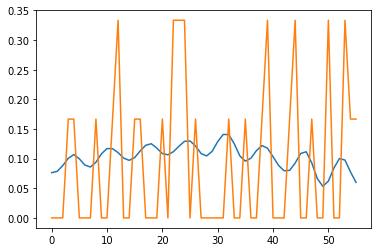

validation 0.021825561
5_lstm 11 0.013728703


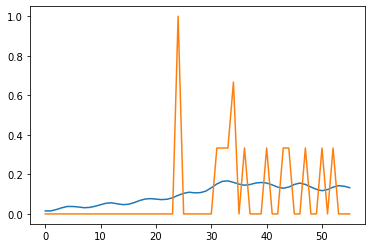

validation 0.021860326
5_lstm 12 0.012715926


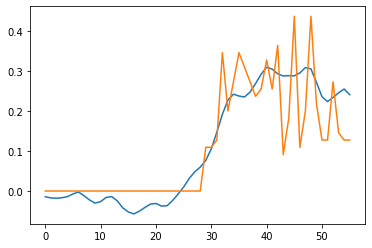

validation 0.021738669
5_lstm 13 0.01321967


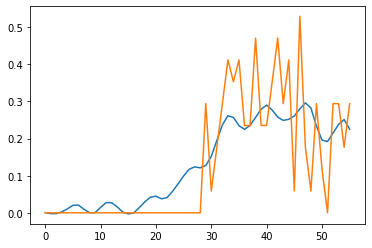

validation 0.021683615
5_lstm 14 0.013933489


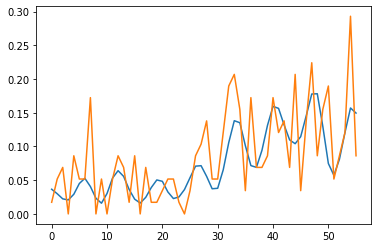

validation 0.021643529
5_lstm 15 0.013051407


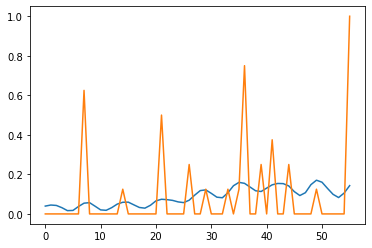

validation 0.021542784
5_lstm 16 0.014619543


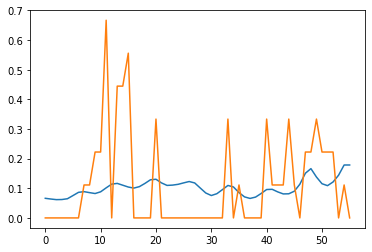

validation 0.021454485
5_lstm 17 0.013080192


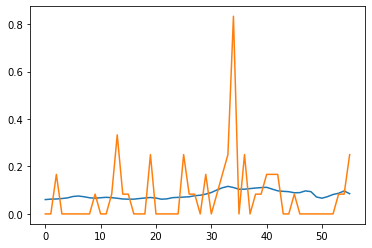

validation 0.021482961
5_lstm 18 0.013680876


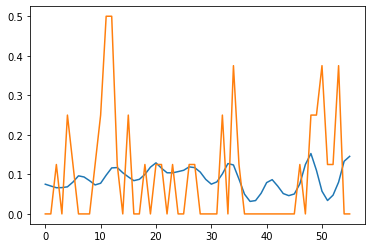

validation 0.02134155
5_lstm 19 0.0140136015


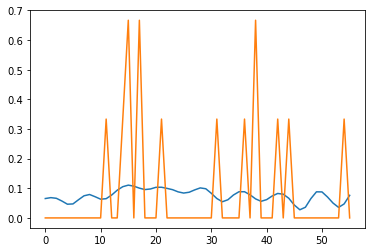

validation 0.021300869
5_lstm 20 0.01284869


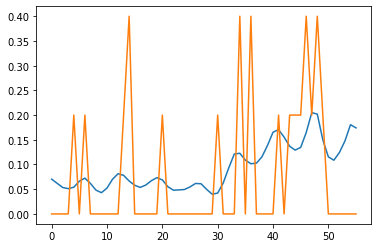

validation 0.02117753
5_lstm 21 0.012563768


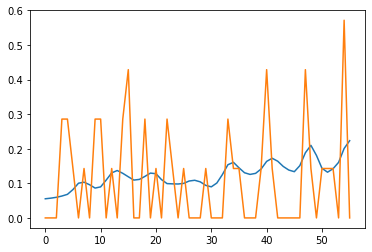

validation 0.021198854
5_lstm 22 0.013623755


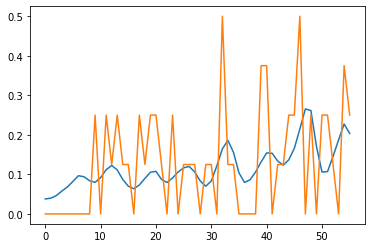

validation 0.021156553
5_lstm 23 0.01315017


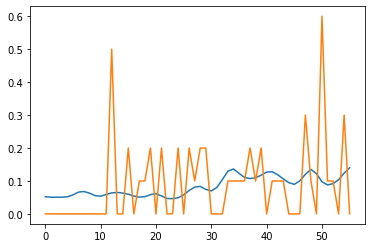

validation 0.021102037
5_lstm 24 0.013416983


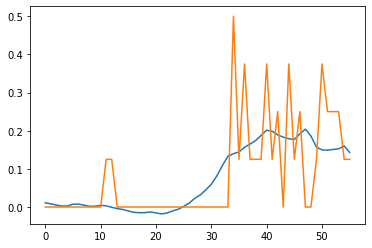

validation 0.02098384
5_lstm 25 0.013327121


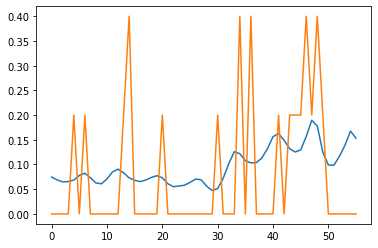

validation 0.0209048
5_lstm 26 0.013367928


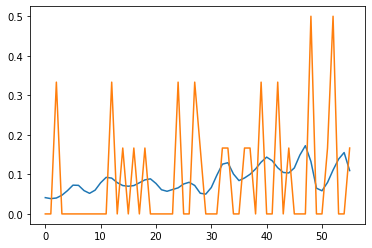

validation 0.020893024
5_lstm 27 0.013072509


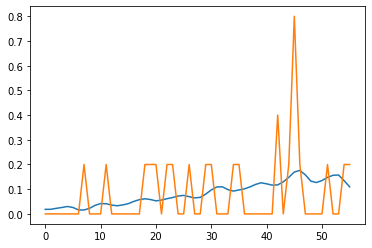

validation 0.02081823
5_lstm 28 0.012814811


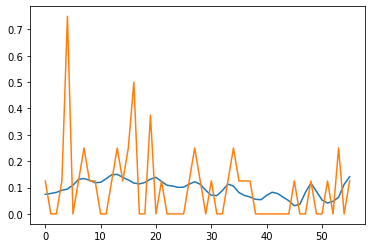

validation 0.020755988
5_lstm 29 0.013483434


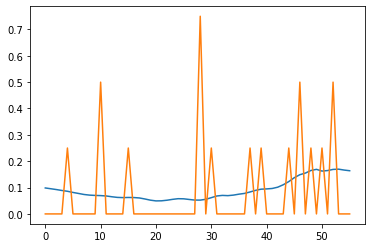

validation 0.020622175
INFO:tensorflow:Assets written to: m5autoreg/model_5_lstm/assets
df shape 48
starting at 1024
6_lstm 0 0.030848324


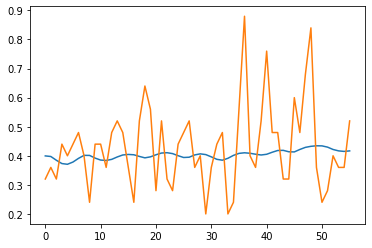

validation 0.04825924
6_lstm 1 0.023656085


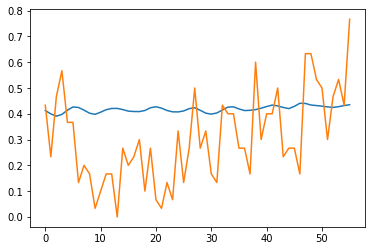

validation 0.04593581
6_lstm 2 0.022207594


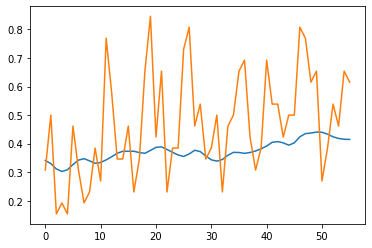

validation 0.04690092
6_lstm 3 0.02434817


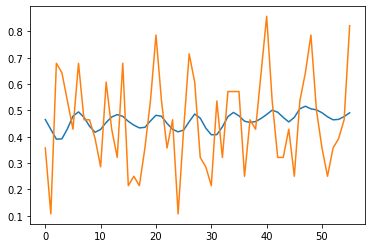

validation 0.042830236
6_lstm 4 0.022865117


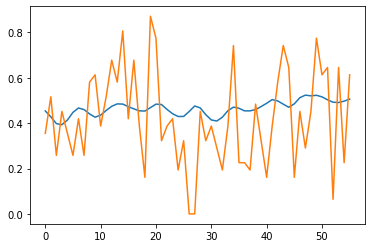

validation 0.042469986
6_lstm 5 0.022315169


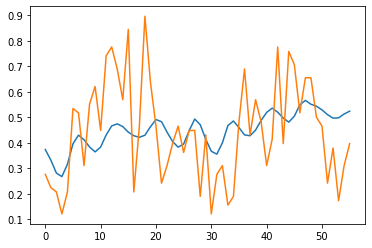

validation 0.040727787
6_lstm 6 0.021147663


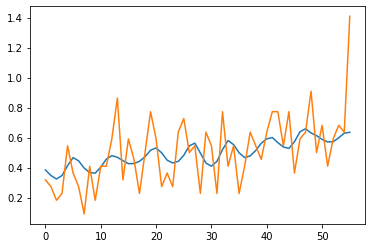

validation 0.03818437
6_lstm 7 0.021515386


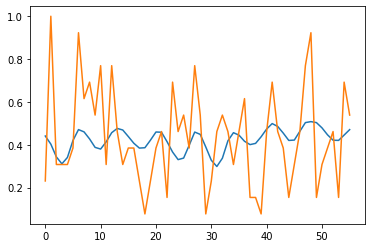

validation 0.03758178
6_lstm 8 0.020734584


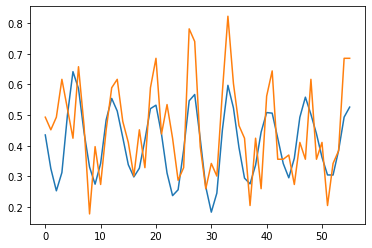

validation 0.03742942
6_lstm 9 0.022829918


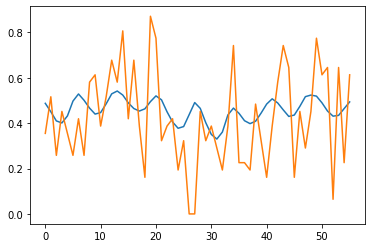

validation 0.03650256
6_lstm 10 0.022083357


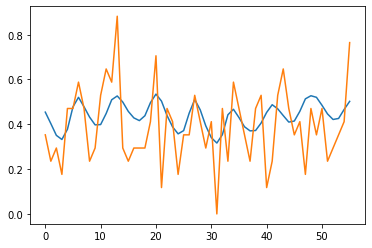

validation 0.036918443
6_lstm 11 0.02114512


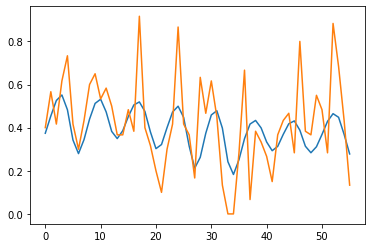

validation 0.03609264
6_lstm 12 0.019700563


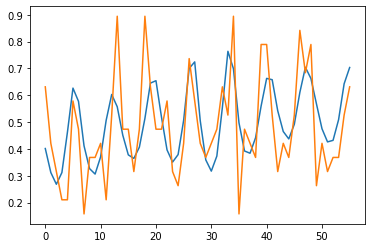

validation 0.036161598
6_lstm 13 0.022528315


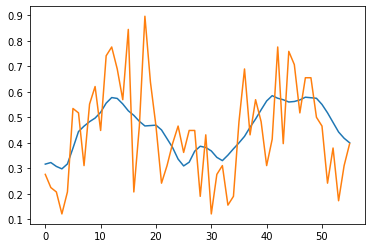

validation 0.035374053
6_lstm 14 0.019049184


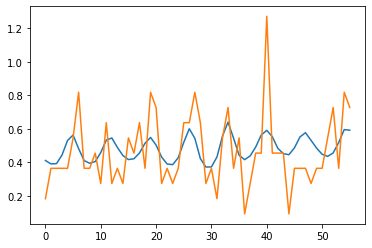

validation 0.034898072
6_lstm 15 0.019320318


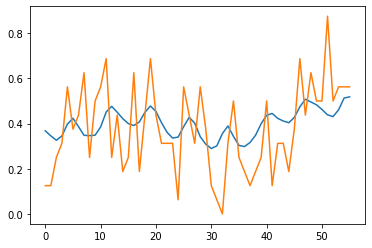

validation 0.03485054
6_lstm 16 0.02198568


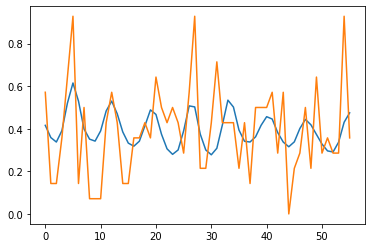

validation 0.033958178
6_lstm 17 0.024640374


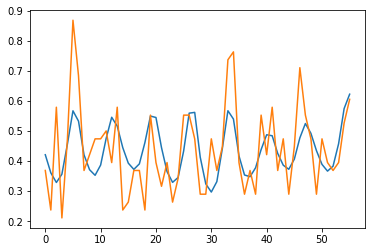

validation 0.033512168
6_lstm 18 0.01776099


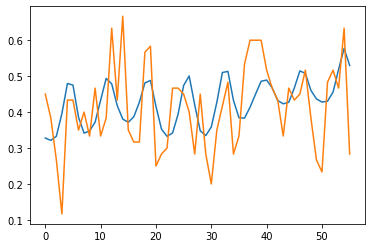

validation 0.033374093
6_lstm 19 0.020872453


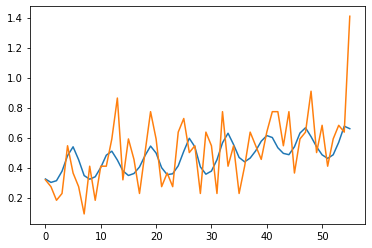

validation 0.033198364
6_lstm 20 0.021353284


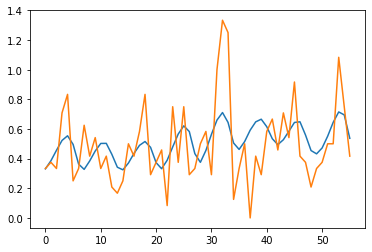

validation 0.03287142
6_lstm 21 0.01867559


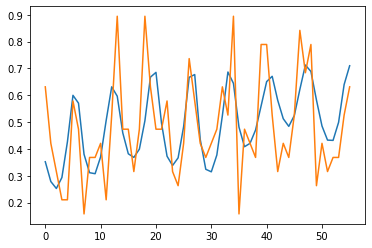

validation 0.032273836
6_lstm 22 0.020396814


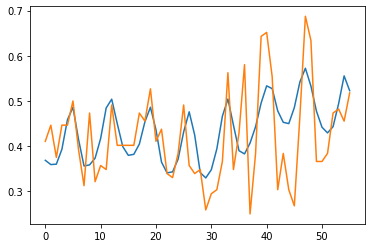

validation 0.03162467
6_lstm 23 0.019934567


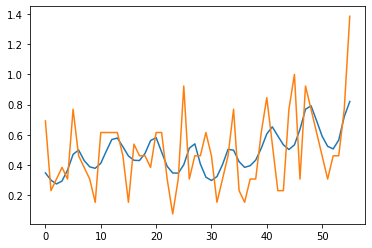

validation 0.031615965
6_lstm 24 0.018636392


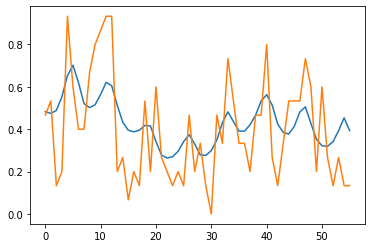

validation 0.031584714
6_lstm 25 0.018958297


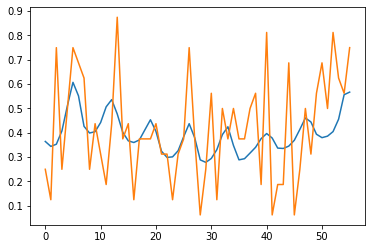

validation 0.03159342
6_lstm 26 0.01939599


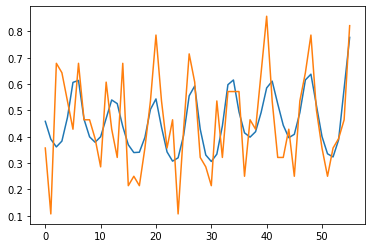

validation 0.031008448
6_lstm 27 0.020539425


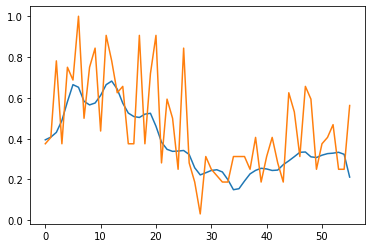

validation 0.030964205
6_lstm 28 0.018884324


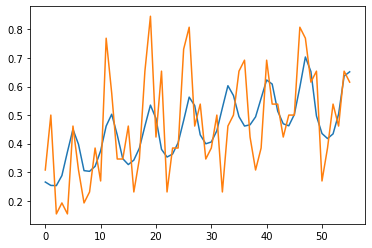

validation 0.03004637
6_lstm 29 0.01931514


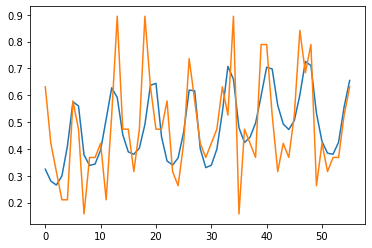

validation 0.029607484
INFO:tensorflow:Assets written to: m5autoreg/model_6_lstm/assets
df shape 593
starting at 1024
7_lstm 0 0.025921315


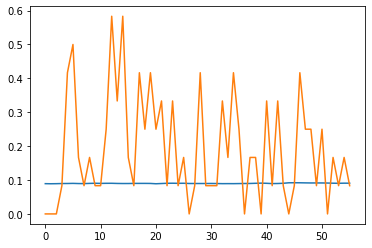

validation 0.03846321
7_lstm 1 0.02318642


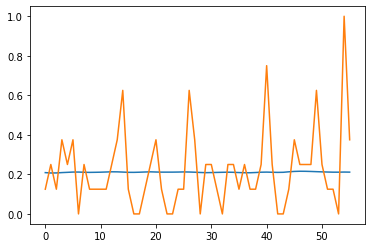

validation 0.03674543
7_lstm 2 0.024766771


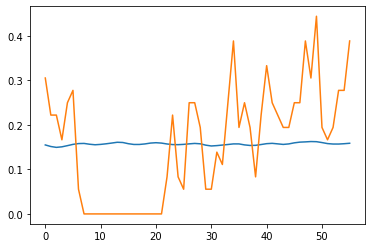

validation 0.036775414
7_lstm 3 0.023262696


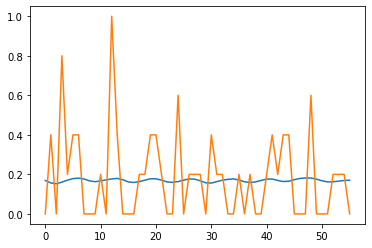

validation 0.03620336
7_lstm 4 0.023383357


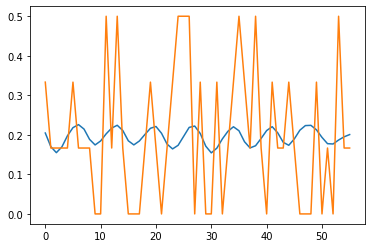

validation 0.034505717
7_lstm 5 0.02149489


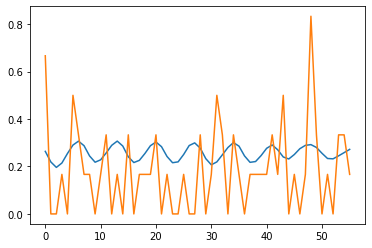

validation 0.034083672
7_lstm 6 0.02167761


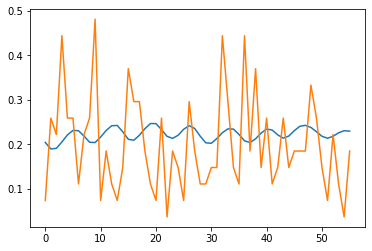

validation 0.03394706
7_lstm 7 0.02384391


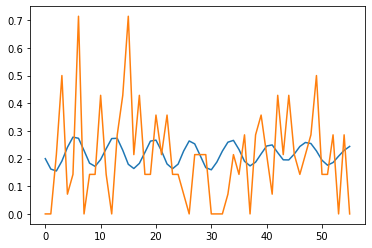

validation 0.033707183
7_lstm 8 0.020351436


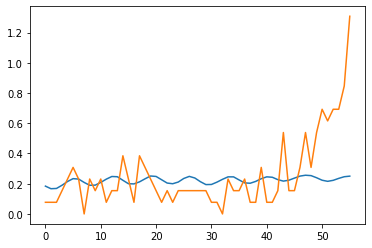

validation 0.033202905
7_lstm 9 0.02238494


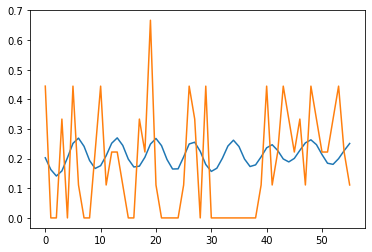

validation 0.032943703
7_lstm 10 0.02184069


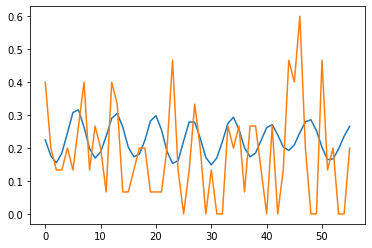

validation 0.032847237
7_lstm 11 0.019945374


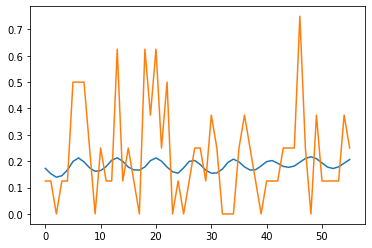

validation 0.032735053
7_lstm 12 0.021147039


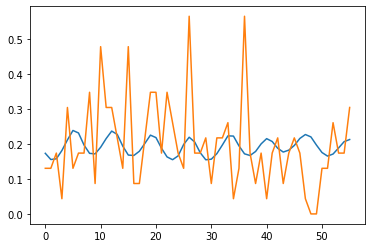

validation 0.032510627
7_lstm 13 0.021346366


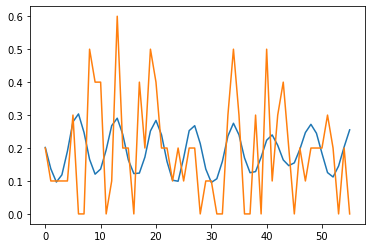

validation 0.032409642
7_lstm 14 0.020901645


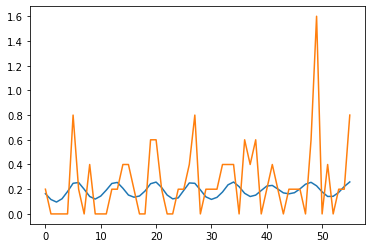

validation 0.03247608
7_lstm 15 0.021254241


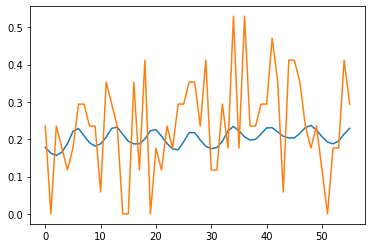

validation 0.03253007
7_lstm 16 0.020874405


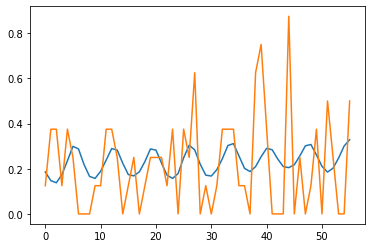

validation 0.032283124
7_lstm 17 0.022139568


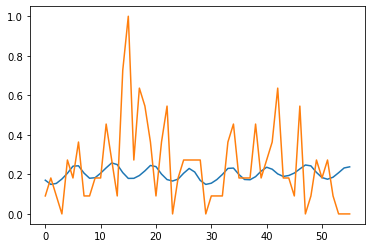

validation 0.032153945
7_lstm 18 0.020927623


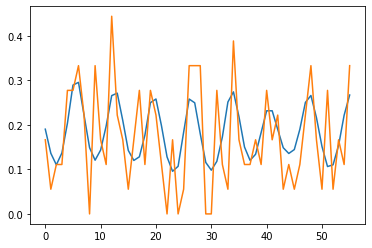

validation 0.032230593
7_lstm 19 0.020573482


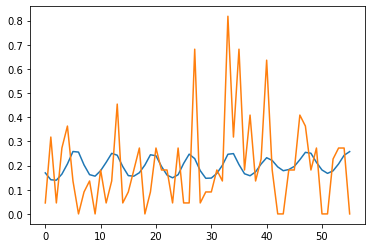

validation 0.032160133
7_lstm 20 0.021687571


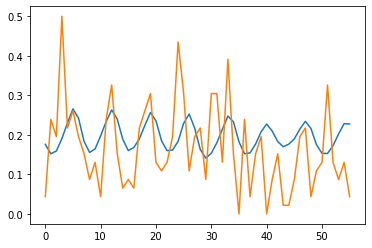

validation 0.032111406
7_lstm 21 0.019712185


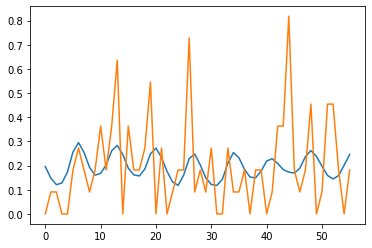

validation 0.032090567
7_lstm 22 0.021179903


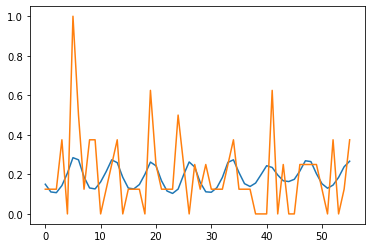

validation 0.03208747
7_lstm 23 0.020066883


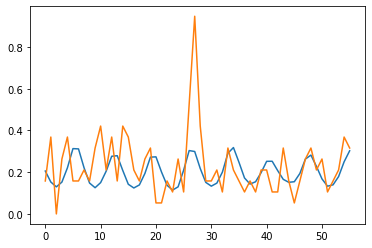

validation 0.031865526
7_lstm 24 0.021118952


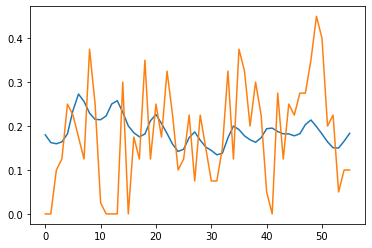

validation 0.03194993
7_lstm 25 0.019320246


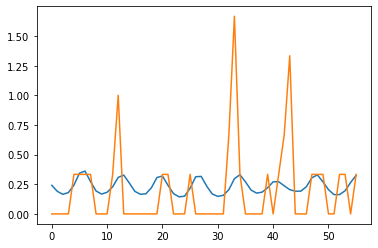

validation 0.031799167
7_lstm 26 0.019676978


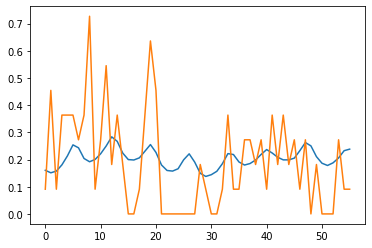

validation 0.031653058
7_lstm 27 0.020389315


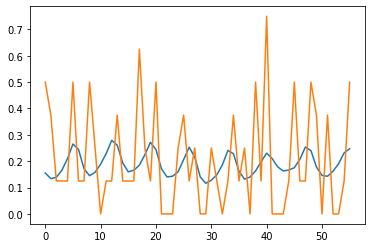

validation 0.031481262
7_lstm 28 0.019867754


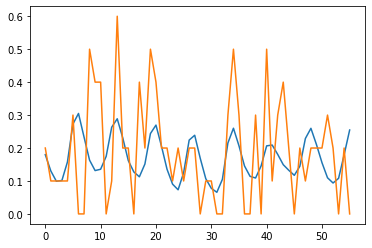

validation 0.031520683
7_lstm 29 0.020070408


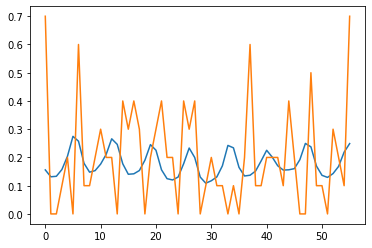

validation 0.031469006
INFO:tensorflow:Assets written to: m5autoreg/model_7_lstm/assets
df shape 1154
starting at 1024
8_lstm 0 0.021227727


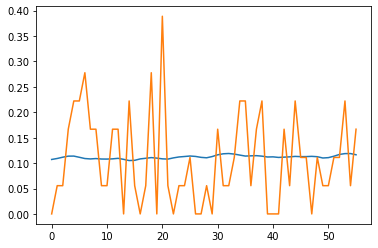

validation 0.021618027
8_lstm 1 0.019559655


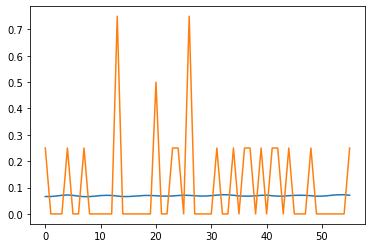

validation 0.021351492
8_lstm 2 0.018667767


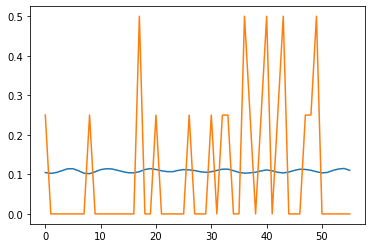

validation 0.02111957
8_lstm 3 0.01808183


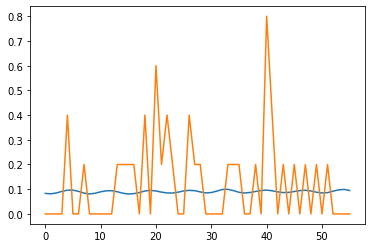

validation 0.021088881
8_lstm 4 0.018002402


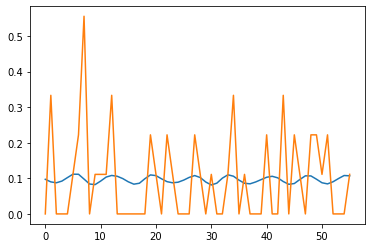

validation 0.020967284
8_lstm 5 0.017398577


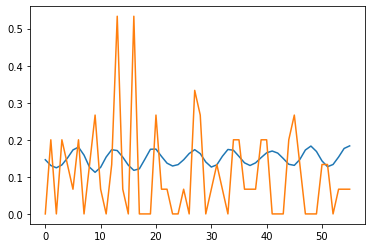

validation 0.020756675
8_lstm 6 0.018528296


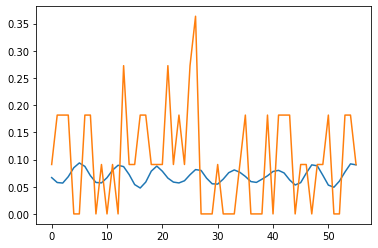

validation 0.020547388
8_lstm 7 0.018076228


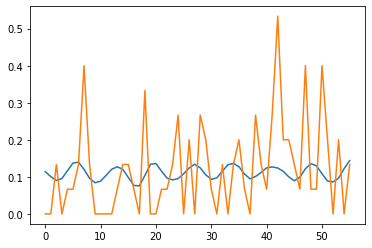

validation 0.02040648
8_lstm 8 0.017044395


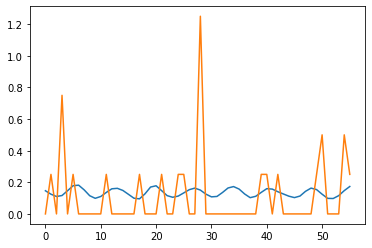

validation 0.020299405
8_lstm 9 0.017483043


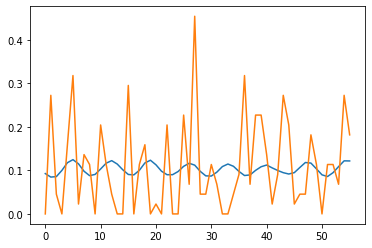

validation 0.020200893
8_lstm 10 0.018015398


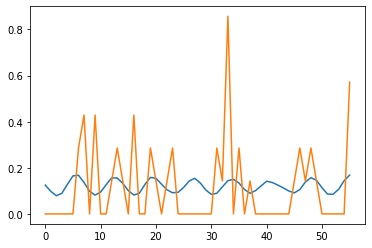

validation 0.020211874
8_lstm 11 0.016894322


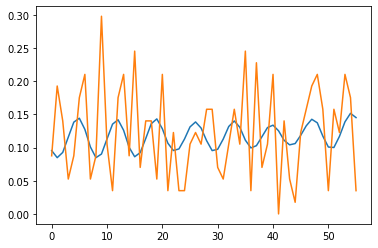

validation 0.020187093
8_lstm 12 0.01727351


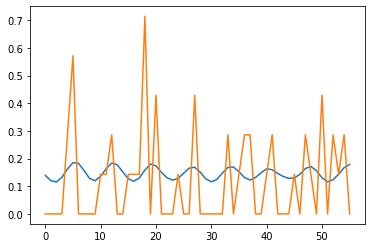

validation 0.020263208
8_lstm 13 0.017170658


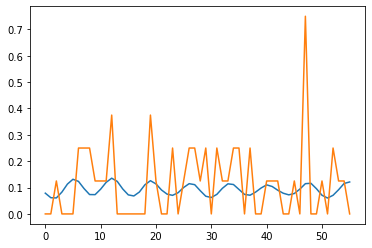

validation 0.02021397
8_lstm 14 0.017362433


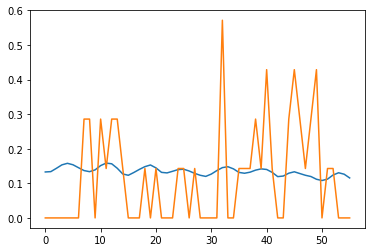

validation 0.020130502
8_lstm 15 0.018936554


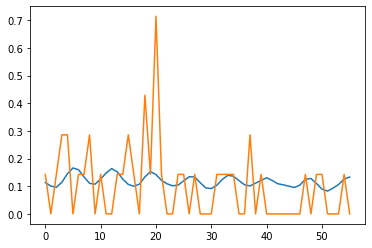

validation 0.020022254
8_lstm 16 0.017618129


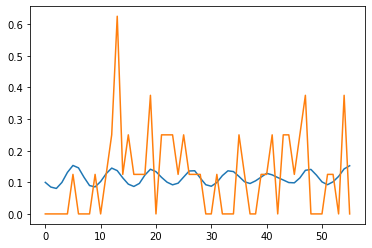

validation 0.019964393
8_lstm 17 0.016974457


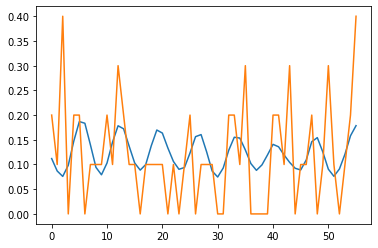

validation 0.019983828
8_lstm 18 0.017444184


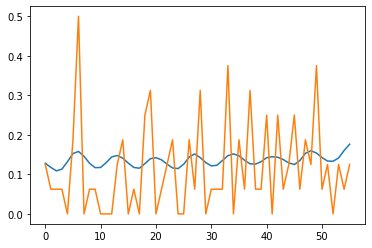

validation 0.02002051
8_lstm 19 0.017051555


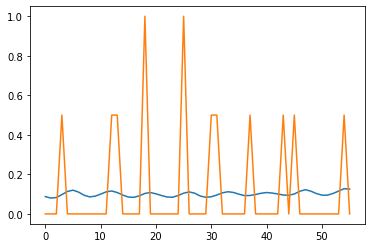

validation 0.02002744
8_lstm 20 0.018336182


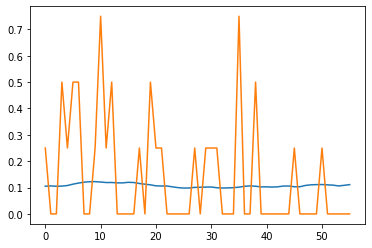

validation 0.020027619
8_lstm 21 0.017455725


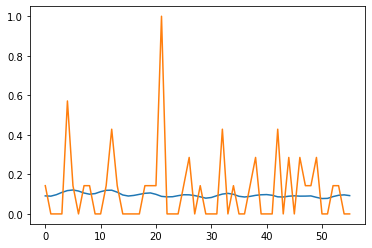

validation 0.019967612
8_lstm 22 0.017659225


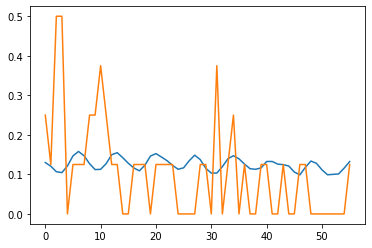

validation 0.019947197
8_lstm 23 0.016837042


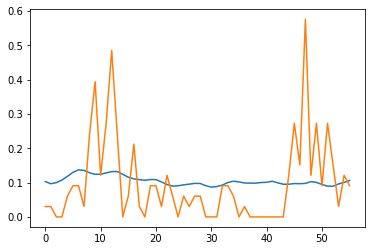

validation 0.019892419
8_lstm 24 0.016788367


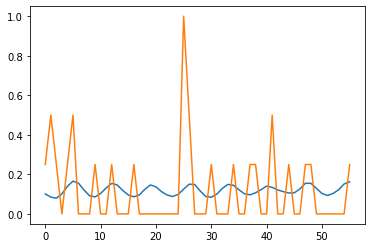

validation 0.019886497
8_lstm 25 0.016643077


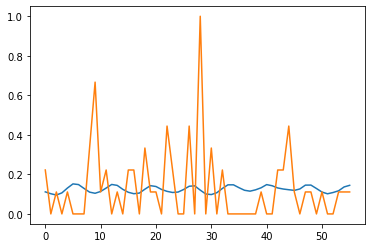

validation 0.019858483
8_lstm 26 0.017017271


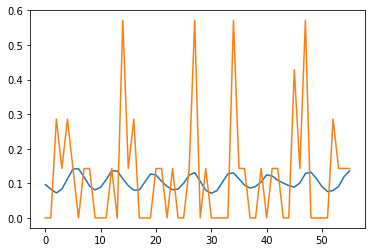

validation 0.019841557
8_lstm 27 0.016447967


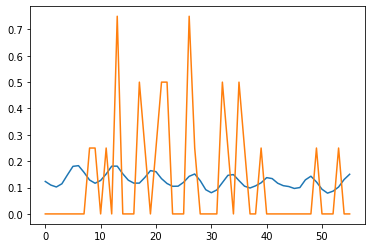

validation 0.019823734
8_lstm 28 0.016893545


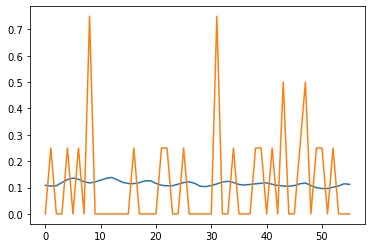

validation 0.019838812
8_lstm 29 0.017546074


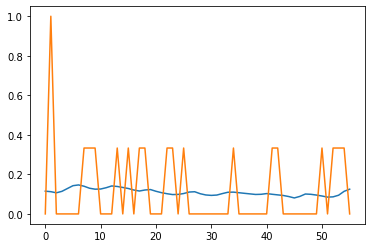

validation 0.019787477
INFO:tensorflow:Assets written to: m5autoreg/model_8_lstm/assets
df shape 1603
starting at 1024
9_lstm 0 0.01642354


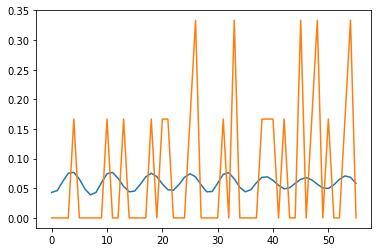

validation 0.018312065
9_lstm 1 0.01658844


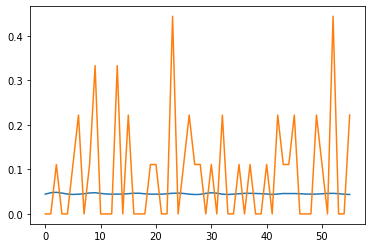

validation 0.018260058
9_lstm 2 0.016006755


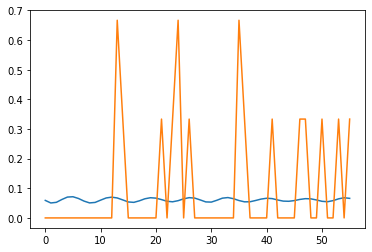

validation 0.018196994
9_lstm 3 0.014903769


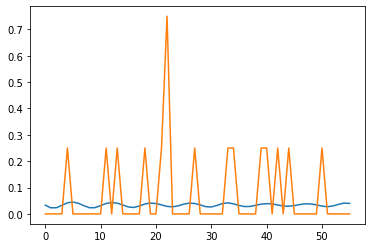

validation 0.01798885
9_lstm 4 0.015471318


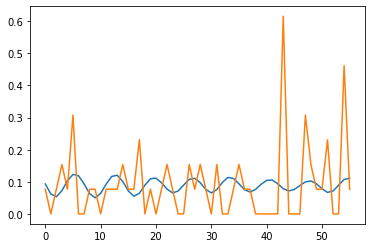

validation 0.01804863
9_lstm 5 0.015555679


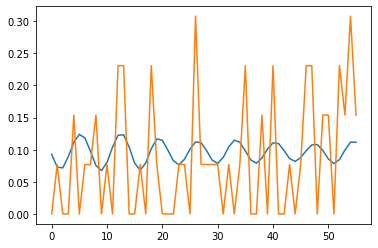

validation 0.018080737
9_lstm 6 0.015328306


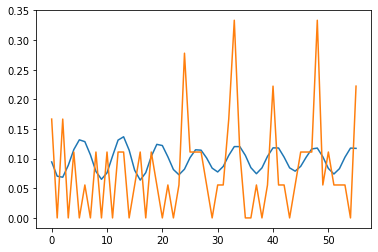

validation 0.018006047
9_lstm 7 0.015740704


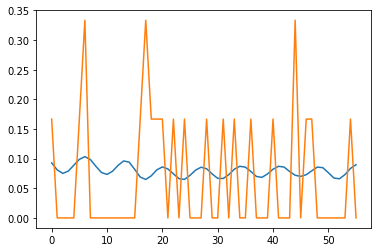

validation 0.01768918
9_lstm 8 0.015356155


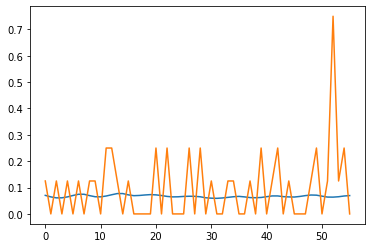

validation 0.017658558
9_lstm 9 0.015309814


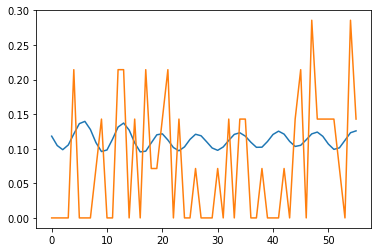

validation 0.017565725
9_lstm 10 0.014954315


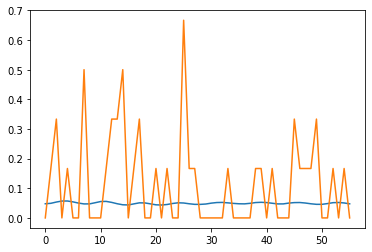

validation 0.017573776
9_lstm 11 0.015180579


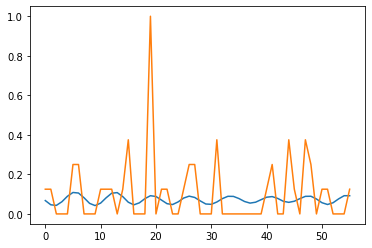

validation 0.017625017
9_lstm 12 0.015064888


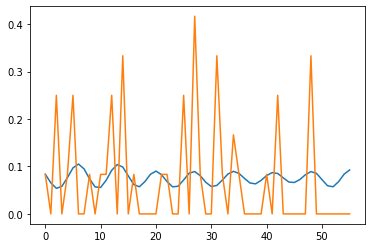

validation 0.017685877
9_lstm 13 0.014937595


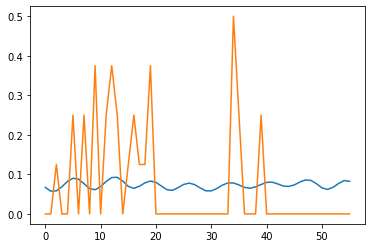

validation 0.01770138
9_lstm 14 0.015005858


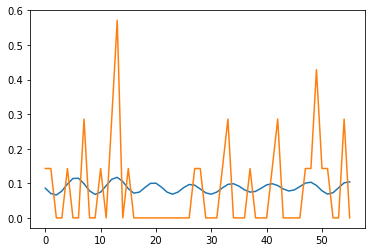

validation 0.017690694
9_lstm 15 0.015183362


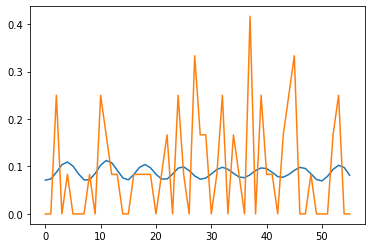

validation 0.017635737
9_lstm 16 0.014591079


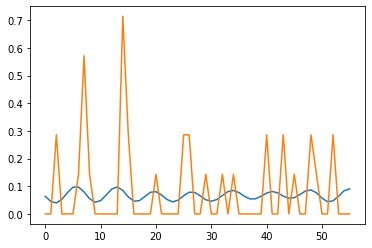

validation 0.017570531
9_lstm 17 0.014837618


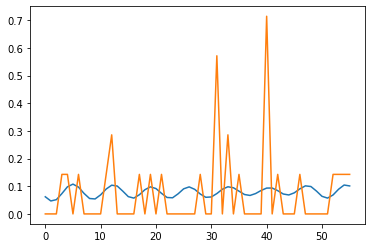

validation 0.017394433
9_lstm 18 0.014752496


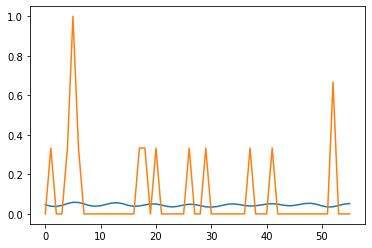

validation 0.017338138
9_lstm 19 0.0149759445


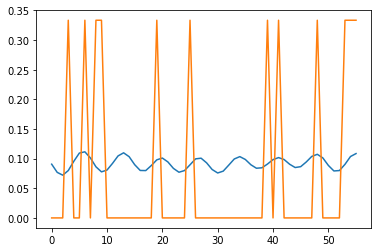

validation 0.01728787
9_lstm 20 0.015070109


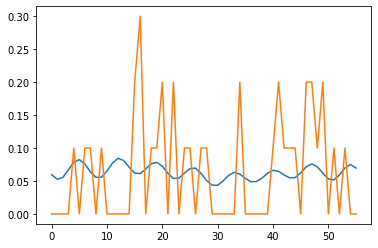

validation 0.017299203
9_lstm 21 0.014865105


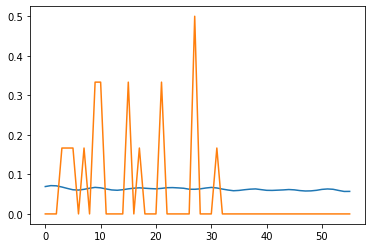

validation 0.017282167
9_lstm 22 0.014786684


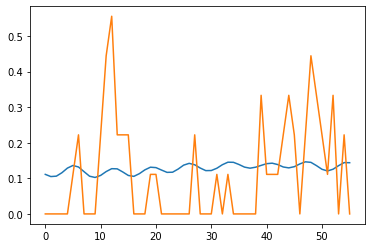

validation 0.017320925
9_lstm 23 0.014439777


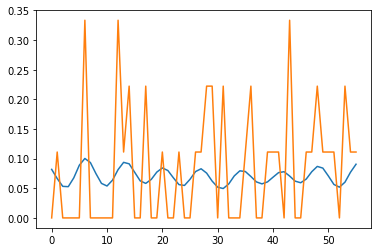

validation 0.017281262
9_lstm 24 0.0149493


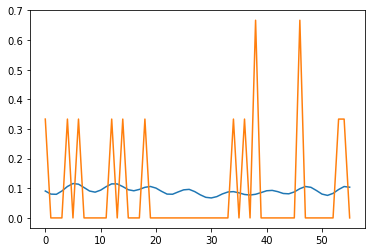

validation 0.017318355
9_lstm 25 0.01469548


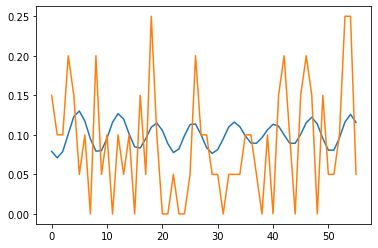

validation 0.017335797
9_lstm 26 0.014394478


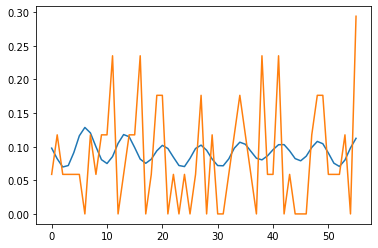

validation 0.017311791
9_lstm 27 0.014102913


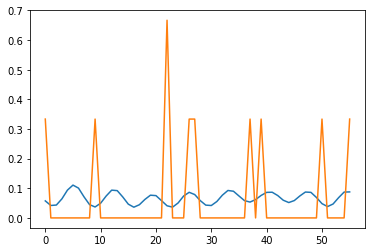

validation 0.017287005
9_lstm 28 0.015507127


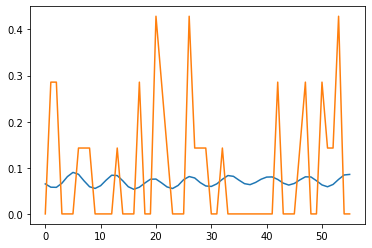

validation 0.017272264
9_lstm 29 0.0147233335


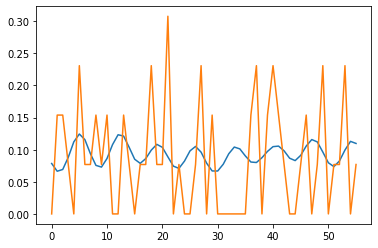

validation 0.017239766
INFO:tensorflow:Assets written to: m5autoreg/model_9_lstm/assets
df shape 1933
starting at 1024
10_lstm 0 0.008301568


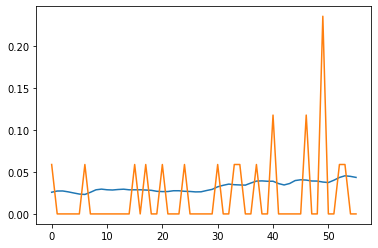

validation 0.0049748276
10_lstm 1 0.008148696


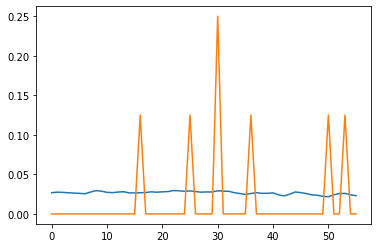

validation 0.0048666983
10_lstm 2 0.007977415


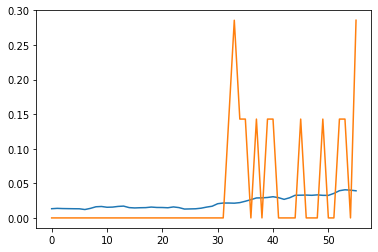

validation 0.004847151
10_lstm 3 0.007629585


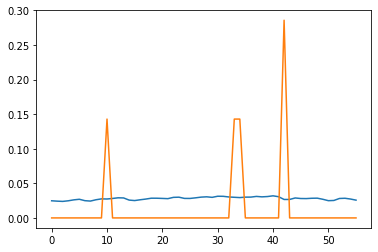

validation 0.0048032636
10_lstm 4 0.0076427655


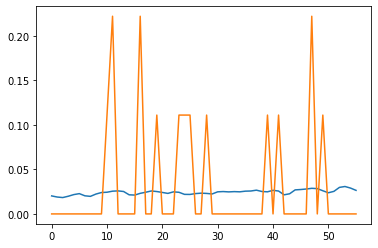

validation 0.0048109996
10_lstm 5 0.0072968984


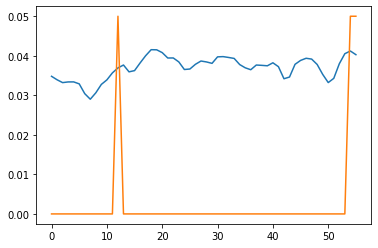

validation 0.0047909445
10_lstm 6 0.007115336


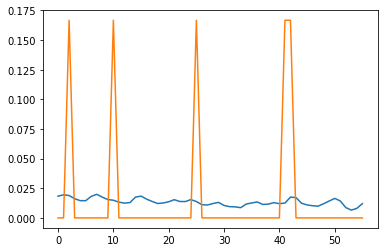

validation 0.004775015
10_lstm 7 0.006856535


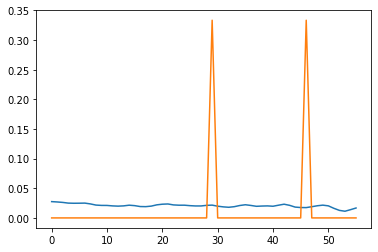

validation 0.0047398848
10_lstm 8 0.007075617


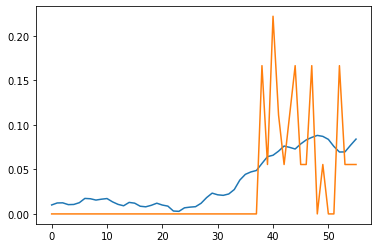

validation 0.0047260416
10_lstm 9 0.007361543


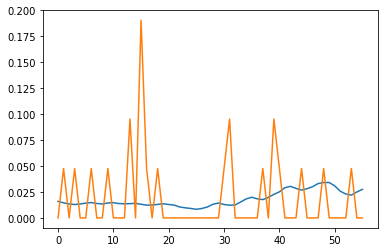

validation 0.0047100964
10_lstm 10 0.0075030094


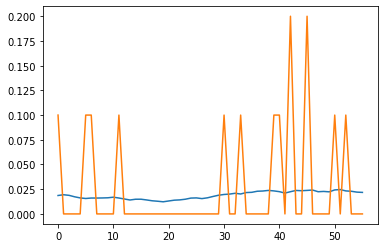

validation 0.00469324
10_lstm 11 0.0074324454


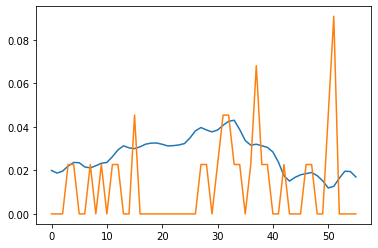

validation 0.0046807625
10_lstm 12 0.006872276


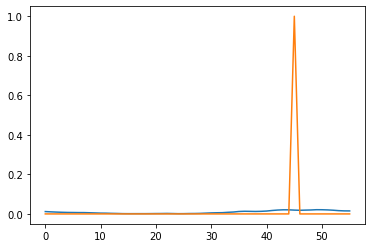

validation 0.0046750777
10_lstm 13 0.007066074


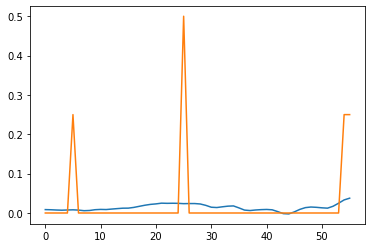

validation 0.0046360246
10_lstm 14 0.0065612774


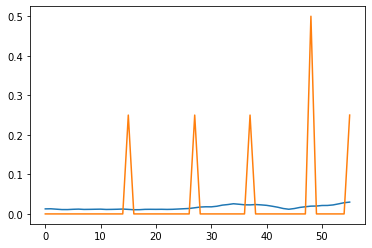

validation 0.004629995
10_lstm 15 0.007428921


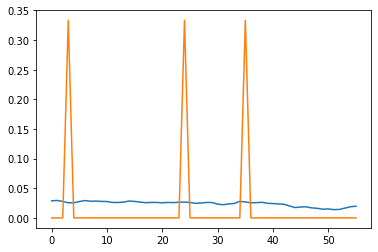

validation 0.0046130186
10_lstm 16 0.0070324508


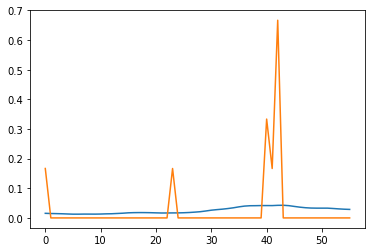

validation 0.004598117
10_lstm 17 0.006935366


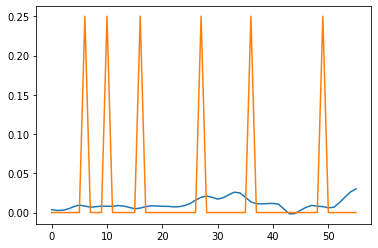

validation 0.0045944015
10_lstm 18 0.007171049


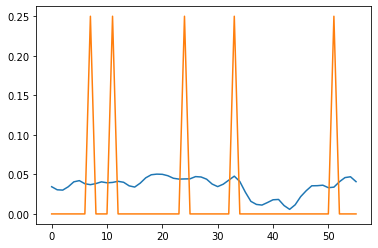

validation 0.0045828335
10_lstm 19 0.0069646733


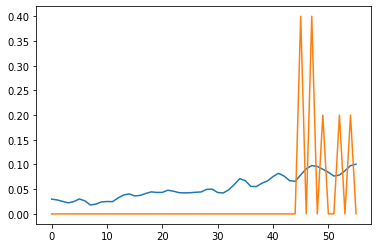

validation 0.0045838985
10_lstm 20 0.0071251127


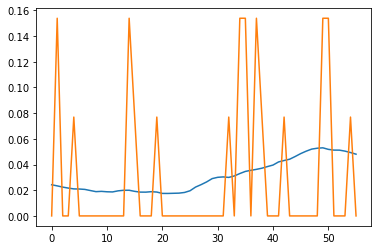

validation 0.0045651617
10_lstm 21 0.007008353


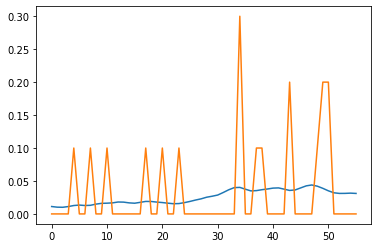

validation 0.0045587085
10_lstm 22 0.0072557405


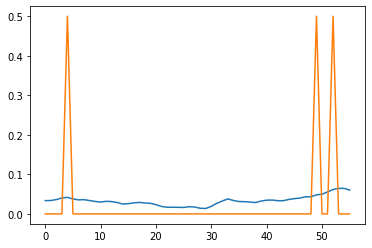

validation 0.0045527713
10_lstm 23 0.007025246


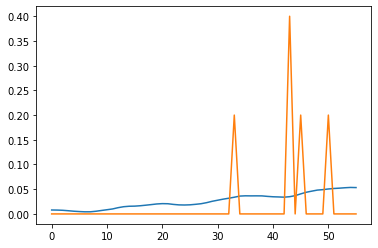

validation 0.0045347298
10_lstm 24 0.0074167643


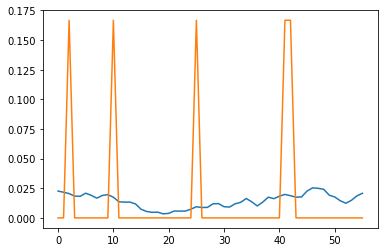

validation 0.004532728
10_lstm 25 0.0068502845


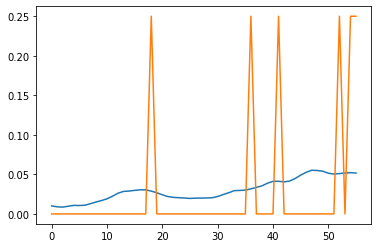

validation 0.0045357295
10_lstm 26 0.006409971


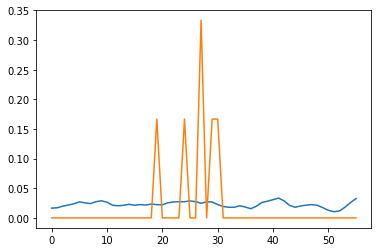

validation 0.004509226
10_lstm 27 0.006932108


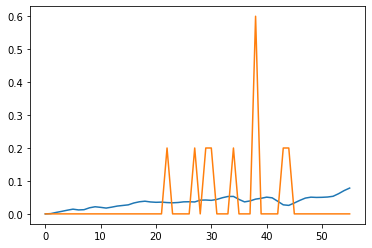

validation 0.0045104423
10_lstm 28 0.007013581


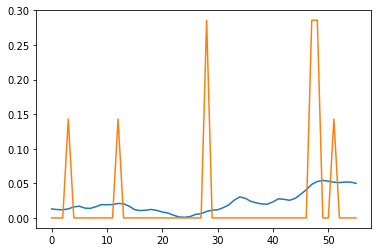

validation 0.0045066522
10_lstm 29 0.006873112


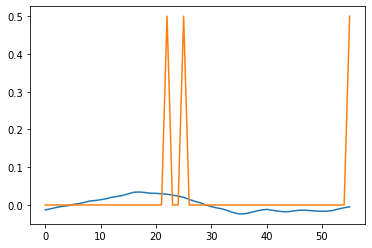

validation 0.004500418
INFO:tensorflow:Assets written to: m5autoreg/model_10_lstm/assets
df shape 174
starting at 1024
11_lstm 0 0.026699625


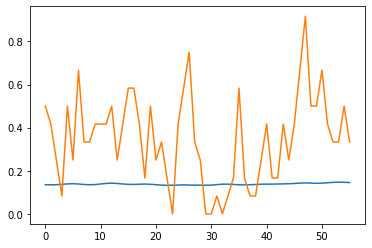

validation 0.048167925
11_lstm 1 0.0231739


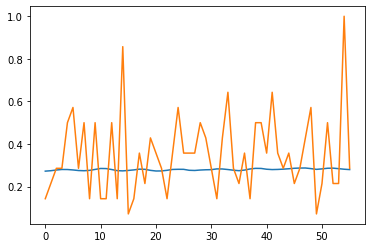

validation 0.04591647
11_lstm 2 0.022657562


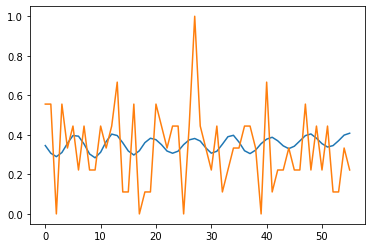

validation 0.04165117
11_lstm 3 0.0252583


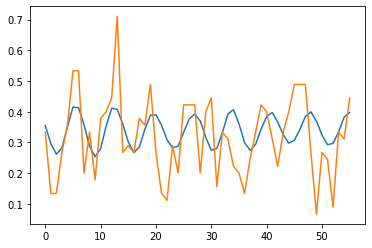

validation 0.039474156
11_lstm 4 0.025846401


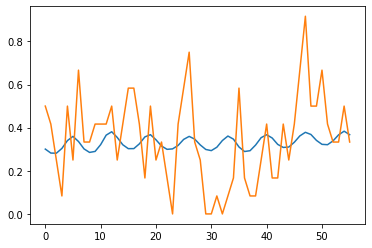

validation 0.039243944
11_lstm 5 0.023843136


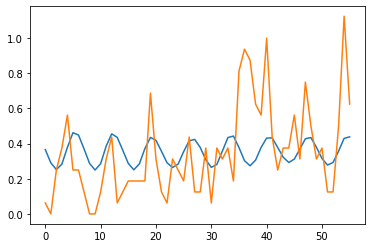

validation 0.038482092
11_lstm 6 0.023285076


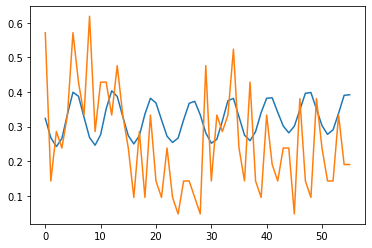

validation 0.037941583
11_lstm 7 0.023951175


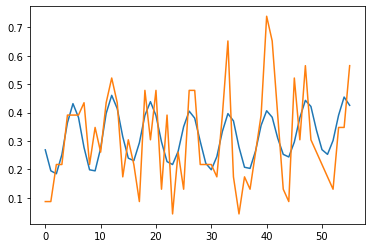

validation 0.037826292
11_lstm 8 0.02299857


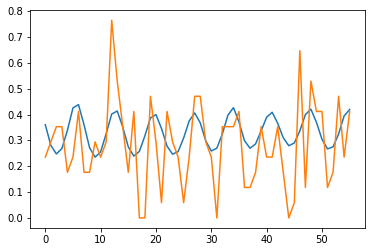

validation 0.039027143
11_lstm 9 0.023234893


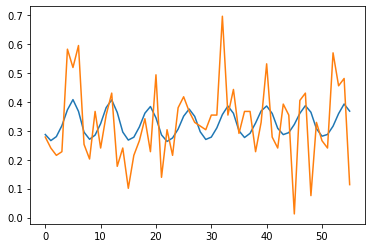

validation 0.037694316
11_lstm 10 0.021548027


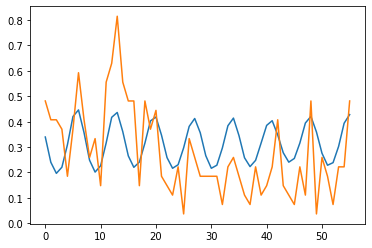

validation 0.03747172
11_lstm 11 0.020807771


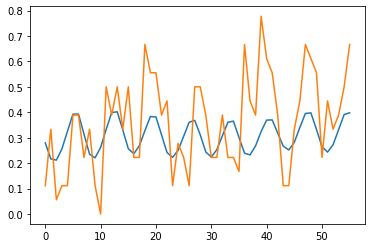

validation 0.03719648
11_lstm 12 0.021099482


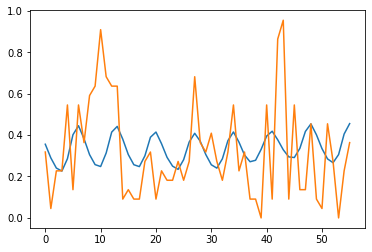

validation 0.036774546
11_lstm 13 0.021244207


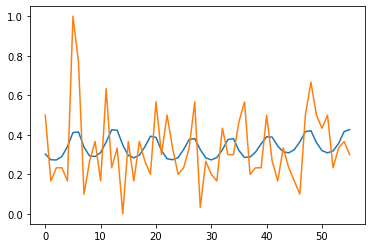

validation 0.03673809
11_lstm 14 0.021364614


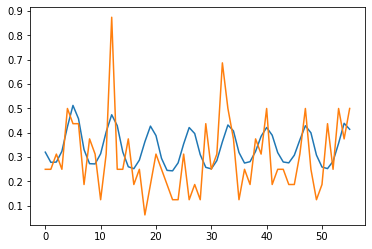

validation 0.03605892
11_lstm 15 0.020993942


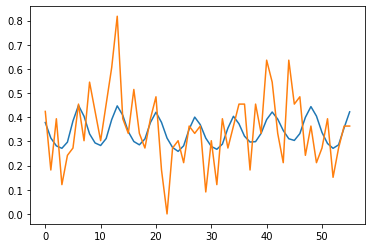

validation 0.035756595
11_lstm 16 0.020805594


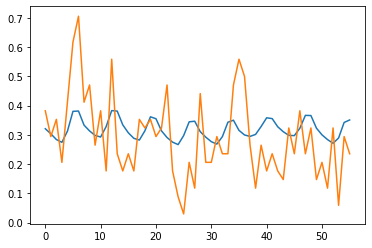

validation 0.0361135
11_lstm 17 0.022674328


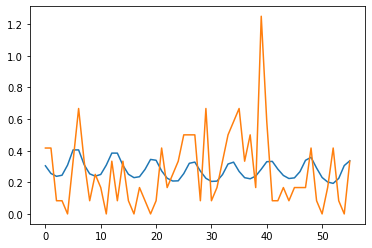

validation 0.03557043
11_lstm 18 0.020991841


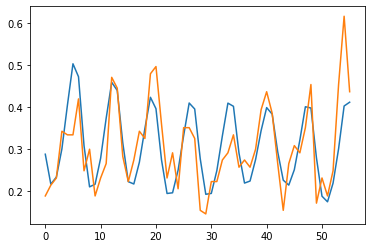

validation 0.035420403
11_lstm 19 0.018924389


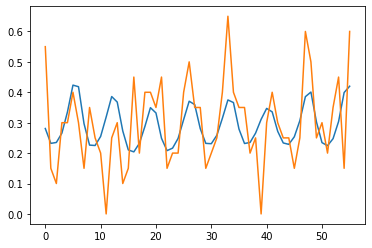

validation 0.035568684
11_lstm 20 0.02059059


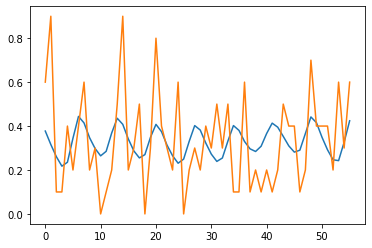

validation 0.03458014
11_lstm 21 0.021551754


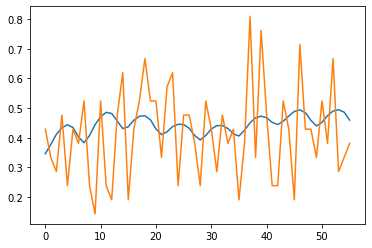

validation 0.03444624
11_lstm 22 0.02008744


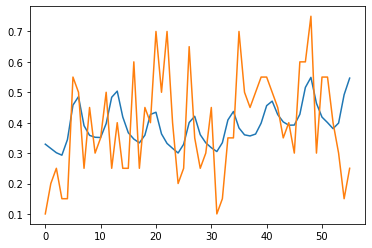

validation 0.03421754
11_lstm 23 0.019640606


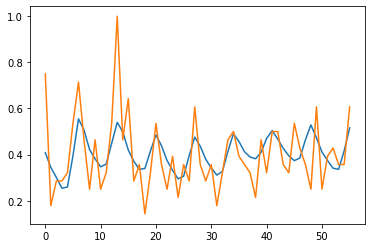

validation 0.03379317
11_lstm 24 0.020717619


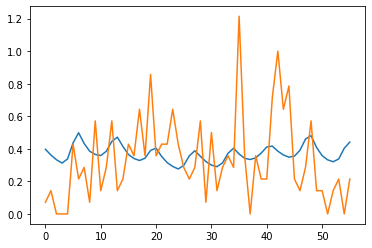

validation 0.033690535
11_lstm 25 0.021424882


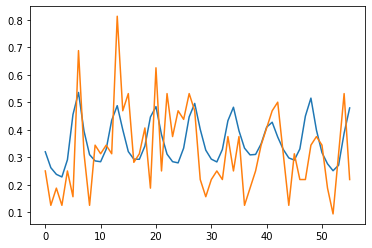

validation 0.03321526
11_lstm 26 0.02117237


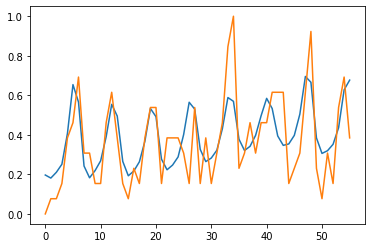

validation 0.032536022
11_lstm 27 0.018491926


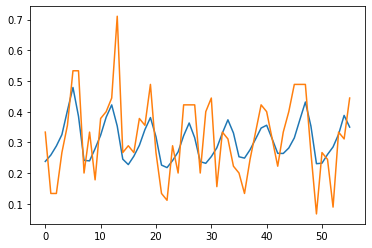

validation 0.03247917
11_lstm 28 0.020953555


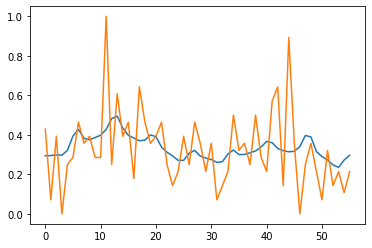

validation 0.03246778
11_lstm 29 0.019587308


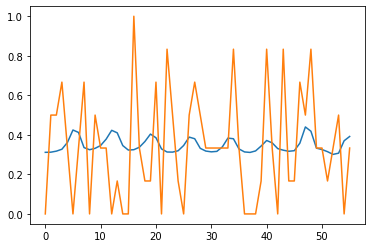

validation 0.032102652
INFO:tensorflow:Assets written to: m5autoreg/model_11_lstm/assets
df shape 96
starting at 1024
12_lstm 0 0.027968196


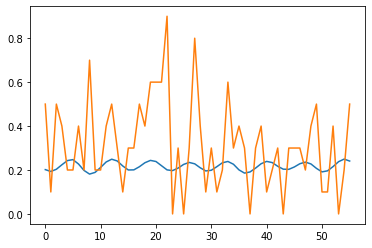

validation 0.054144528
12_lstm 1 0.023336748


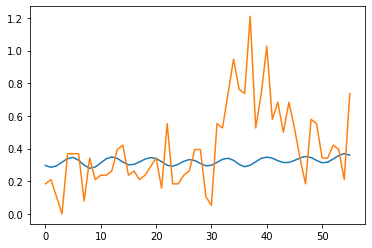

validation 0.046308573
12_lstm 2 0.024443379


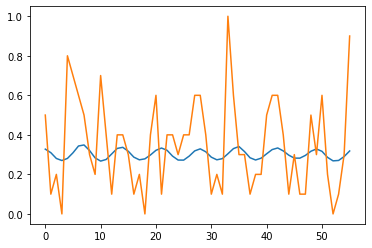

validation 0.039184105
12_lstm 3 0.020132774


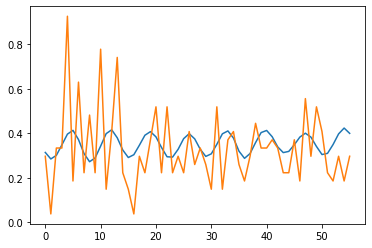

validation 0.0383677
12_lstm 4 0.020871863


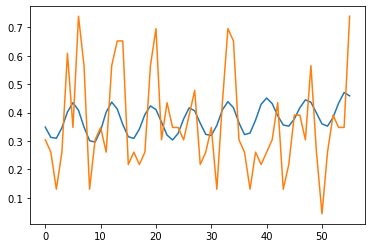

validation 0.03833474
12_lstm 5 0.02320196


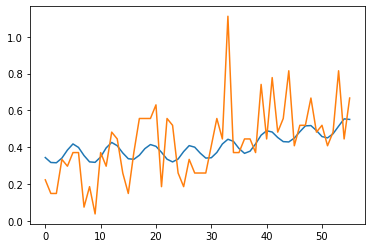

validation 0.036451228
12_lstm 6 0.021547591


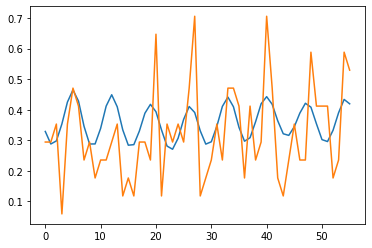

validation 0.035775747
12_lstm 7 0.022026917


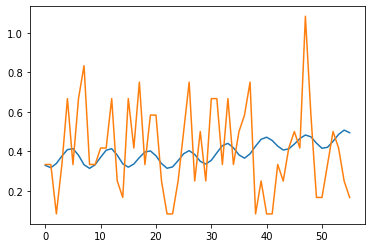

validation 0.03516904
12_lstm 8 0.020039272


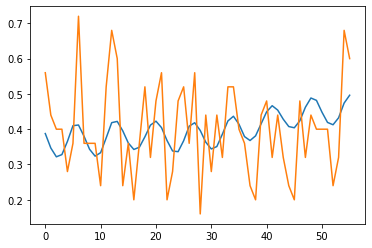

validation 0.034484748
12_lstm 9 0.021734089


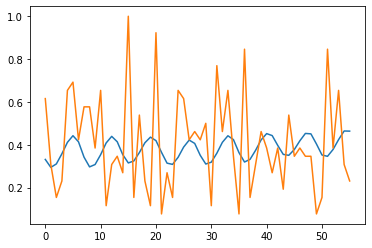

validation 0.03385431
12_lstm 10 0.02083546


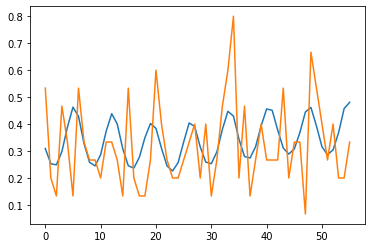

validation 0.033064246
12_lstm 11 0.020932468


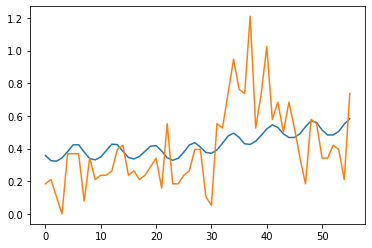

validation 0.03299853
12_lstm 12 0.019135425


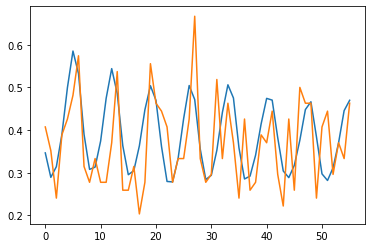

validation 0.032584123
12_lstm 13 0.02107983


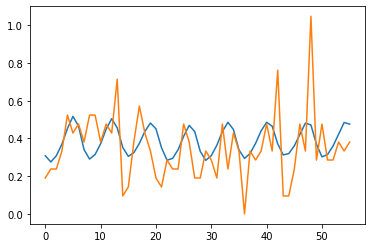

validation 0.032184053
12_lstm 14 0.020059163


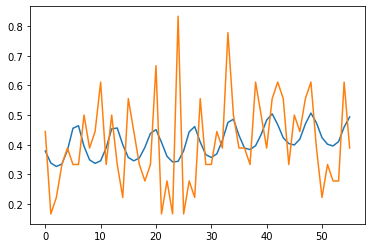

validation 0.032634962
12_lstm 15 0.0202686


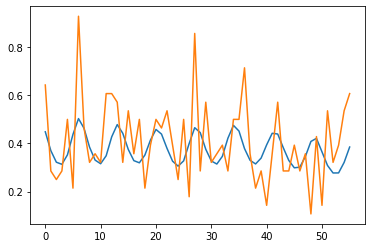

validation 0.03235674
12_lstm 16 0.018042838


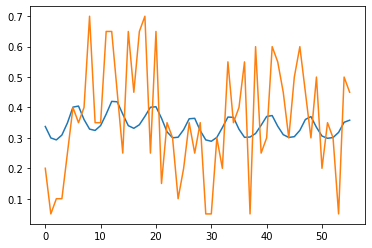

validation 0.032517944
12_lstm 17 0.020835029


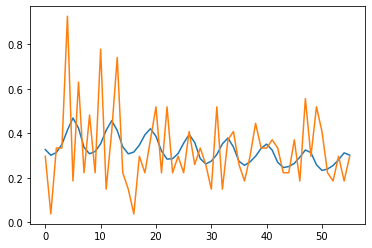

validation 0.032065365
12_lstm 18 0.018873034


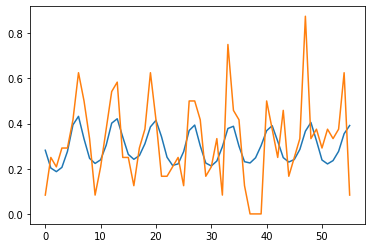

validation 0.032197583
12_lstm 19 0.01962525


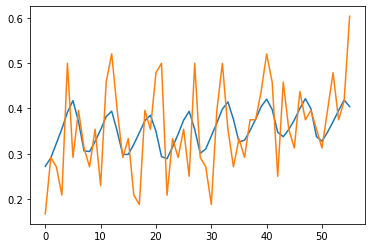

validation 0.03162716
12_lstm 20 0.019084034


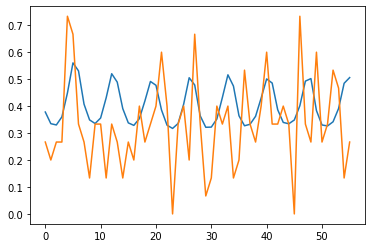

validation 0.03164009
12_lstm 21 0.019514257


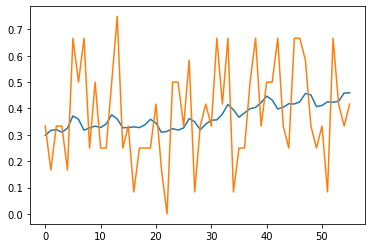

validation 0.032396574
12_lstm 22 0.016546352


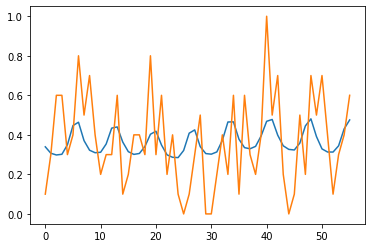

validation 0.031019343
12_lstm 23 0.018281708


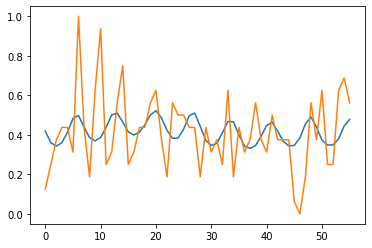

validation 0.031268273
12_lstm 24 0.020873606


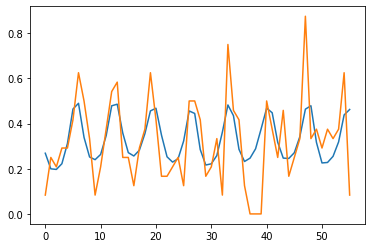

validation 0.030804876
12_lstm 25 0.020384086


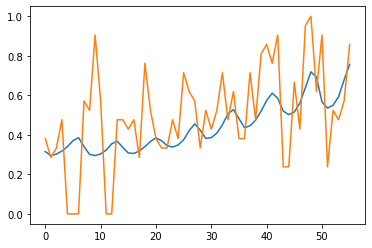

validation 0.030673757
12_lstm 26 0.019644408


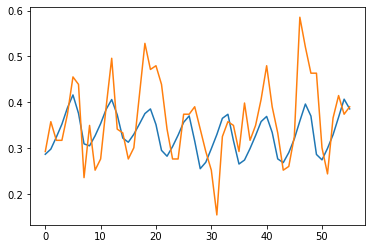

validation 0.030665236
12_lstm 27 0.019086394


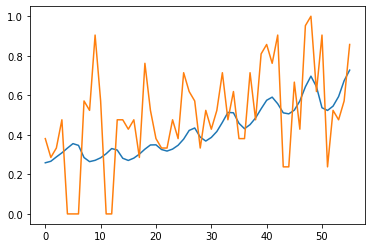

validation 0.030475719
12_lstm 28 0.017448671


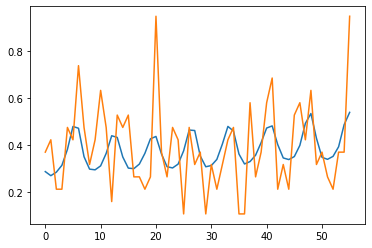

validation 0.03036787
12_lstm 29 0.0195956


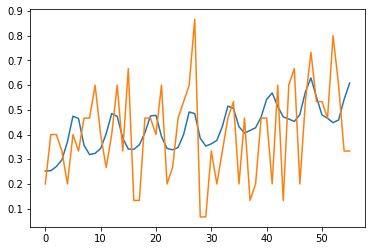

validation 0.030300599
INFO:tensorflow:Assets written to: m5autoreg/model_12_lstm/assets
df shape 2247
starting at 1024
13_lstm 0 0.012555629


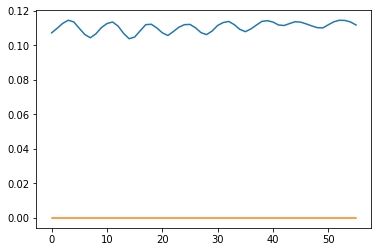

validation 0.012553672
13_lstm 1 0.012034599


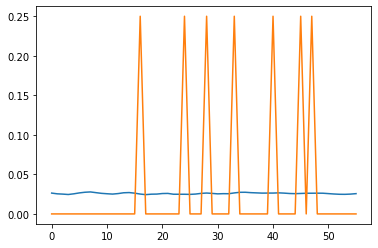

validation 0.012313879
13_lstm 2 0.011864171


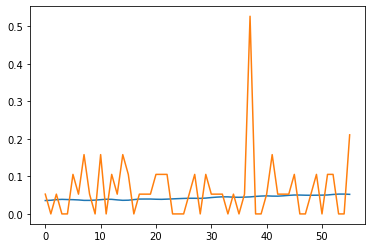

validation 0.012296496
13_lstm 3 0.011284442


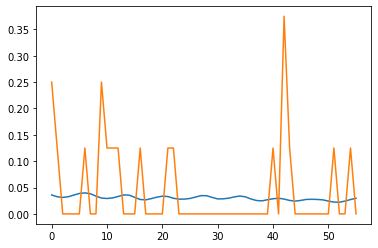

validation 0.012238584
13_lstm 4 0.011742273


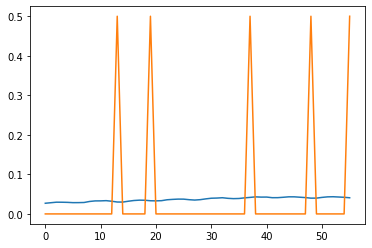

validation 0.012217839
13_lstm 5 0.0114781875


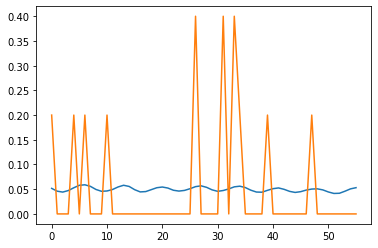

validation 0.012130076
13_lstm 6 0.011313719


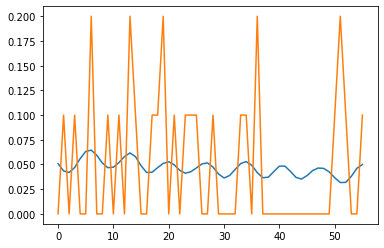

validation 0.012085655
13_lstm 7 0.011011052


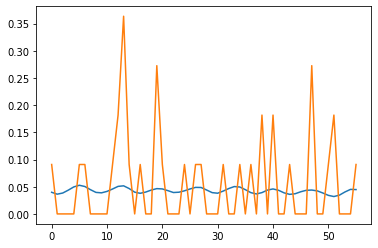

validation 0.012090577
13_lstm 8 0.011153566


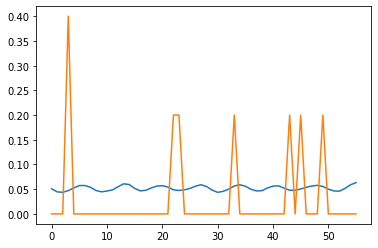

validation 0.012070748
13_lstm 9 0.011089352


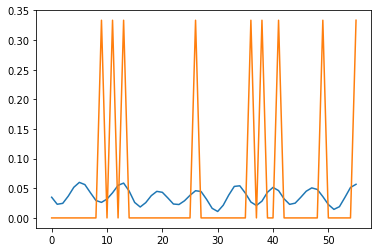

validation 0.011950269
13_lstm 10 0.011195726


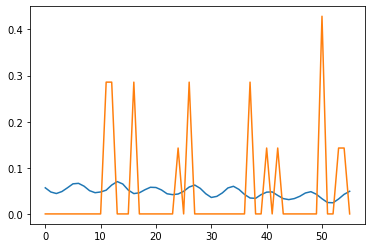

validation 0.011841828
13_lstm 11 0.011329943


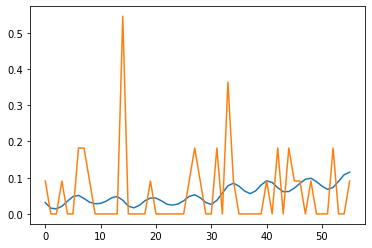

validation 0.011833482
13_lstm 12 0.011020498


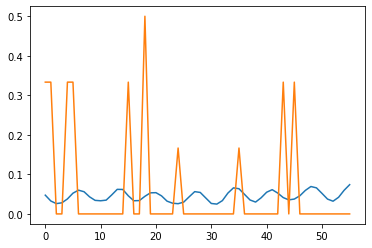

validation 0.011869557
13_lstm 13 0.011024883


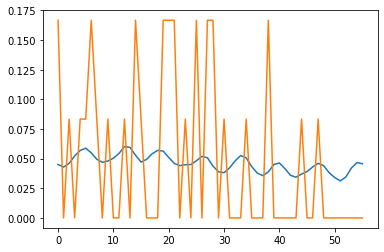

validation 0.0118098585
13_lstm 14 0.011608425


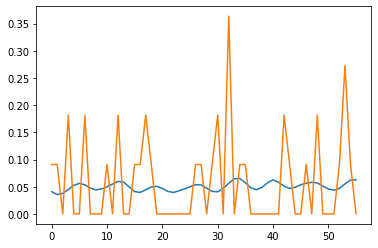

validation 0.011770757
13_lstm 15 0.011136782


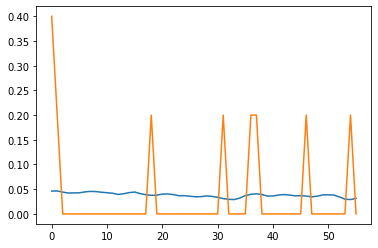

validation 0.011727847
13_lstm 16 0.010897909


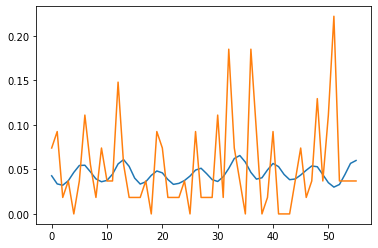

validation 0.011652866
13_lstm 17 0.0109552005


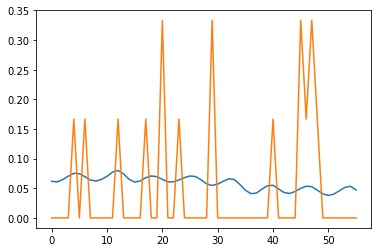

validation 0.011655502
13_lstm 18 0.010762485


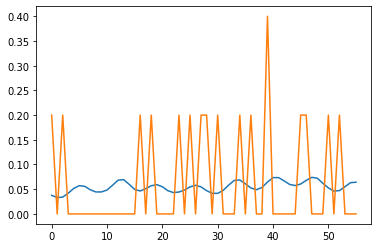

validation 0.011620544
13_lstm 19 0.010613862


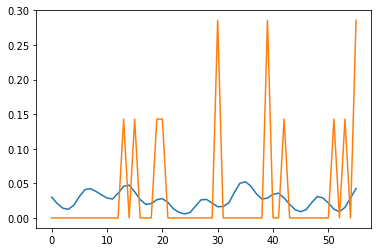

validation 0.01164255
13_lstm 20 0.010782181


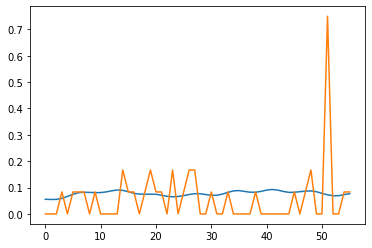

validation 0.011589807
13_lstm 21 0.011022228


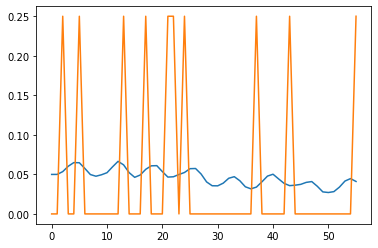

validation 0.011557541
13_lstm 22 0.010999235


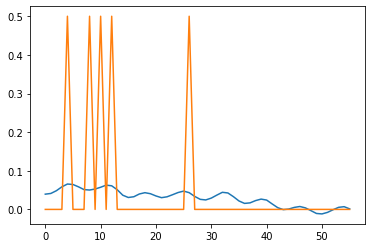

validation 0.011514215
13_lstm 23 0.011356905


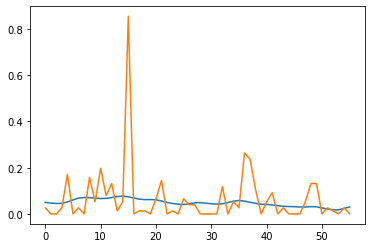

validation 0.0115299355
13_lstm 24 0.010286458


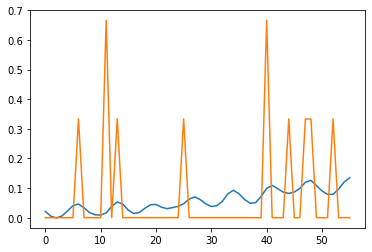

validation 0.011484147
13_lstm 25 0.010676066


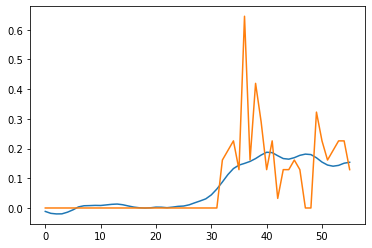

validation 0.011453918
13_lstm 26 0.0106788045


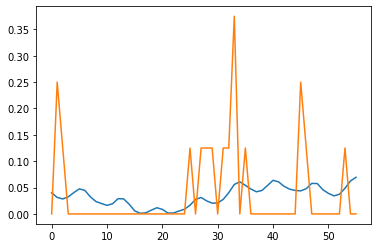

validation 0.011431853
13_lstm 27 0.011227155


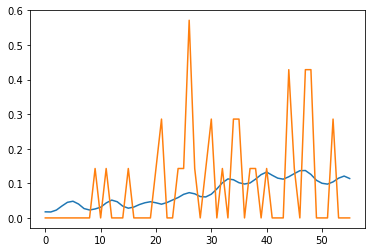

validation 0.011420694
13_lstm 28 0.0113453455


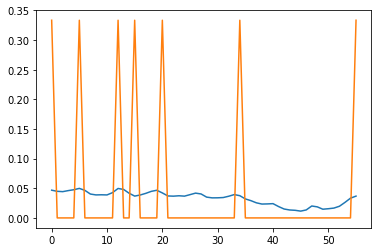

validation 0.011402049
13_lstm 29 0.010988328


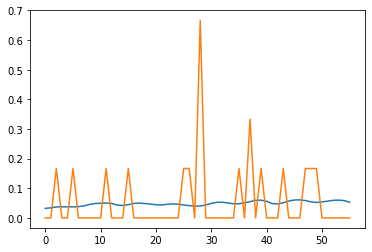

validation 0.011397277
INFO:tensorflow:Assets written to: m5autoreg/model_13_lstm/assets
df shape 431
starting at 1024
14_lstm 0 0.020785984


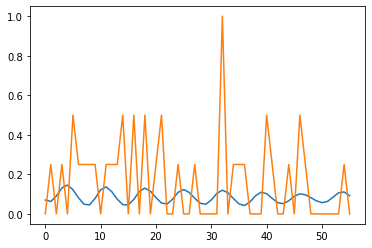

validation 0.043972492
14_lstm 1 0.017721761


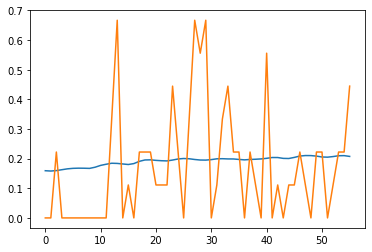

validation 0.037652735
14_lstm 2 0.019563384


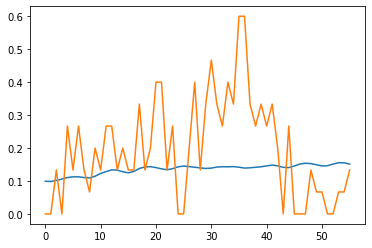

validation 0.035063785
14_lstm 3 0.01975029


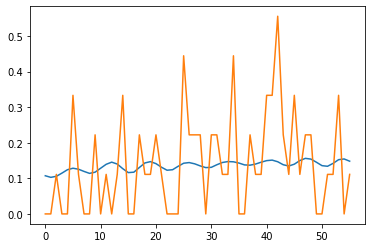

validation 0.0341314
14_lstm 4 0.017191635


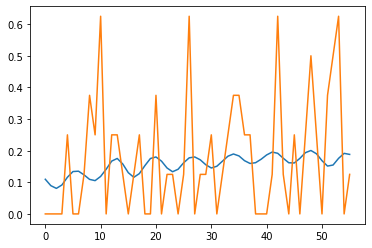

validation 0.033498824
14_lstm 5 0.017538015


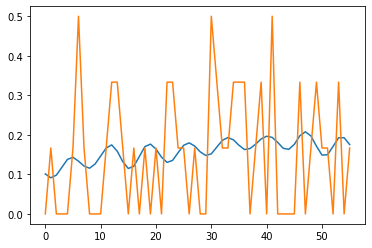

validation 0.032879513
14_lstm 6 0.018578071


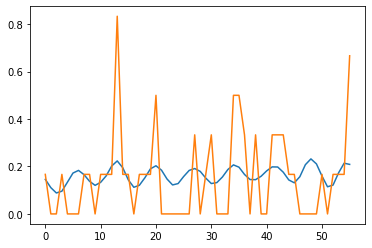

validation 0.032694988
14_lstm 7 0.016959244


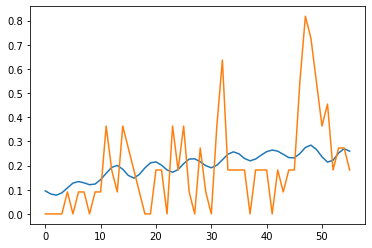

validation 0.03232724
14_lstm 8 0.01716377


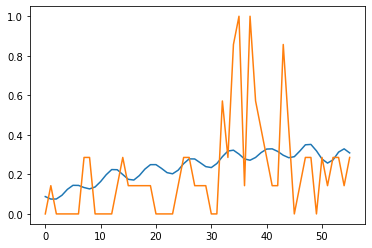

validation 0.032235198
14_lstm 9 0.017109156


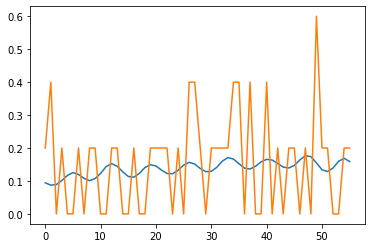

validation 0.03221495
14_lstm 10 0.017693639


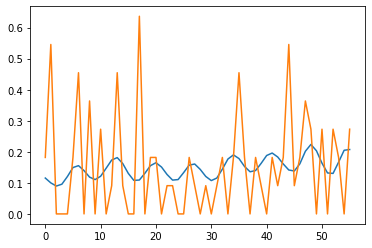

validation 0.032348674
14_lstm 11 0.017880853


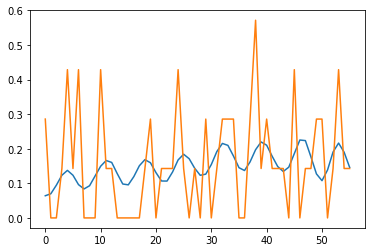

validation 0.032041054
14_lstm 12 0.016457736


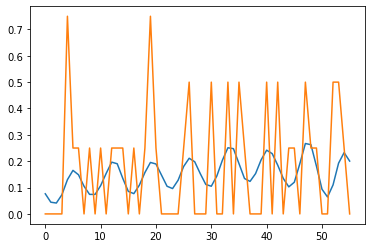

validation 0.03205534
14_lstm 13 0.01702151


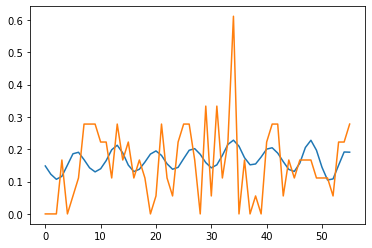

validation 0.031870086
14_lstm 14 0.016441988


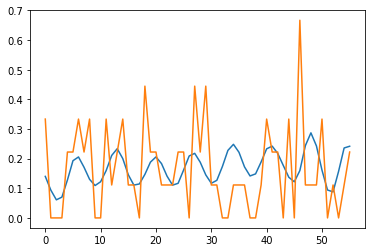

validation 0.031781398
14_lstm 15 0.017005568


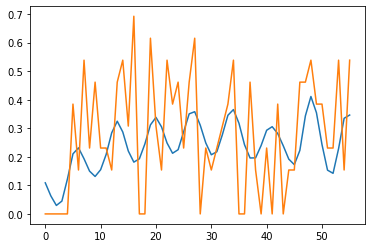

validation 0.031695478
14_lstm 16 0.016999317


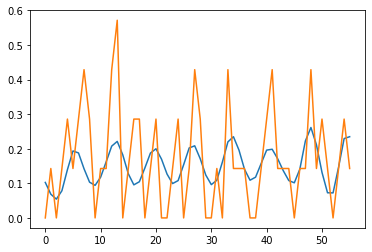

validation 0.03165839
14_lstm 17 0.017225439


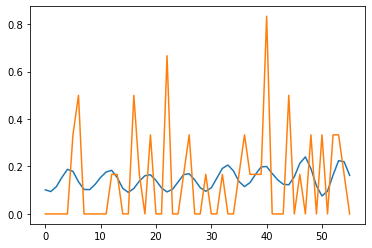

validation 0.03145999
14_lstm 18 0.018230189


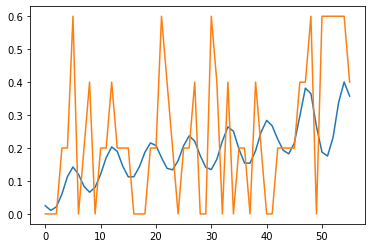

validation 0.03144898
14_lstm 19 0.016120166


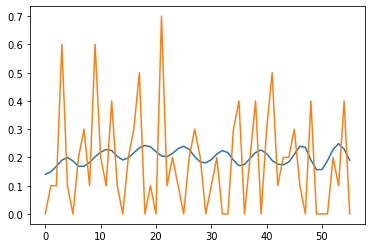

validation 0.031256884
14_lstm 20 0.018088078


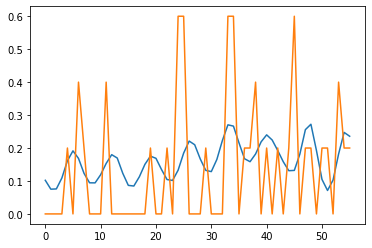

validation 0.03109795
14_lstm 21 0.015314013


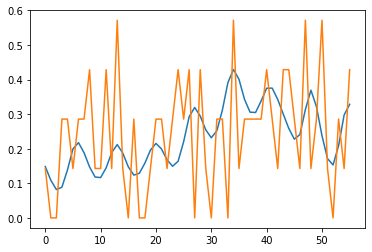

validation 0.030826002
14_lstm 22 0.016028138


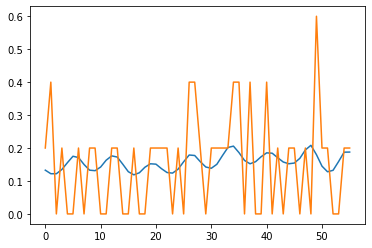

validation 0.030758705
14_lstm 23 0.016609255


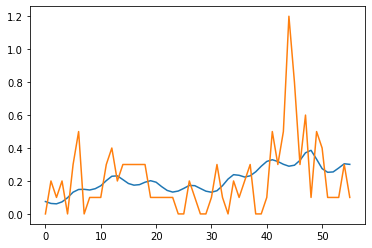

validation 0.030553682
14_lstm 24 0.016265888


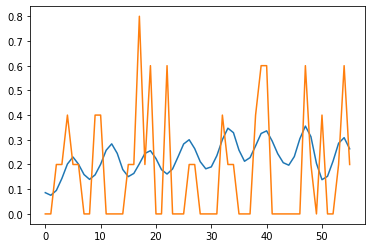

validation 0.030507505
14_lstm 25 0.01745919


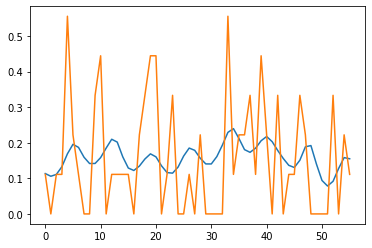

validation 0.030163776
14_lstm 26 0.01722603


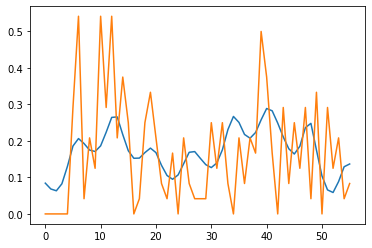

validation 0.029963067
14_lstm 27 0.017127877


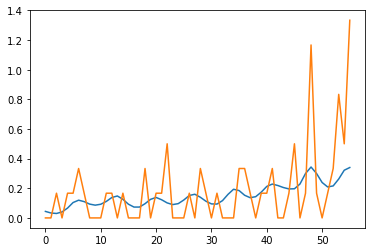

validation 0.0301049
14_lstm 28 0.0162759


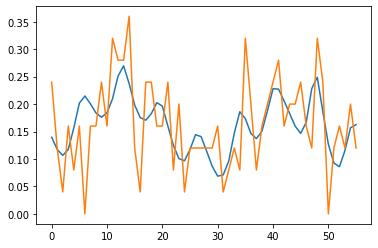

validation 0.029656053
14_lstm 29 0.016401337


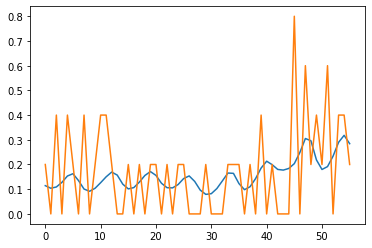

validation 0.029569337
INFO:tensorflow:Assets written to: m5autoreg/model_14_lstm/assets
df shape 1343
starting at 1024
15_lstm 0 0.017554559


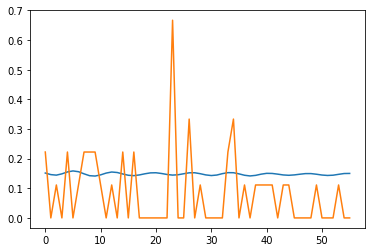

validation 0.023866614
15_lstm 1 0.016745565


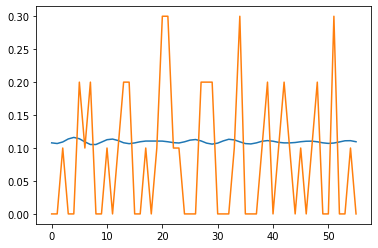

validation 0.023948869
15_lstm 2 0.017879538


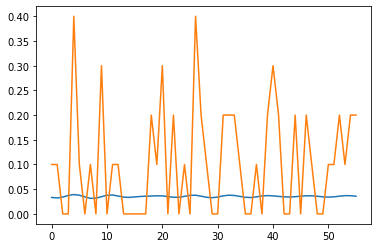

validation 0.023945259
15_lstm 3 0.017399905


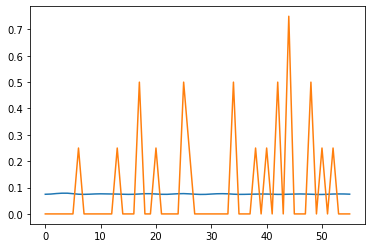

validation 0.023846554
15_lstm 4 0.017539846


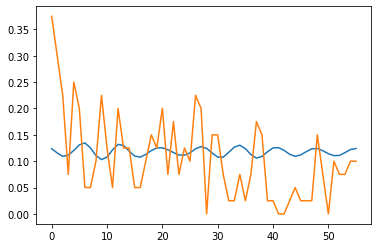

validation 0.02372915
15_lstm 5 0.017265221


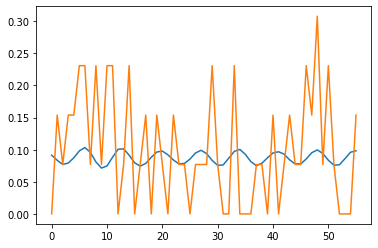

validation 0.023543196
15_lstm 6 0.016567808


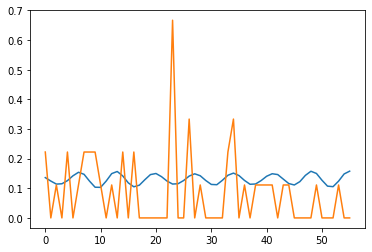

validation 0.023451041
15_lstm 7 0.016611429


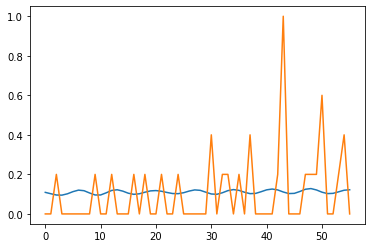

validation 0.023411538
15_lstm 8 0.016335823


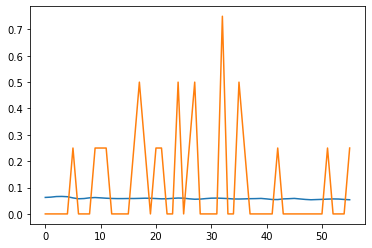

validation 0.02337472
15_lstm 9 0.01723963


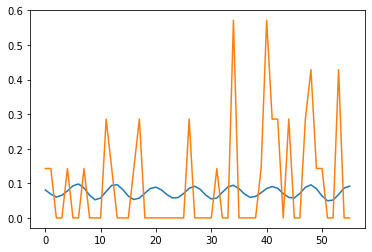

validation 0.023325767
15_lstm 10 0.016200505


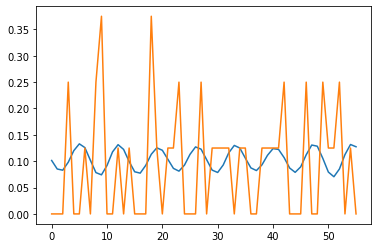

validation 0.023338525
15_lstm 11 0.016224885


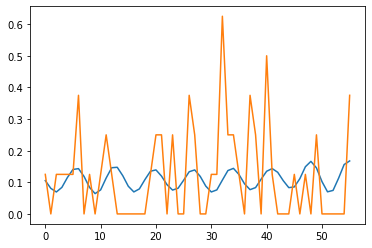

validation 0.023287058
15_lstm 12 0.016371224


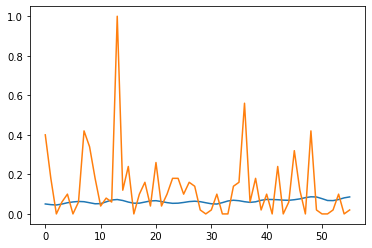

validation 0.023210185
15_lstm 13 0.017163336


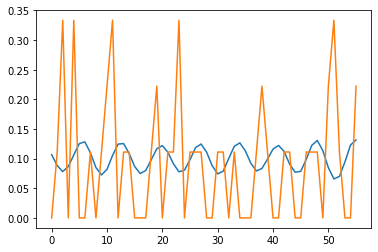

validation 0.02315447
15_lstm 14 0.01607164


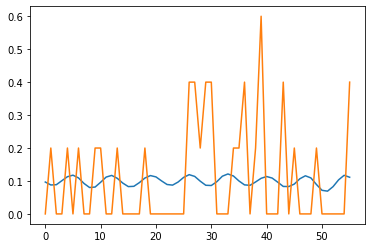

validation 0.023129579
15_lstm 15 0.017054878


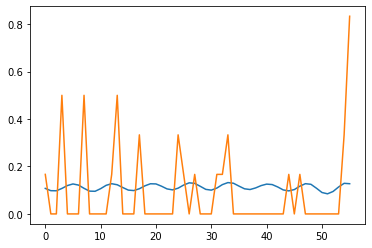

validation 0.02311543
15_lstm 16 0.016780216


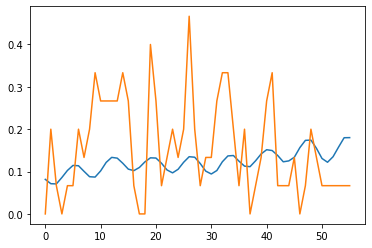

validation 0.022974795
15_lstm 17 0.01683076


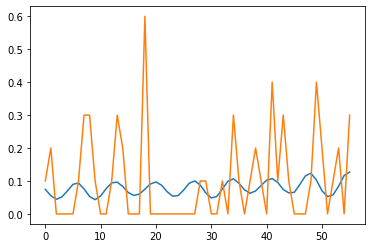

validation 0.022843983
15_lstm 18 0.016308377


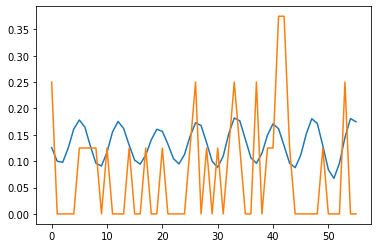

validation 0.022567203
15_lstm 19 0.016739061


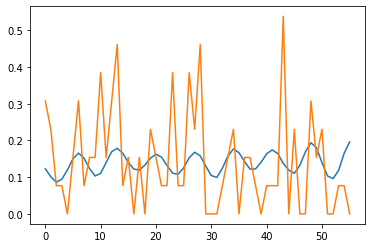

validation 0.02246713
15_lstm 20 0.016247755


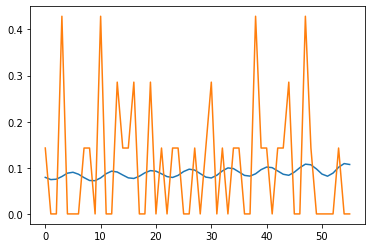

validation 0.022371491
15_lstm 21 0.015823845


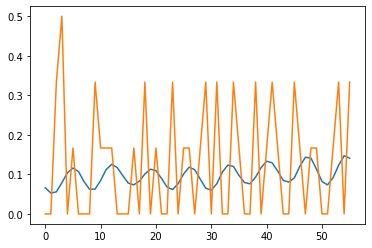

validation 0.022381546
15_lstm 22 0.015600513


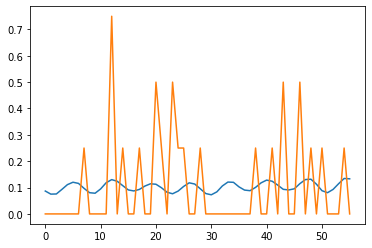

validation 0.022300843
15_lstm 23 0.016464775


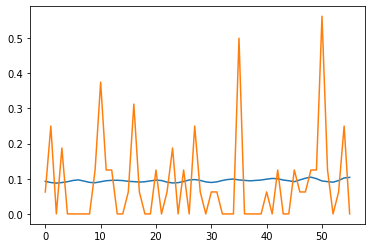

validation 0.022167185
15_lstm 24 0.015912386


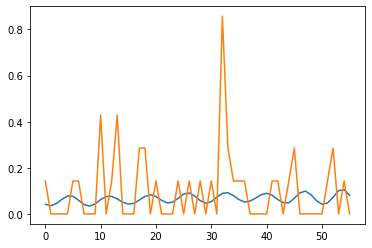

validation 0.022102263
15_lstm 25 0.016197609


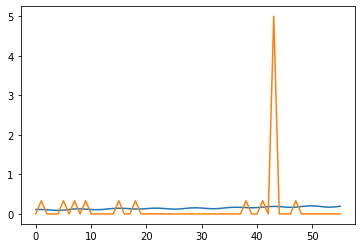

validation 0.022056798
15_lstm 26 0.015990913


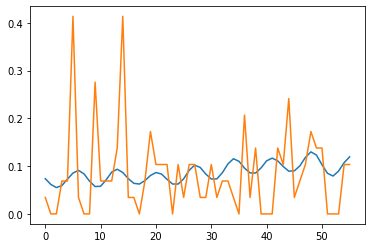

validation 0.022020174
15_lstm 27 0.016101476


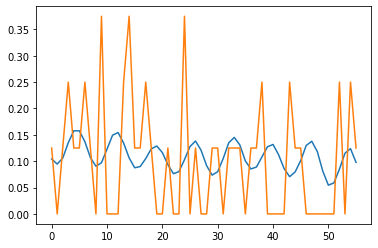

validation 0.022114312
15_lstm 28 0.016512156


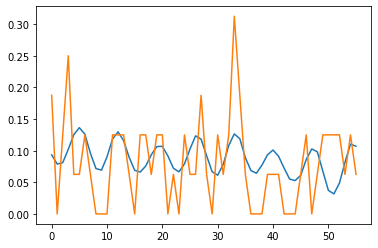

validation 0.022011783
15_lstm 29 0.016173603


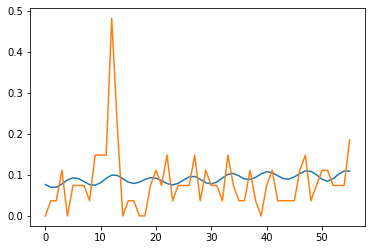

validation 0.021995781
INFO:tensorflow:Assets written to: m5autoreg/model_15_lstm/assets
df shape 699
starting at 1024
16_lstm 0 0.02600397


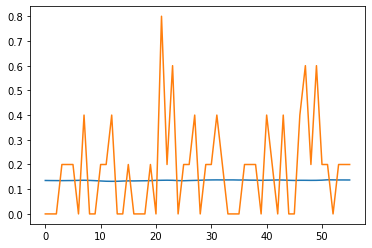

validation 0.035839505
16_lstm 1 0.020775586


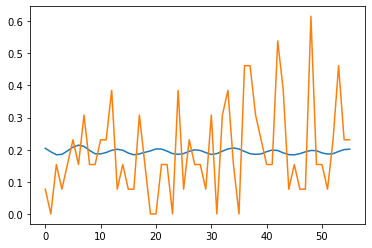

validation 0.034338977
16_lstm 2 0.022622274


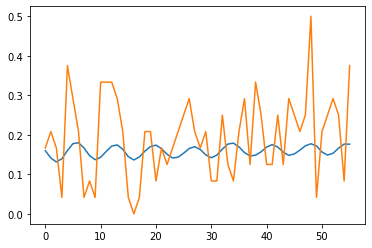

validation 0.034283046
16_lstm 3 0.021845462


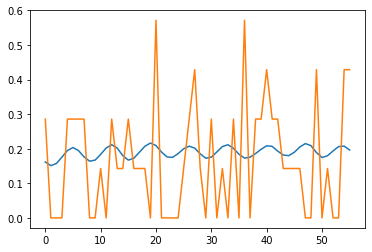

validation 0.033477426
16_lstm 4 0.02108422


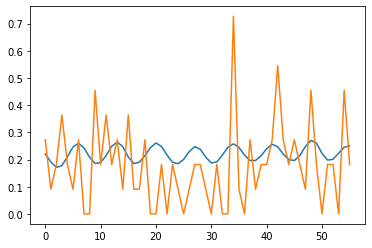

validation 0.03250696
16_lstm 5 0.023414358


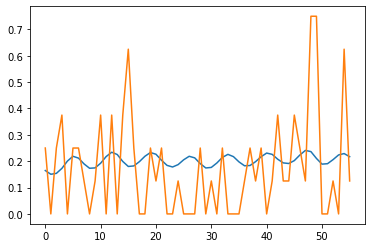

validation 0.03212289
16_lstm 6 0.02085812


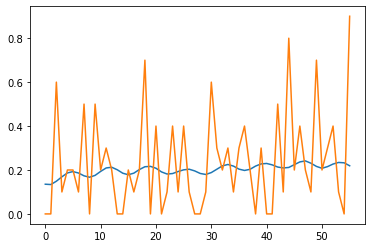

validation 0.031538844
16_lstm 7 0.021652052


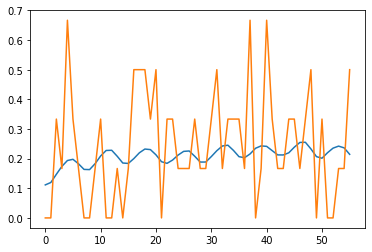

validation 0.03153393
16_lstm 8 0.021391187


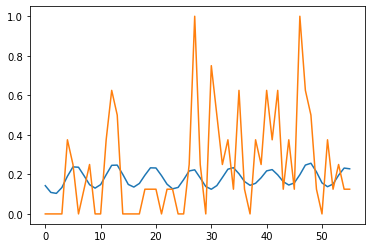

validation 0.031415343
16_lstm 9 0.02170307


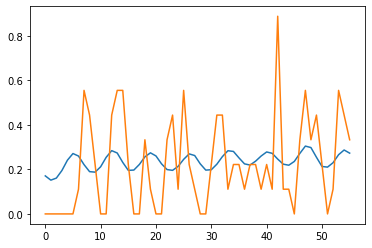

validation 0.031027956
16_lstm 10 0.020308828


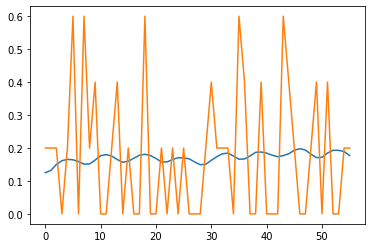

validation 0.030906051
16_lstm 11 0.020217396


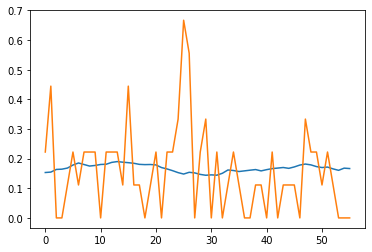

validation 0.030890951
16_lstm 12 0.019464048


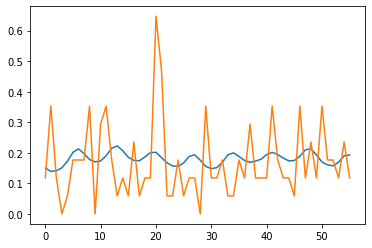

validation 0.030651962
16_lstm 13 0.019580683


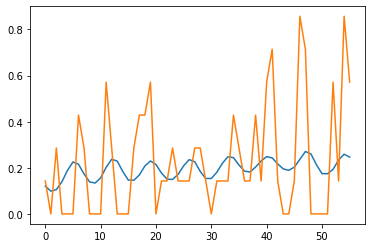

validation 0.030815179
16_lstm 14 0.020395027


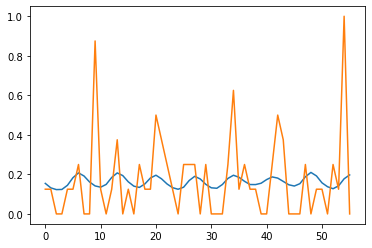

validation 0.030595466
16_lstm 15 0.019896563


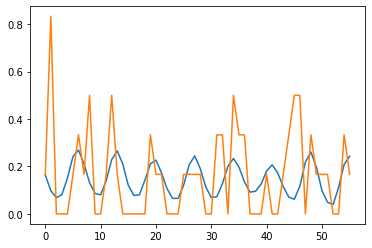

validation 0.030522479
16_lstm 16 0.019587938


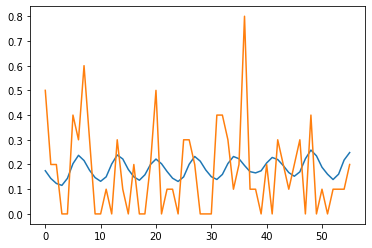

validation 0.030407852
16_lstm 17 0.020386592


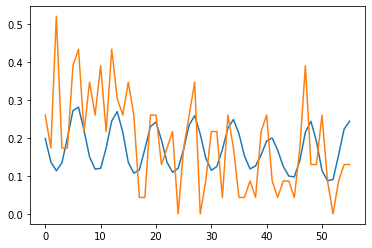

validation 0.03039229
16_lstm 18 0.021220276


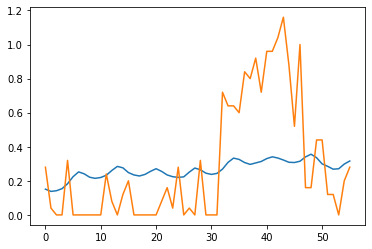

validation 0.030373007
16_lstm 19 0.020931812


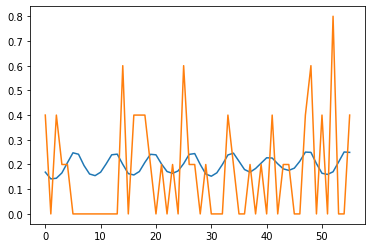

validation 0.030492276
16_lstm 20 0.020259442


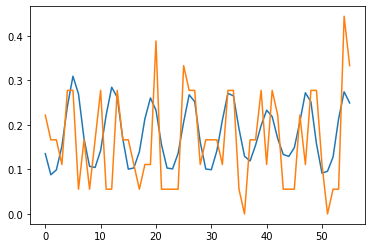

validation 0.030384062
16_lstm 21 0.020032607


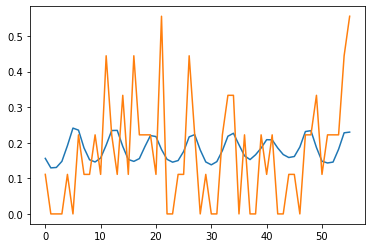

validation 0.030403754
16_lstm 22 0.018996762


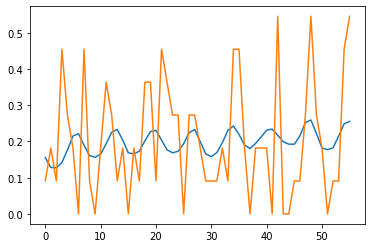

validation 0.030216822
16_lstm 23 0.018834412


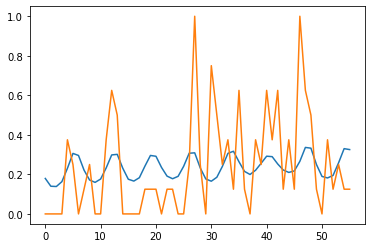

validation 0.030192567
16_lstm 24 0.020010002


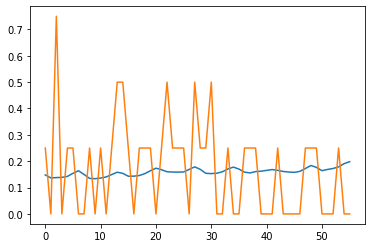

validation 0.030295921
16_lstm 25 0.02022528


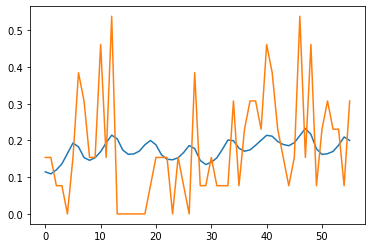

validation 0.03018032
16_lstm 26 0.020718629


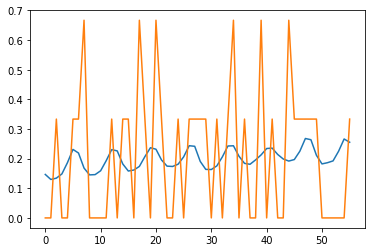

validation 0.030182455
16_lstm 27 0.019811185


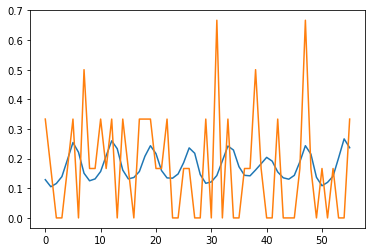

validation 0.030199552
16_lstm 28 0.020045342


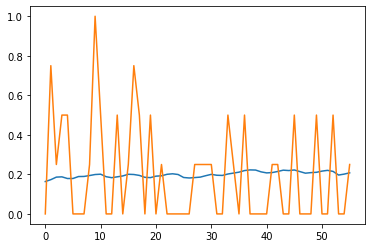

validation 0.029998912
16_lstm 29 0.019762896


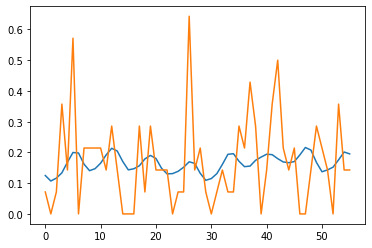

validation 0.029961856
INFO:tensorflow:Assets written to: m5autoreg/model_16_lstm/assets
df shape 2242
starting at 1024
17_lstm 0 0.010942891


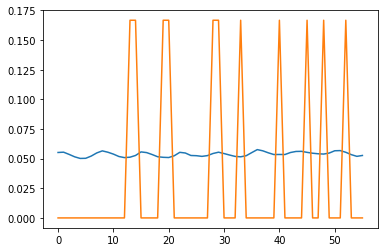

validation 0.010540376
17_lstm 1 0.010142377


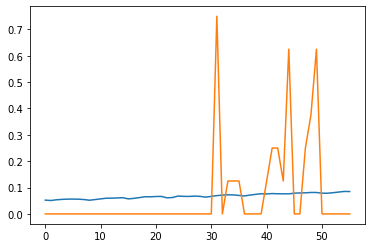

validation 0.010338053
17_lstm 2 0.010817506


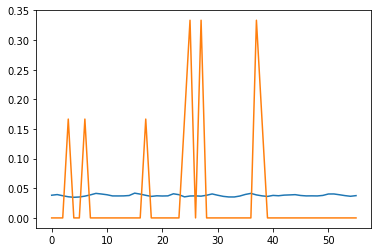

validation 0.010330105
17_lstm 3 0.010248405


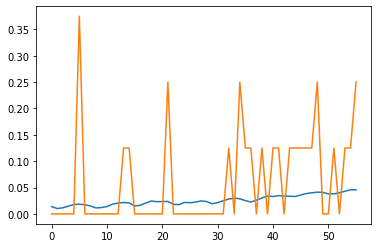

validation 0.010261975
17_lstm 4 0.009603931


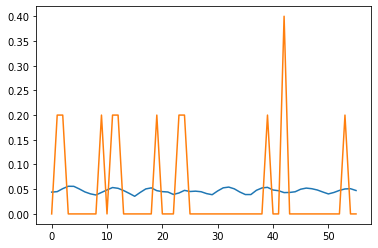

validation 0.010208675
17_lstm 5 0.0099561075


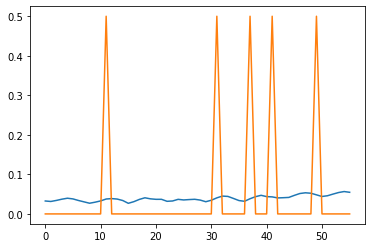

validation 0.010205748
17_lstm 6 0.010362041


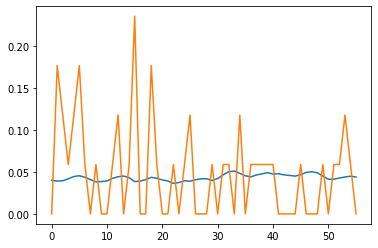

validation 0.010098736
17_lstm 7 0.010544293


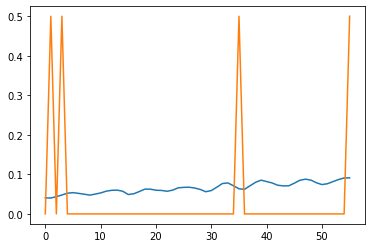

validation 0.010051957
17_lstm 8 0.01009132


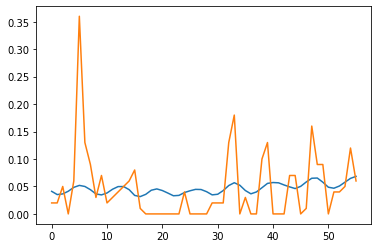

validation 0.010015009
17_lstm 9 0.009764602


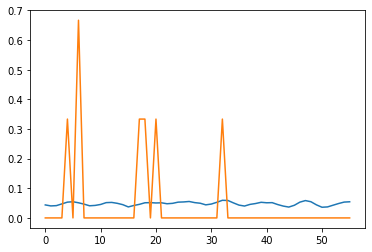

validation 0.009984409
17_lstm 10 0.010095508


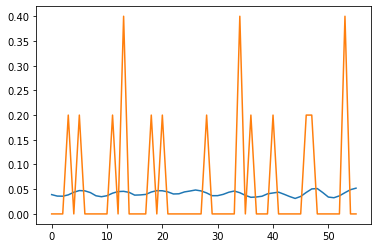

validation 0.009953497
17_lstm 11 0.010289606


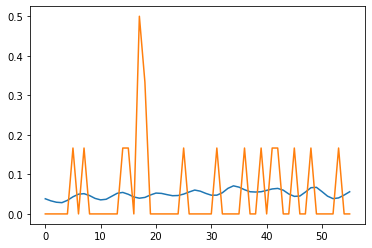

validation 0.009914069
17_lstm 12 0.009837153


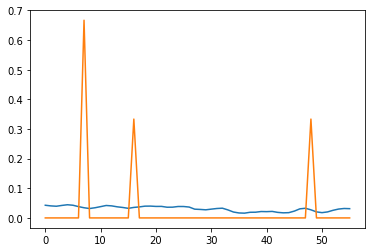

validation 0.00987366
17_lstm 13 0.010103758


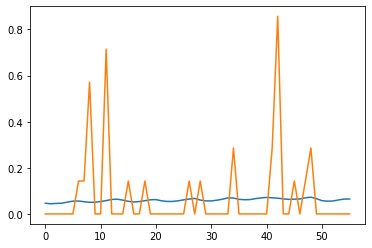

validation 0.009850368
17_lstm 14 0.00970116


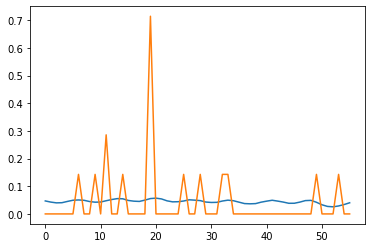

validation 0.009802465
17_lstm 15 0.00987205


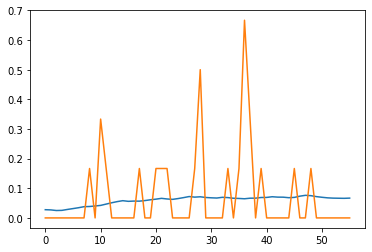

validation 0.009760057
17_lstm 16 0.009294206


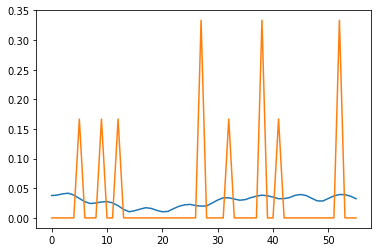

validation 0.009722431
17_lstm 17 0.009945471


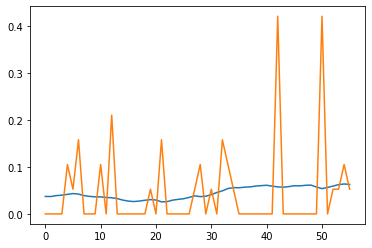

validation 0.009692072
17_lstm 18 0.009751059


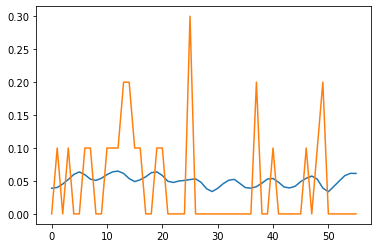

validation 0.009667243
17_lstm 19 0.010105729


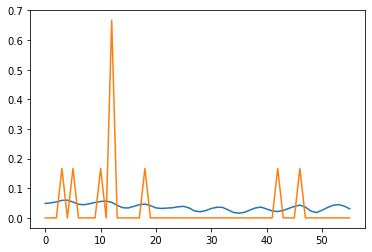

validation 0.00965459
17_lstm 20 0.009496808


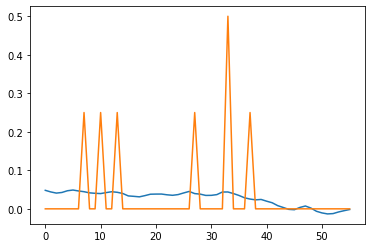

validation 0.009645892
17_lstm 21 0.009848571


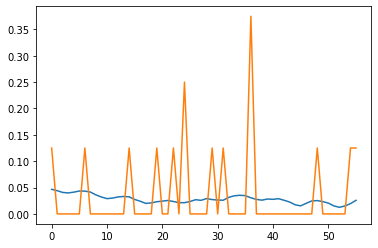

validation 0.009590914
17_lstm 22 0.009312736


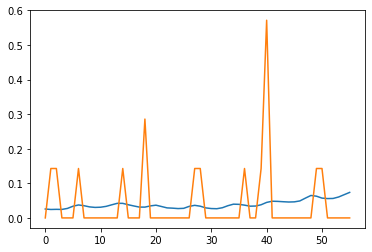

validation 0.009598228
17_lstm 23 0.009858978


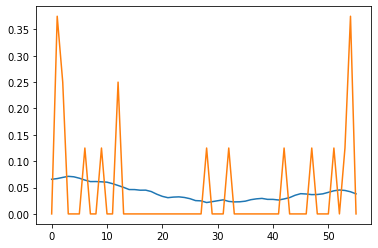

validation 0.009553554
17_lstm 24 0.009306902


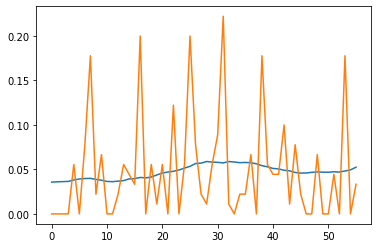

validation 0.009546736
17_lstm 25 0.009818895


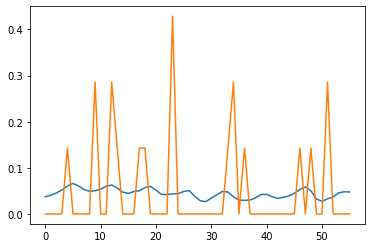

validation 0.009544117
17_lstm 26 0.009781057


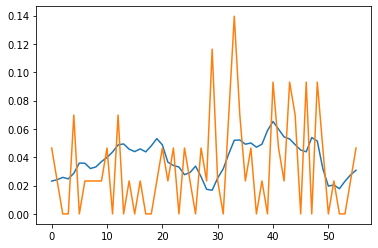

validation 0.009485098
17_lstm 27 0.009774166


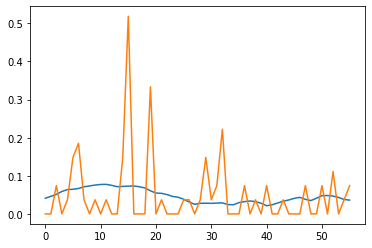

validation 0.009478237
17_lstm 28 0.009634047


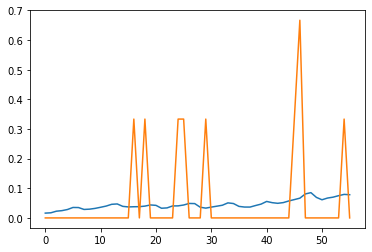

validation 0.009440328
17_lstm 29 0.009375203


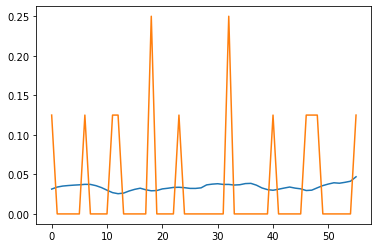

validation 0.00943414
INFO:tensorflow:Assets written to: m5autoreg/model_17_lstm/assets
df shape 286
starting at 1024
18_lstm 0 0.025973916


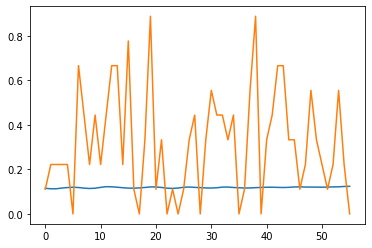

validation 0.04447894
18_lstm 1 0.026929228


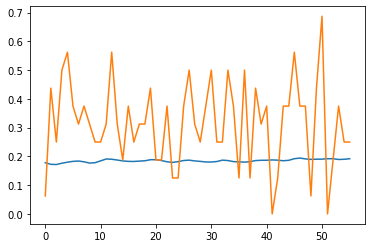

validation 0.042169813
18_lstm 2 0.023811558


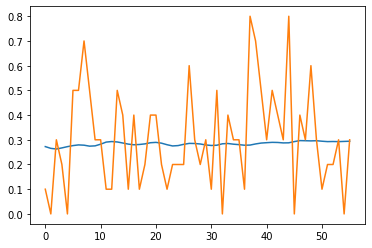

validation 0.039183922
18_lstm 3 0.025327599


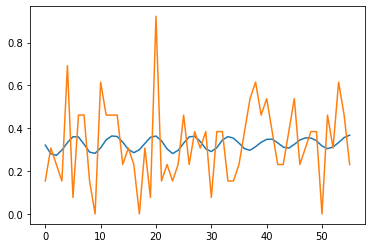

validation 0.03726187
18_lstm 4 0.025361551


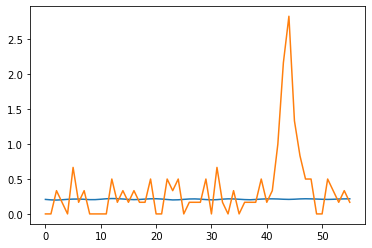

validation 0.035841238
18_lstm 5 0.022802472


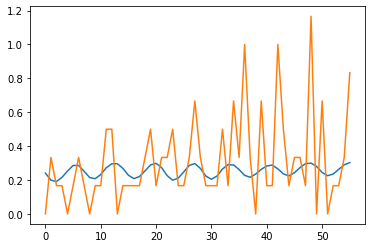

validation 0.035314906
18_lstm 6 0.022483438


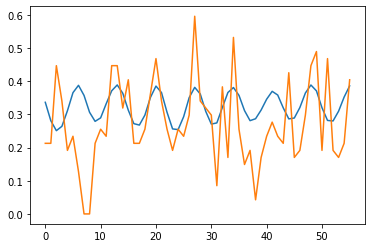

validation 0.034966733
18_lstm 7 0.023989683


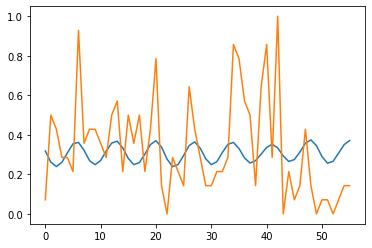

validation 0.034091152
18_lstm 8 0.023450661


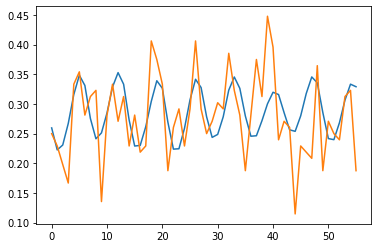

validation 0.034008045
18_lstm 9 0.022461189


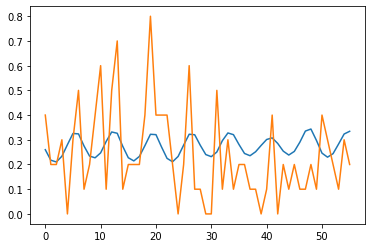

validation 0.033919983
18_lstm 10 0.022823844


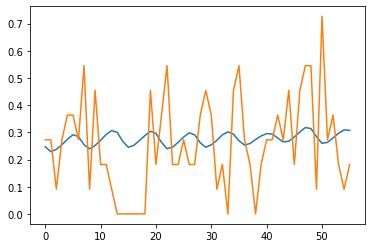

validation 0.033570502
18_lstm 11 0.021500723


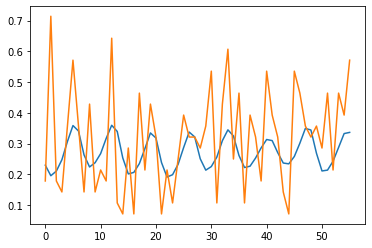

validation 0.033237625
18_lstm 12 0.021698924


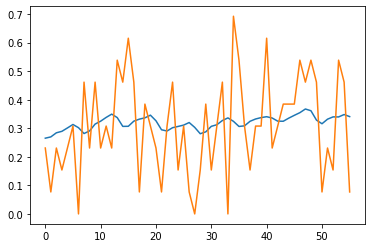

validation 0.033178248
18_lstm 13 0.021287592


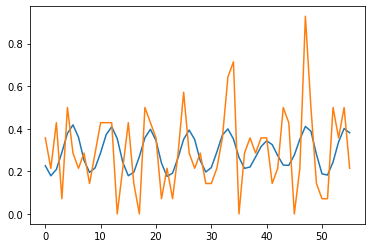

validation 0.033166885
18_lstm 14 0.022736648


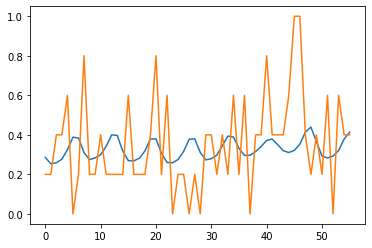

validation 0.033105124
18_lstm 15 0.021002037


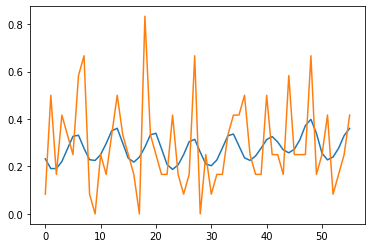

validation 0.033172313
18_lstm 16 0.020388387


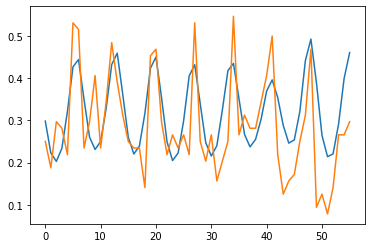

validation 0.033122342
18_lstm 17 0.022257047


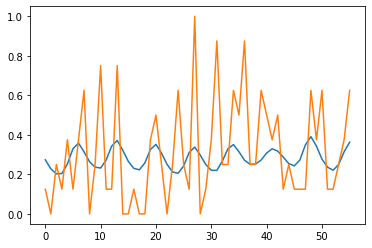

validation 0.033122897
18_lstm 18 0.023040758


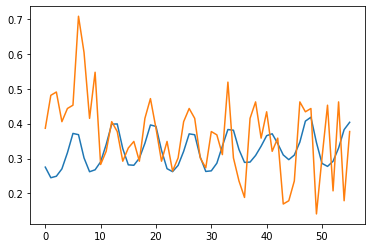

validation 0.03299317
18_lstm 19 0.021719577


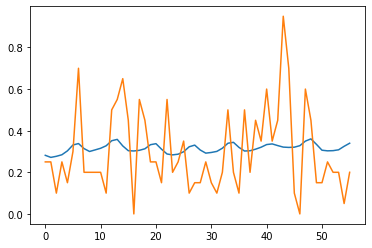

validation 0.03270465
18_lstm 20 0.021799395


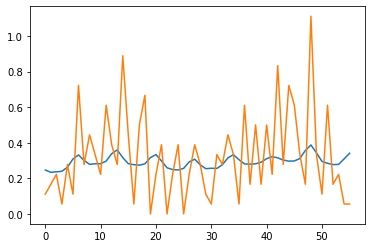

validation 0.032678854
18_lstm 21 0.019655418


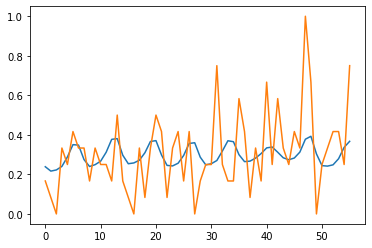

validation 0.03258915
18_lstm 22 0.020421566


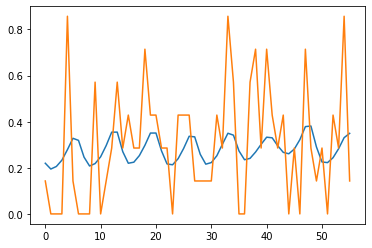

validation 0.032349218
18_lstm 23 0.020144267


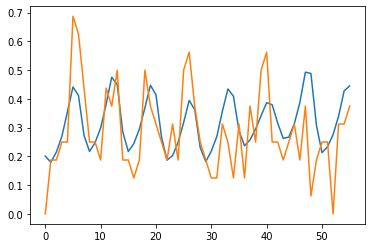

validation 0.032378703
18_lstm 24 0.020198619


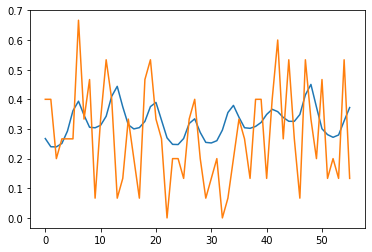

validation 0.032251004
18_lstm 25 0.017910313


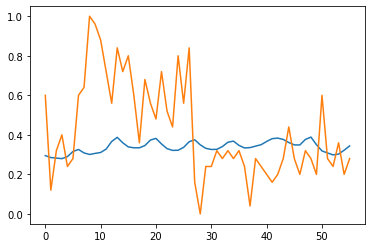

validation 0.032204974
18_lstm 26 0.02100511


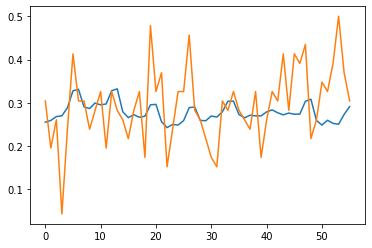

validation 0.03218623
18_lstm 27 0.019612584


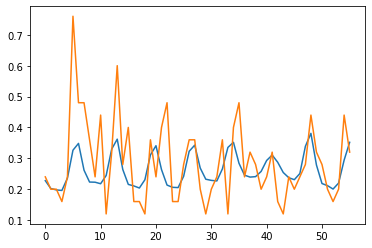

validation 0.031843394
18_lstm 28 0.021607116


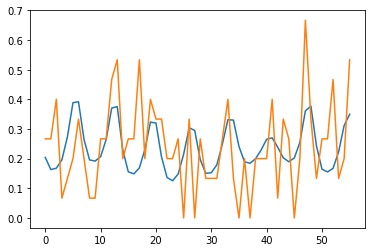

validation 0.03184805
18_lstm 29 0.021120688


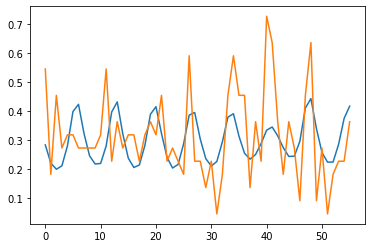

validation 0.03160956
INFO:tensorflow:Assets written to: m5autoreg/model_18_lstm/assets
df shape 510
starting at 1024
19_lstm 0 0.027036263


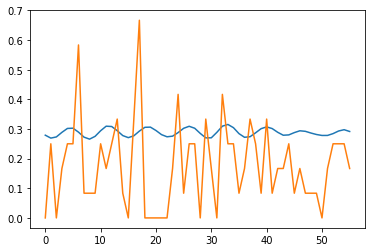

validation 0.039869197
19_lstm 1 0.023088155


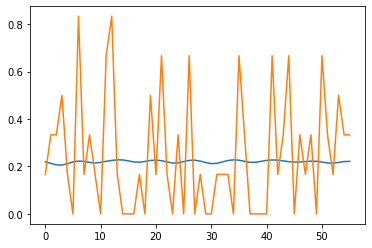

validation 0.03843703
19_lstm 2 0.02561792


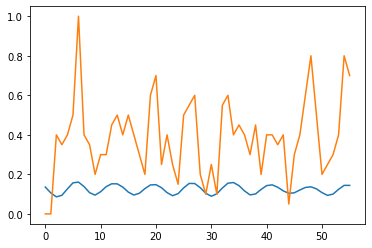

validation 0.037529867
19_lstm 3 0.025373545


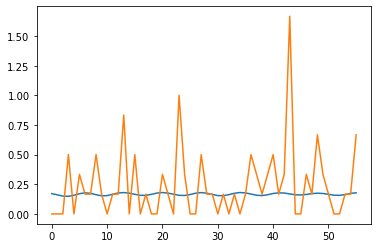

validation 0.037629623
19_lstm 4 0.024193533


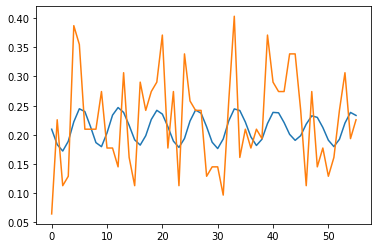

validation 0.037473984
19_lstm 5 0.024102647


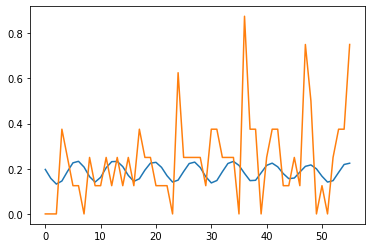

validation 0.037308387
19_lstm 6 0.023418305


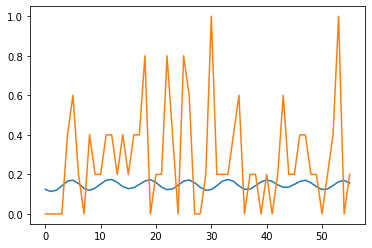

validation 0.036821704
19_lstm 7 0.022533743


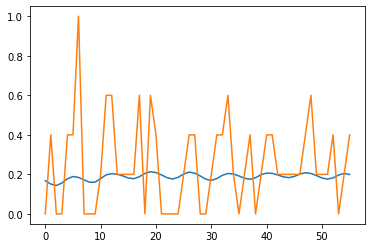

validation 0.03564183
19_lstm 8 0.020552542


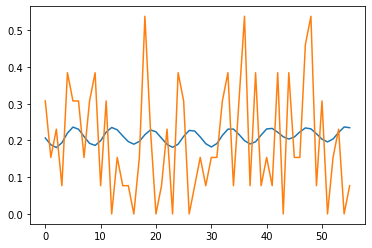

validation 0.03448645
19_lstm 9 0.024031654


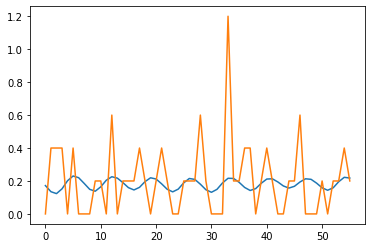

validation 0.03420379
19_lstm 10 0.022209143


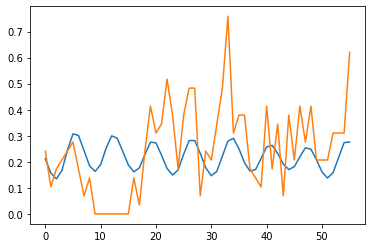

validation 0.033785034
19_lstm 11 0.021942995


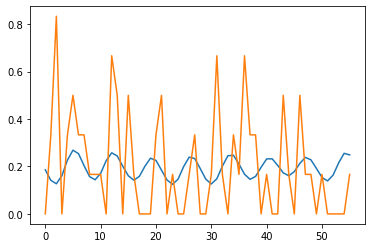

validation 0.033468418
19_lstm 12 0.020454217


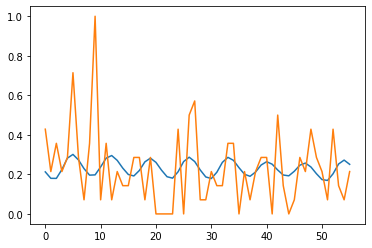

validation 0.033560146
19_lstm 13 0.021246748


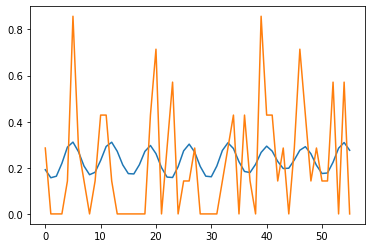

validation 0.033468205
19_lstm 14 0.022669911


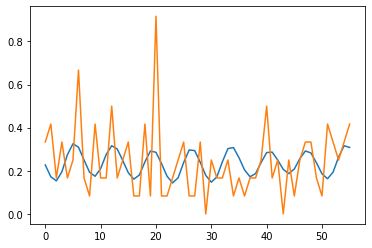

validation 0.0336114
19_lstm 15 0.022811202


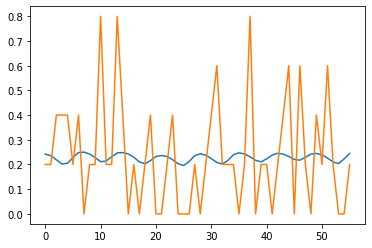

validation 0.033513572
19_lstm 16 0.022750475


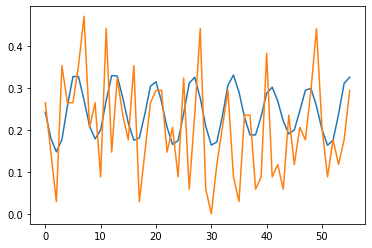

validation 0.033418592
19_lstm 17 0.02188631


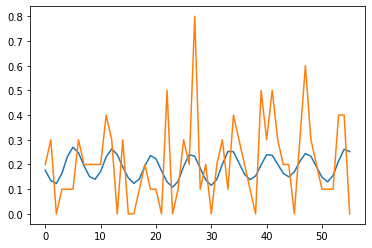

validation 0.033517025
19_lstm 18 0.022528043


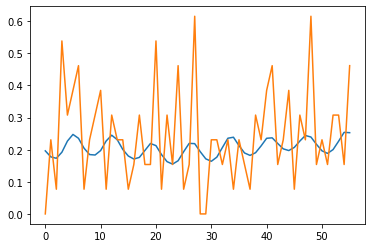

validation 0.033533454
19_lstm 19 0.020823736


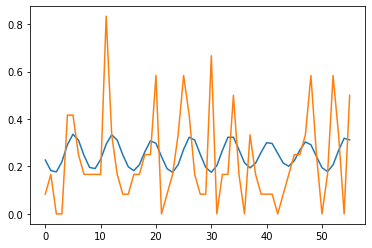

validation 0.033306293
19_lstm 20 0.0221003


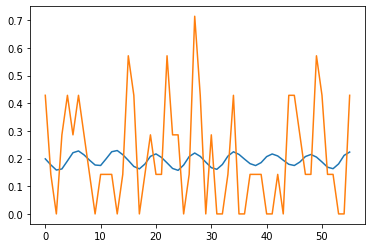

validation 0.03327494
19_lstm 21 0.02208447


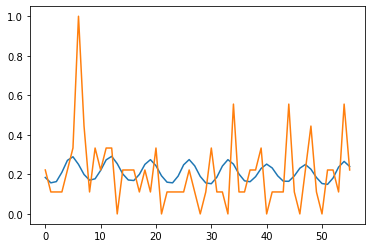

validation 0.03303178
19_lstm 22 0.020643942


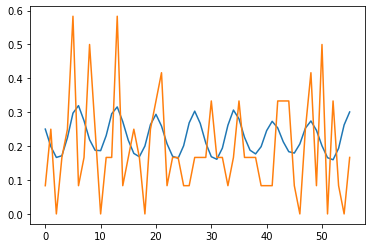

validation 0.03301878
19_lstm 23 0.023080135


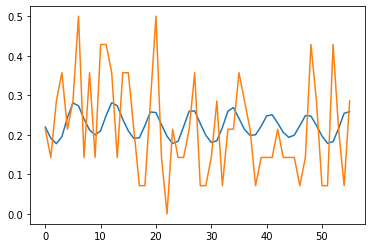

validation 0.0329539
19_lstm 24 0.023166664


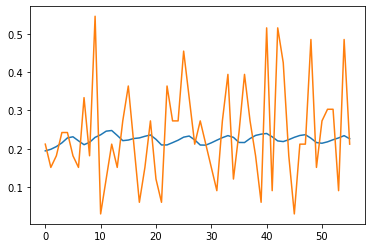

validation 0.03306064
19_lstm 25 0.021444911


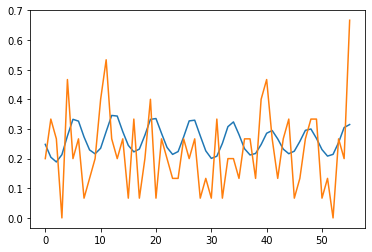

validation 0.032837994
19_lstm 26 0.021114659


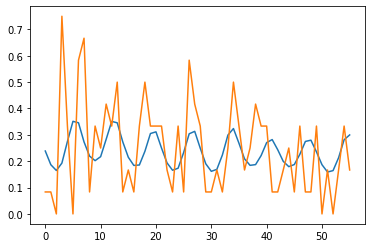

validation 0.032973107
19_lstm 27 0.022717632


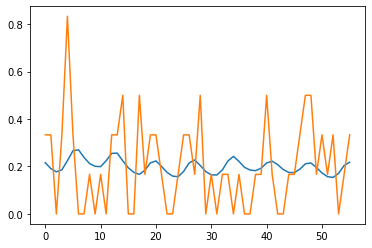

validation 0.03285798
19_lstm 28 0.019401269


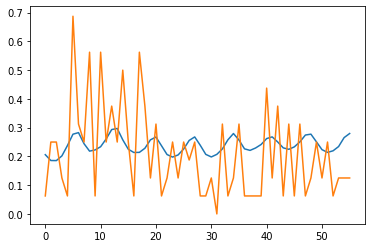

validation 0.032740183
19_lstm 29 0.020226495


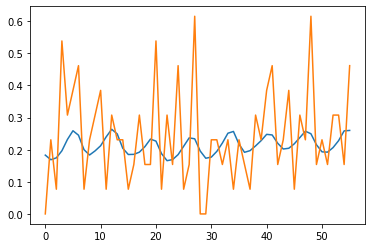

validation 0.032870702
INFO:tensorflow:Assets written to: m5autoreg/model_19_lstm/assets
df shape 933
starting at 1024
20_lstm 0 0.019877663


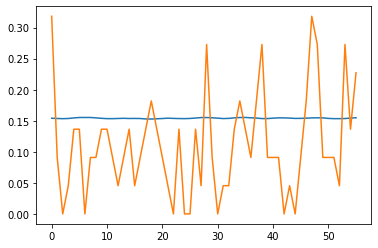

validation 0.02247543
20_lstm 1 0.018789394


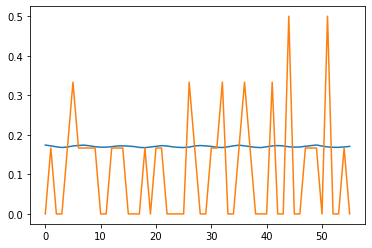

validation 0.022532914
20_lstm 2 0.019589515


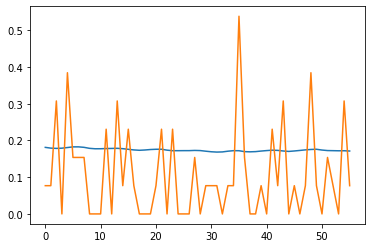

validation 0.02234387
20_lstm 3 0.020340756


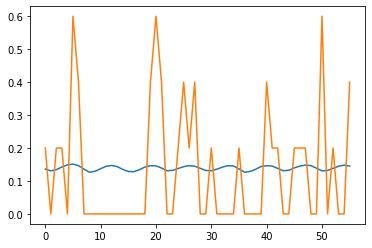

validation 0.0223947
20_lstm 4 0.019647278


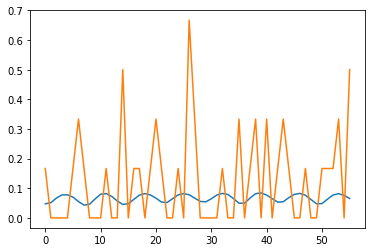

validation 0.022100335
20_lstm 5 0.019176764


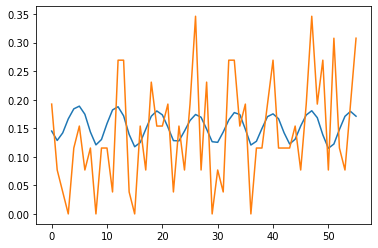

validation 0.021641478
20_lstm 6 0.01893647


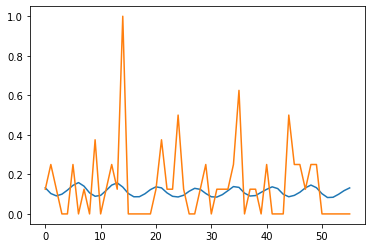

validation 0.021345347
20_lstm 7 0.01930556


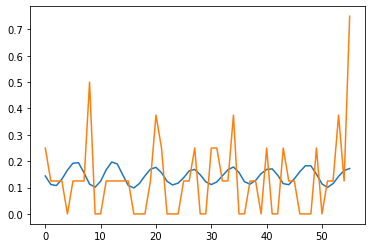

validation 0.021222102
20_lstm 8 0.019284034


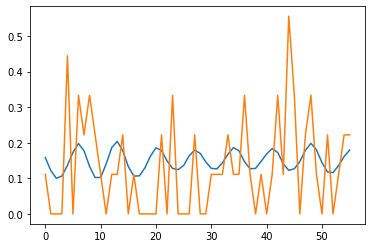

validation 0.021335116
20_lstm 9 0.017689828


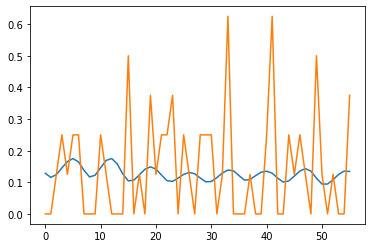

validation 0.021282775
20_lstm 10 0.018856522


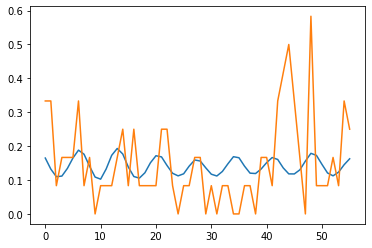

validation 0.021307286
20_lstm 11 0.018437315


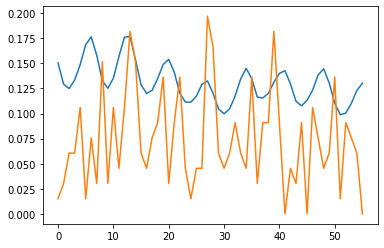

validation 0.021155791
20_lstm 12 0.017956778


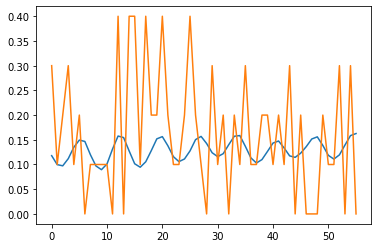

validation 0.021064775
20_lstm 13 0.018074175


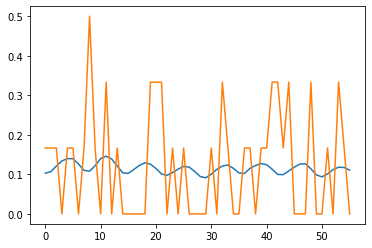

validation 0.021108449
20_lstm 14 0.018457627


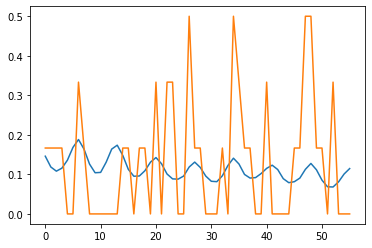

validation 0.021067709
20_lstm 15 0.018222012


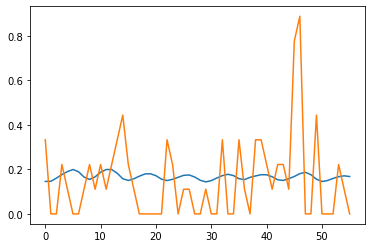

validation 0.020940827
20_lstm 16 0.017244322


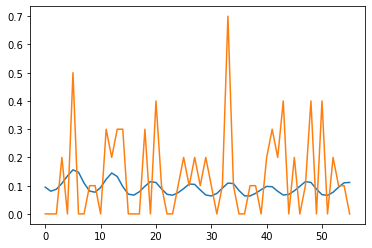

validation 0.020956231
20_lstm 17 0.018425282


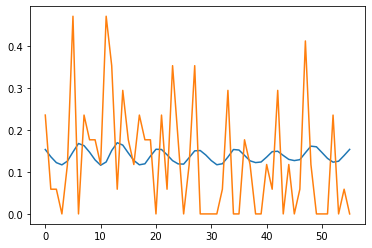

validation 0.020995557
20_lstm 18 0.017295254


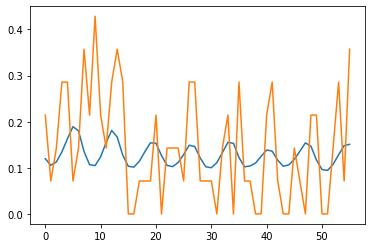

validation 0.02098577
20_lstm 19 0.017822567


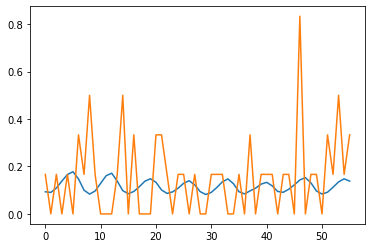

validation 0.020974448
20_lstm 20 0.01768004


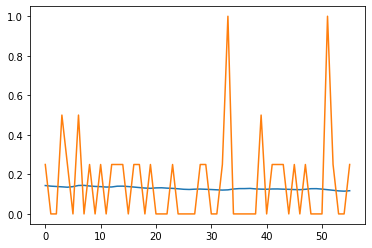

validation 0.020984396
20_lstm 21 0.01716799


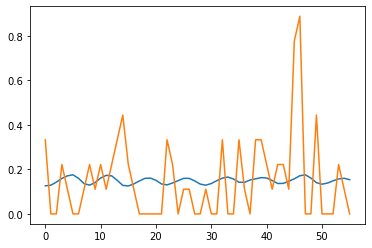

validation 0.020939246
20_lstm 22 0.017675132


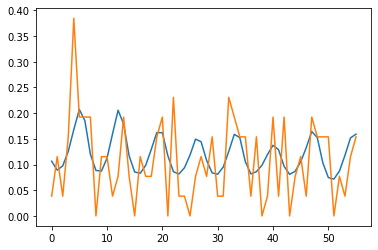

validation 0.020891467
20_lstm 23 0.017800644


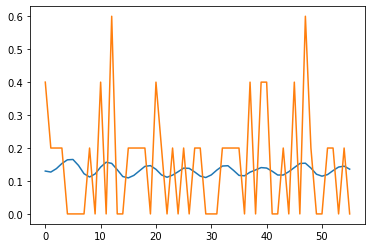

validation 0.020854859
20_lstm 24 0.017533766


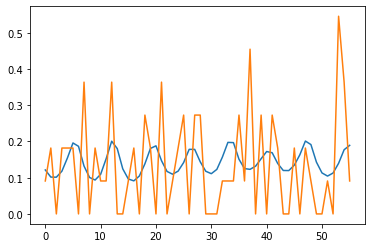

validation 0.020823404
20_lstm 25 0.018242326


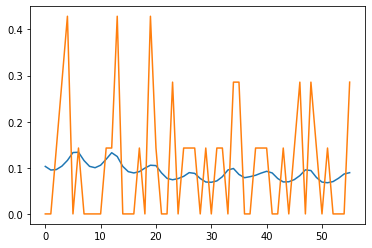

validation 0.020784607
20_lstm 26 0.01685132


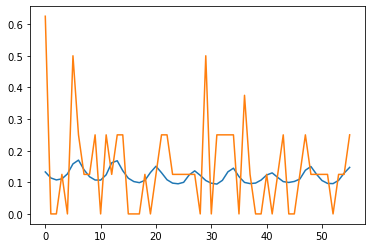

validation 0.020726502
20_lstm 27 0.01742512


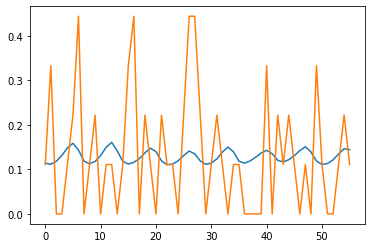

validation 0.02068862
20_lstm 28 0.017990738


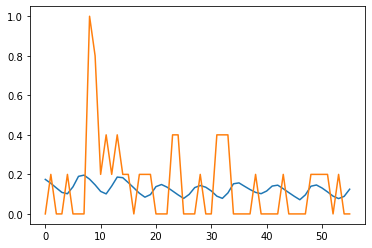

validation 0.020635214
20_lstm 29 0.017971365


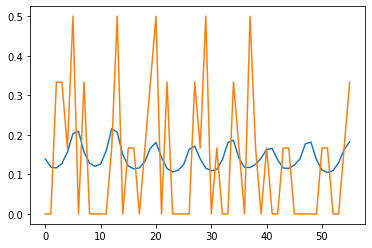

validation 0.020609306
INFO:tensorflow:Assets written to: m5autoreg/model_20_lstm/assets
df shape 1781
starting at 1024
21_lstm 0 0.01394815


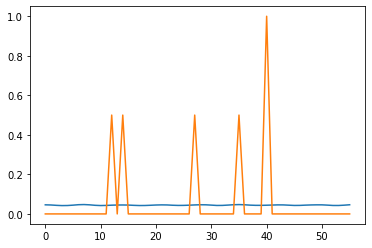

validation 0.014682861
21_lstm 1 0.013724289


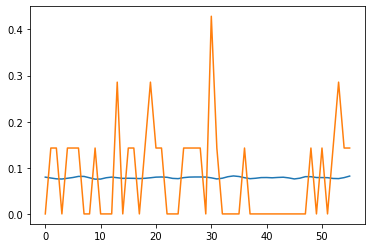

validation 0.014627926
21_lstm 2 0.013714624


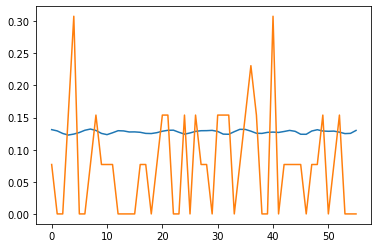

validation 0.014507539
21_lstm 3 0.013338831


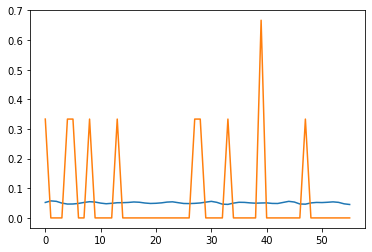

validation 0.014504239
21_lstm 4 0.013909012


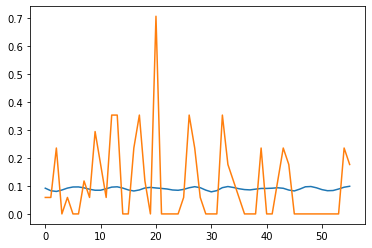

validation 0.014475359
21_lstm 5 0.013294432


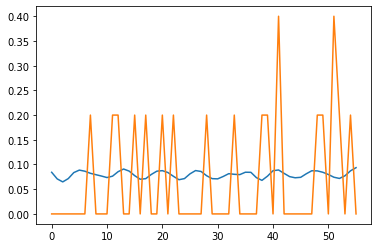

validation 0.014359287
21_lstm 6 0.013844954


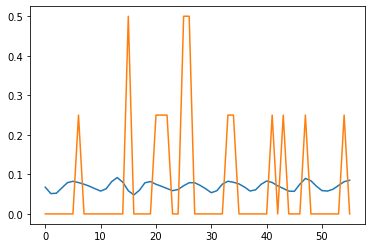

validation 0.014310245
21_lstm 7 0.012980131


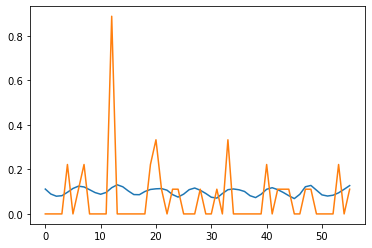

validation 0.014280887
21_lstm 8 0.013670205


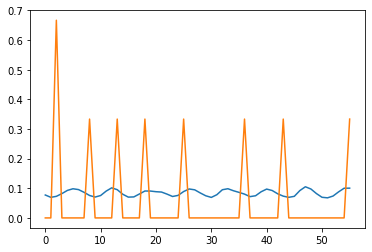

validation 0.014291299
21_lstm 9 0.013153346


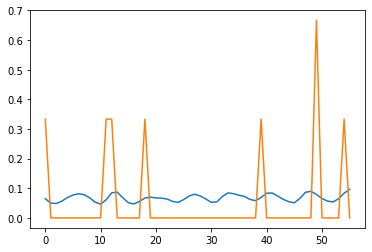

validation 0.014179059
21_lstm 10 0.01330665


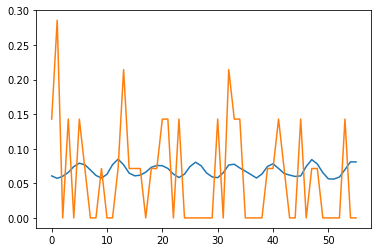

validation 0.014094496
21_lstm 11 0.013374387


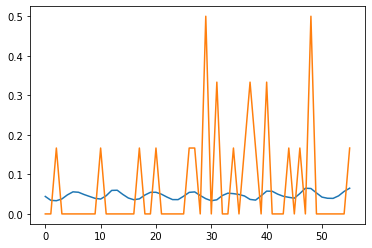

validation 0.014097578
21_lstm 12 0.013501962


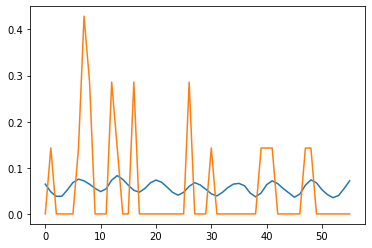

validation 0.014150469
21_lstm 13 0.0131037785


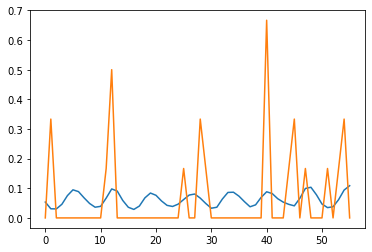

validation 0.0141278235
21_lstm 14 0.012934505


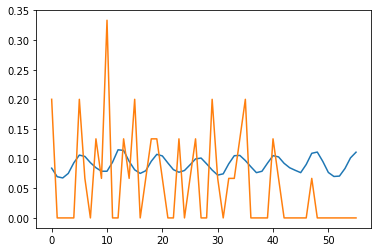

validation 0.014070913
21_lstm 15 0.013258563


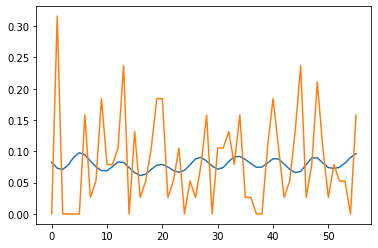

validation 0.01399381
21_lstm 16 0.012847566


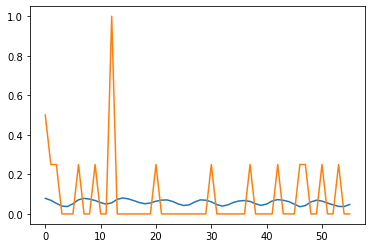

validation 0.013953589
21_lstm 17 0.012576935


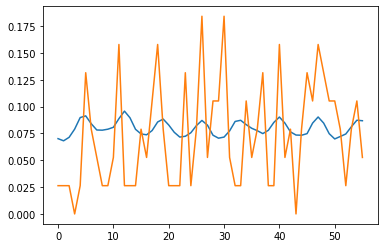

validation 0.013958077
21_lstm 18 0.013843124


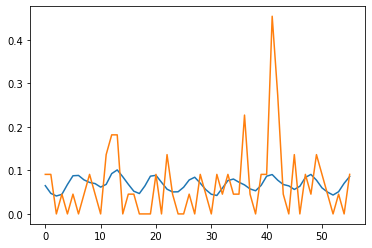

validation 0.013964577
21_lstm 19 0.012854986


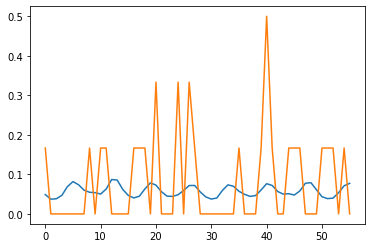

validation 0.01393813
21_lstm 20 0.012991694


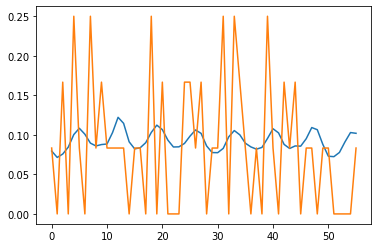

validation 0.013955874
21_lstm 21 0.013413291


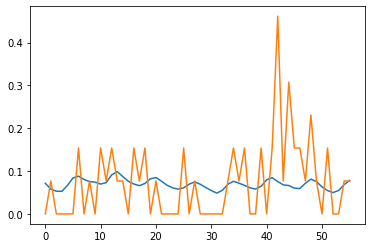

validation 0.013925597
21_lstm 22 0.013181679


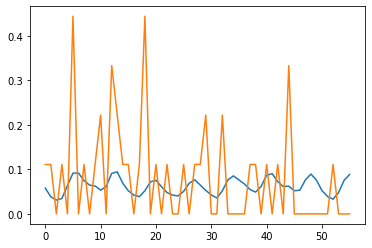

validation 0.013910747
21_lstm 23 0.01240503


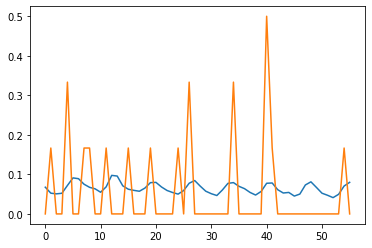

validation 0.013911218
21_lstm 24 0.013199945


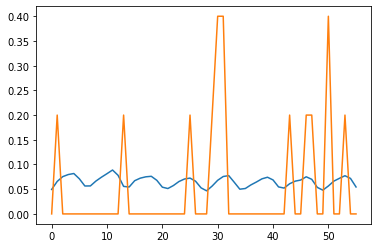

validation 0.013927293
21_lstm 25 0.0124514345


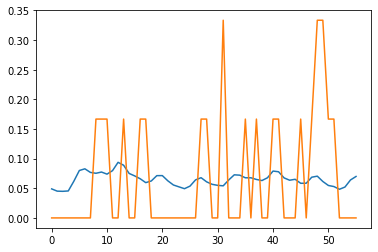

validation 0.01390183
21_lstm 26 0.0130656315


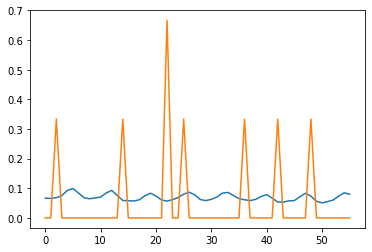

validation 0.013880263
21_lstm 27 0.012735224


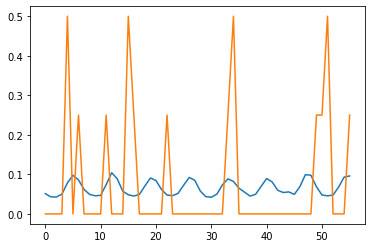

validation 0.013889755
21_lstm 28 0.012571314


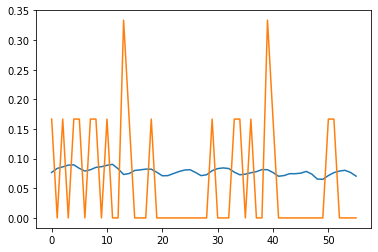

validation 0.0138749415
21_lstm 29 0.013095915


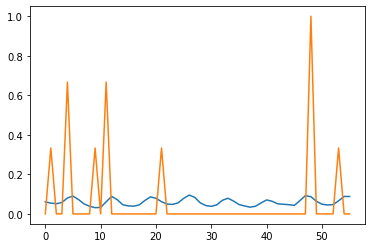

validation 0.0138609875
INFO:tensorflow:Assets written to: m5autoreg/model_21_lstm/assets
df shape 1945
starting at 1024
22_lstm 0 0.012633418


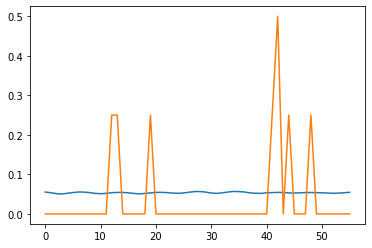

validation 0.013005846
22_lstm 1 0.013190907


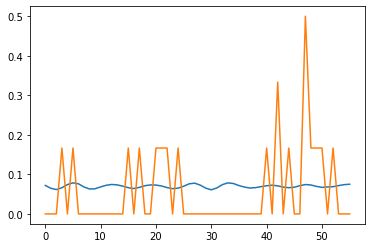

validation 0.012804291
22_lstm 2 0.01258276


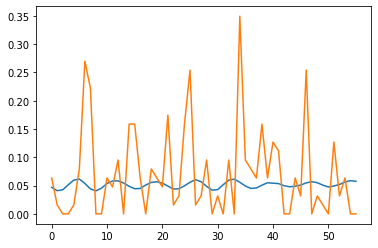

validation 0.012818984
22_lstm 3 0.012677376


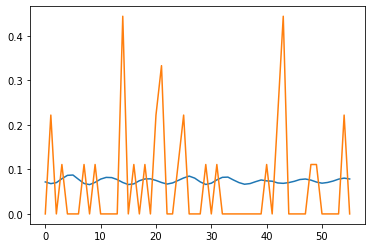

validation 0.012785427
22_lstm 4 0.012924749


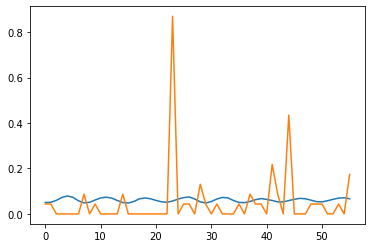

validation 0.012757599
22_lstm 5 0.012135749


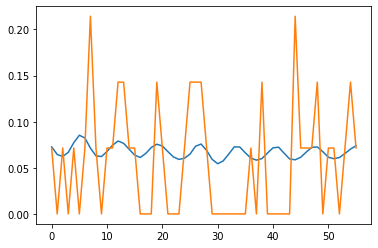

validation 0.012672484
22_lstm 6 0.012060398


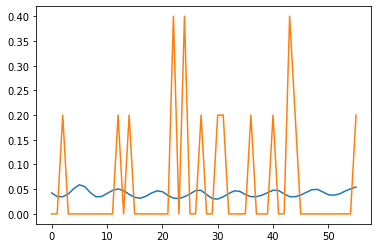

validation 0.012665174
22_lstm 7 0.012006229


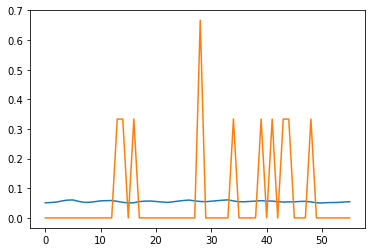

validation 0.0125440275
22_lstm 8 0.011787093


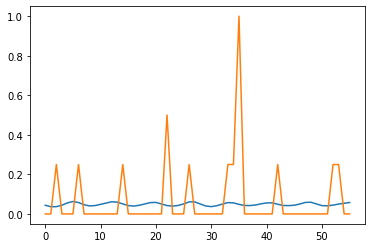

validation 0.012529619
22_lstm 9 0.0124716


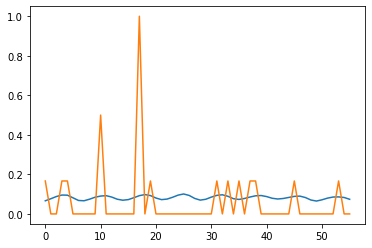

validation 0.012479497
22_lstm 10 0.012395025


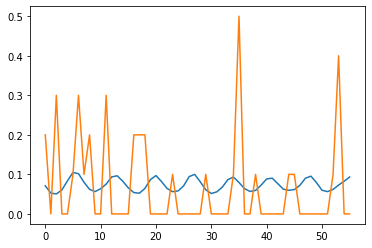

validation 0.012458069
22_lstm 11 0.01204671


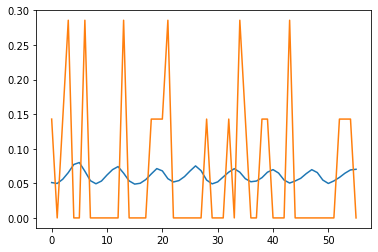

validation 0.012423895
22_lstm 12 0.012256101


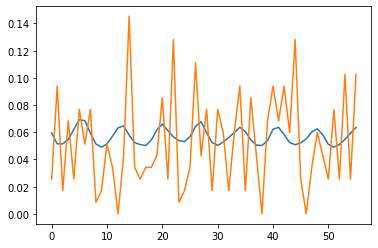

validation 0.012356126
22_lstm 13 0.01183458


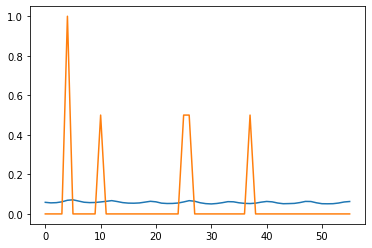

validation 0.012323747
22_lstm 14 0.012010077


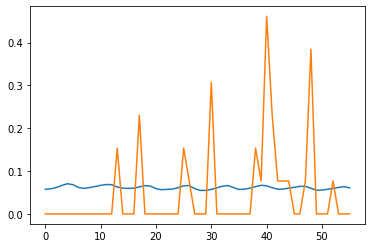

validation 0.0123431785
22_lstm 15 0.012140642


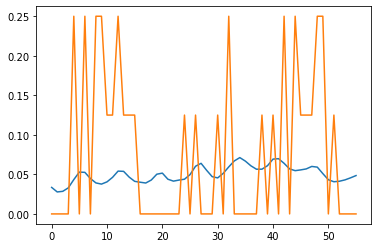

validation 0.0123228375
22_lstm 16 0.012063006


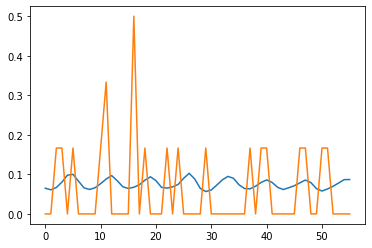

validation 0.012311236
22_lstm 17 0.011375239


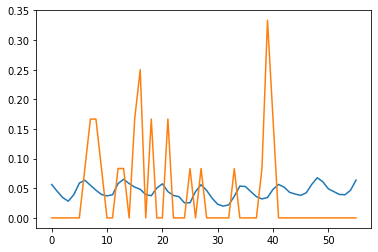

validation 0.012307855
22_lstm 18 0.012235903


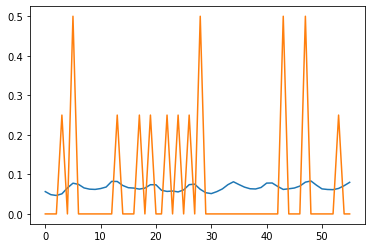

validation 0.012282135
22_lstm 19 0.0120463595


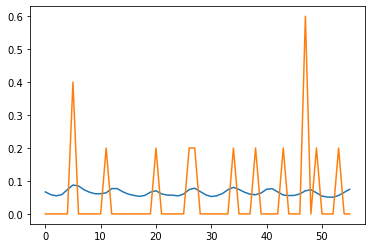

validation 0.012296246
22_lstm 20 0.011893358


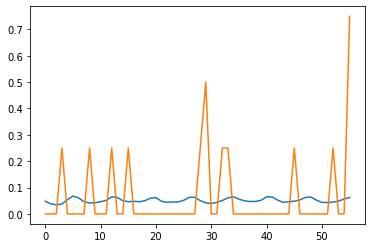

validation 0.012290967
22_lstm 21 0.011996379


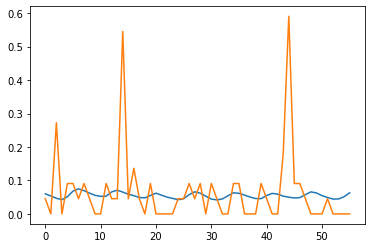

validation 0.012279819
22_lstm 22 0.011625178


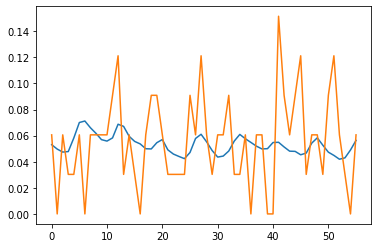

validation 0.01227508
22_lstm 23 0.011962026


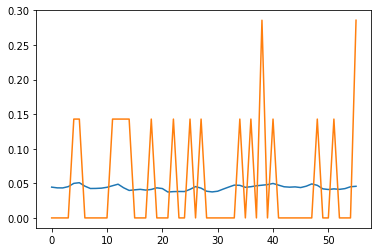

validation 0.012284296
22_lstm 24 0.011655832


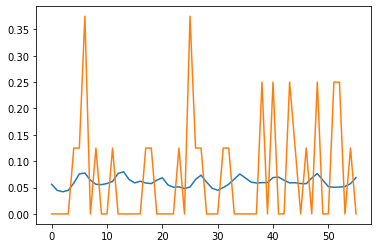

validation 0.012270822
22_lstm 25 0.011700462


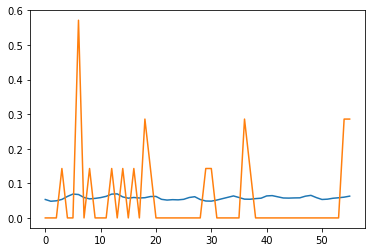

validation 0.012285653
22_lstm 26 0.011761079


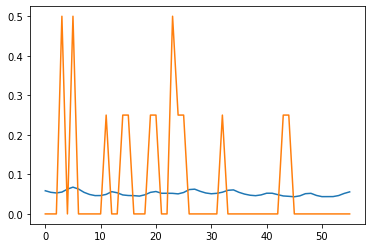

validation 0.012280547
22_lstm 27 0.012045735


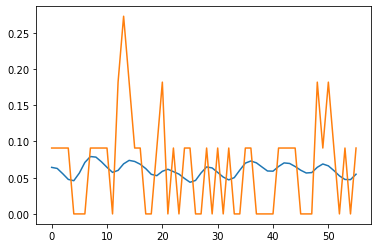

validation 0.012270423
22_lstm 28 0.0117131565


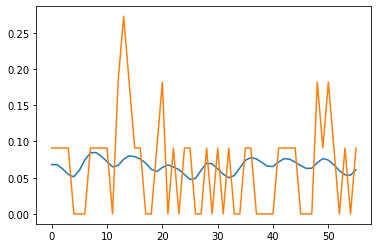

validation 0.0122519005
22_lstm 29 0.0118204495


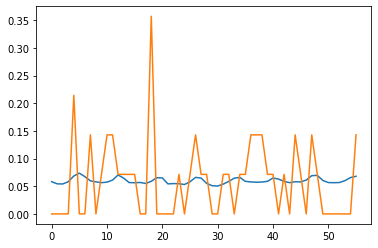

validation 0.012252683
INFO:tensorflow:Assets written to: m5autoreg/model_22_lstm/assets
df shape 1255
starting at 1024
23_lstm 0 0.02084908


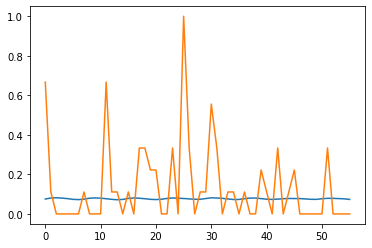

validation 0.025493052
23_lstm 1 0.018997978


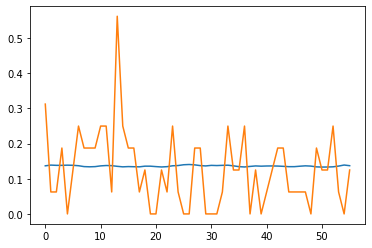

validation 0.02559922
23_lstm 2 0.02026524


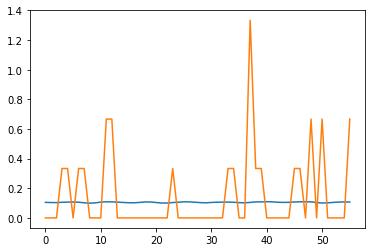

validation 0.025055274
23_lstm 3 0.018797463


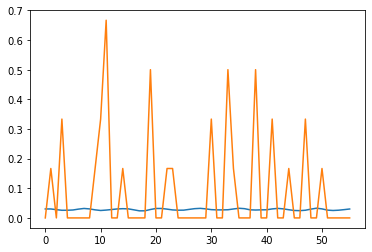

validation 0.024952574
23_lstm 4 0.01934203


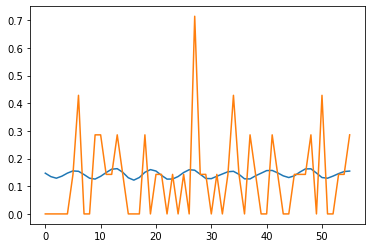

validation 0.024872482
23_lstm 5 0.018174438


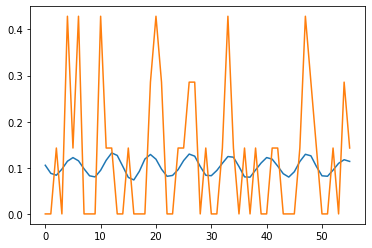

validation 0.024706168
23_lstm 6 0.018758496


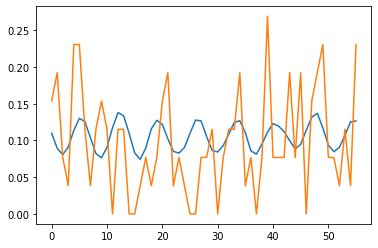

validation 0.024414863
23_lstm 7 0.018607996


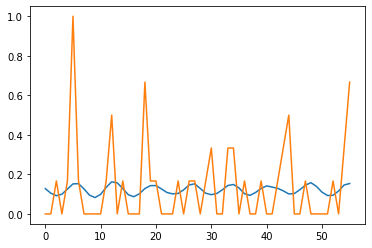

validation 0.024287542
23_lstm 8 0.017603612


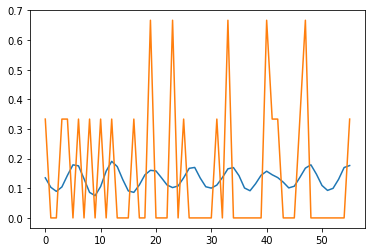

validation 0.023976862
23_lstm 9 0.018994953


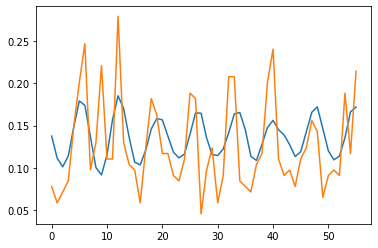

validation 0.023836192
23_lstm 10 0.018891748


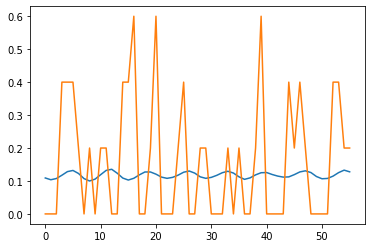

validation 0.023813834
23_lstm 11 0.017559716


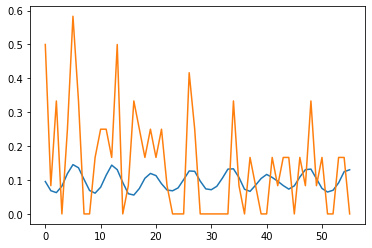

validation 0.02378428
23_lstm 12 0.017552301


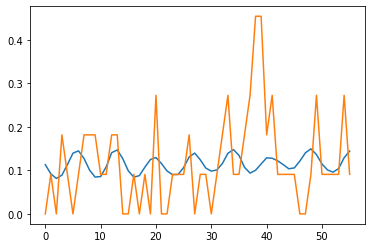

validation 0.023629768
23_lstm 13 0.01747165


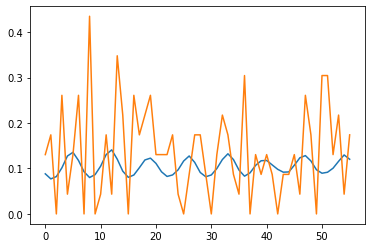

validation 0.023497174
23_lstm 14 0.018028552


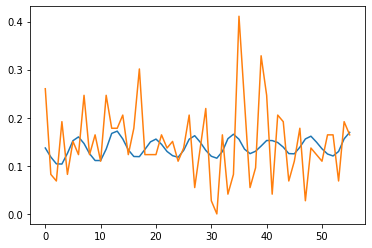

validation 0.023400765
23_lstm 15 0.017578665


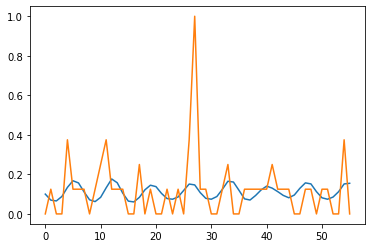

validation 0.023390887
23_lstm 16 0.018922266


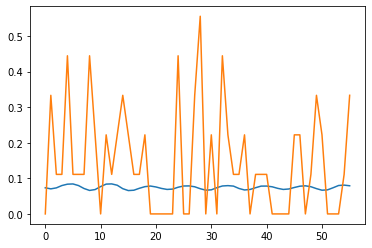

validation 0.0234054
23_lstm 17 0.019071383


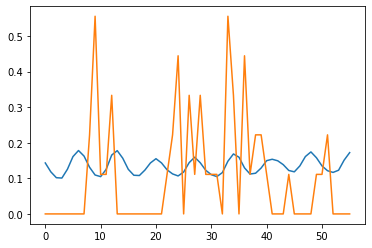

validation 0.023377405
23_lstm 18 0.018001344


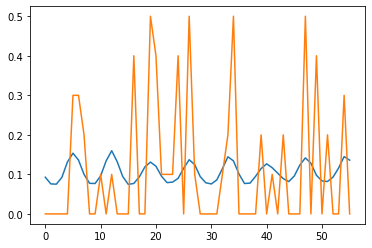

validation 0.023370104
23_lstm 19 0.017716456


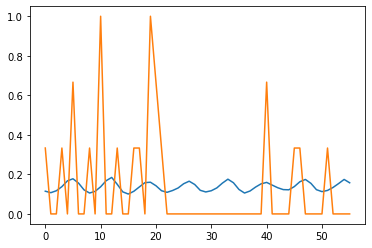

validation 0.023376243
23_lstm 20 0.017320542


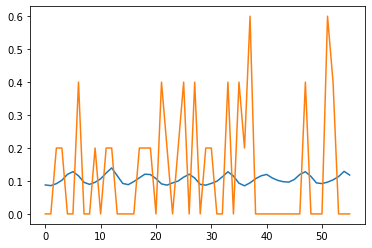

validation 0.023300784
23_lstm 21 0.01796911


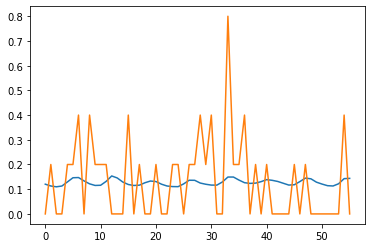

validation 0.023241738
23_lstm 22 0.017891089


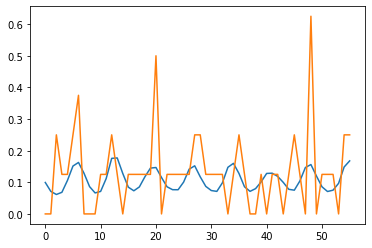

validation 0.02326044
23_lstm 23 0.017341124


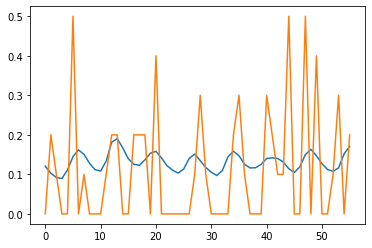

validation 0.023225684
23_lstm 24 0.018939912


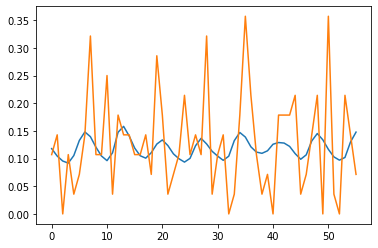

validation 0.023302281
23_lstm 25 0.017475748


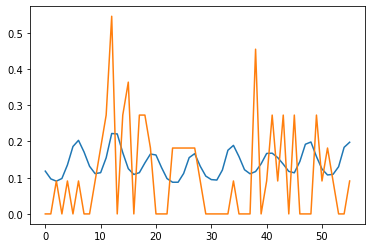

validation 0.023211969
23_lstm 26 0.01709992


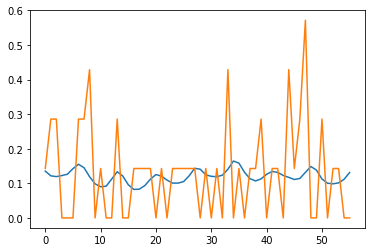

validation 0.023209367
23_lstm 27 0.018265981


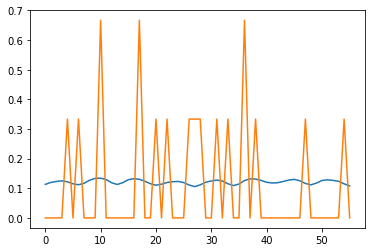

validation 0.023237828
23_lstm 28 0.017164905


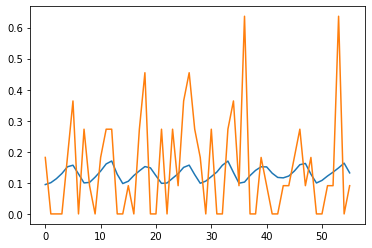

validation 0.023202542
23_lstm 29 0.017590646


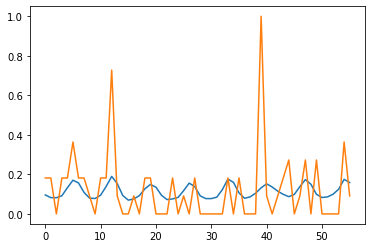

validation 0.02316262
INFO:tensorflow:Assets written to: m5autoreg/model_23_lstm/assets
df shape 696
starting at 1024
24_lstm 0 0.02012992


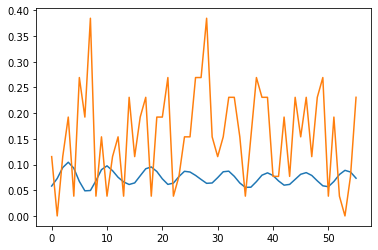

validation 0.032794096
24_lstm 1 0.018935291


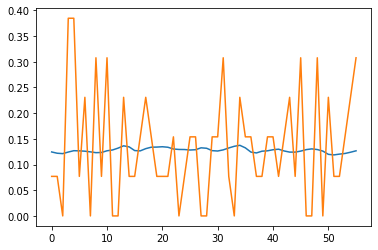

validation 0.031196272
24_lstm 2 0.018855492


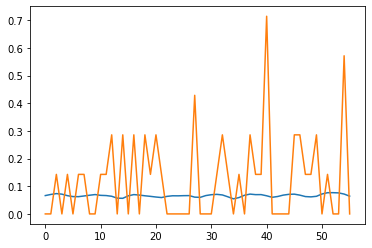

validation 0.030456472
24_lstm 3 0.018573217


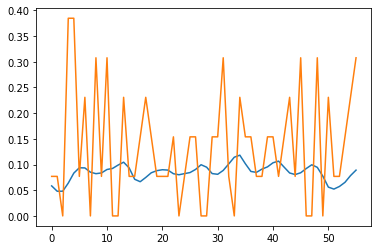

validation 0.029914003
24_lstm 4 0.019157967


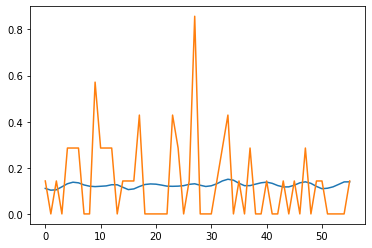

validation 0.029229773
24_lstm 5 0.017968168


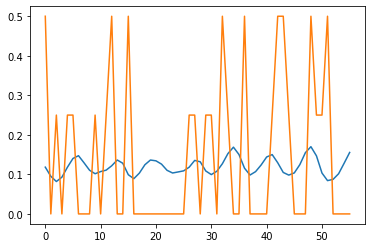

validation 0.028988207
24_lstm 6 0.01811005


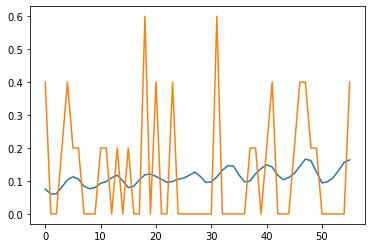

validation 0.02875932
24_lstm 7 0.017255016


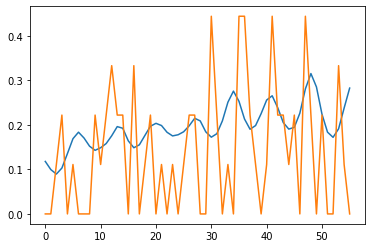

validation 0.028627008
24_lstm 8 0.017711133


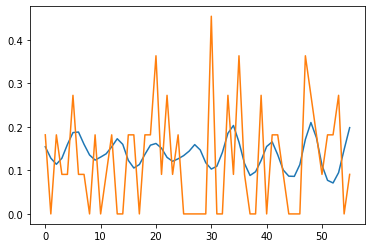

validation 0.028513104
24_lstm 9 0.017385794


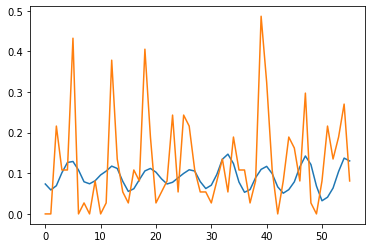

validation 0.028466035
24_lstm 10 0.017239133


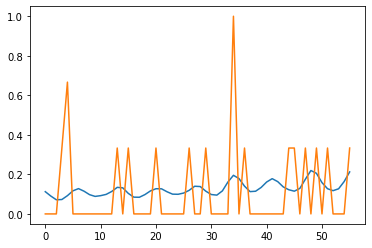

validation 0.028204832
24_lstm 11 0.017588185


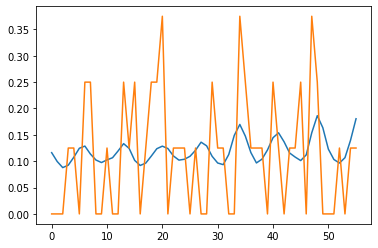

validation 0.028082192
24_lstm 12 0.018142218


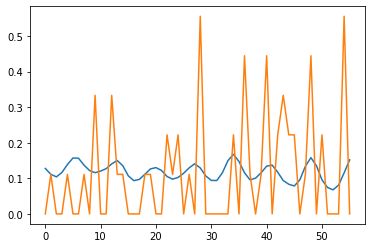

validation 0.028012395
24_lstm 13 0.016254418


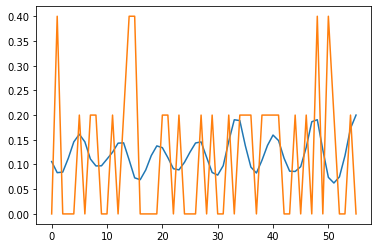

validation 0.027865501
24_lstm 14 0.016443012


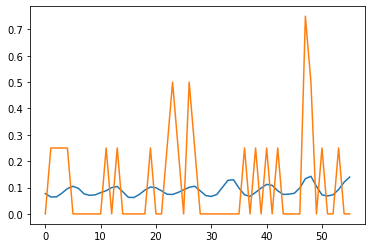

validation 0.027755992
24_lstm 15 0.017761113


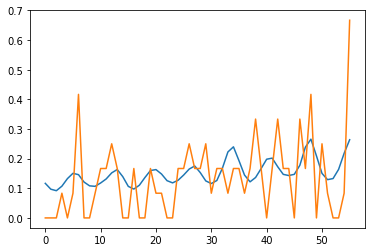

validation 0.027695606
24_lstm 16 0.01724165


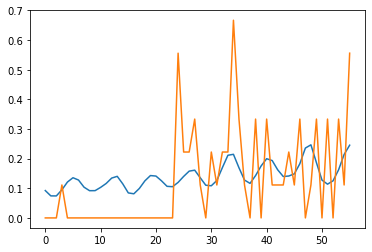

validation 0.027726581
24_lstm 17 0.01735251


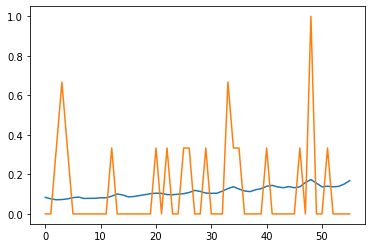

validation 0.027631972
24_lstm 18 0.017030455


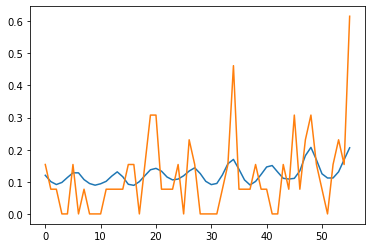

validation 0.027574966
24_lstm 19 0.016094096


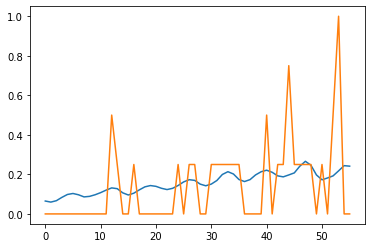

validation 0.027594645
24_lstm 20 0.016807998


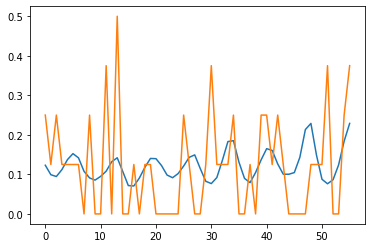

validation 0.02752367
24_lstm 21 0.017065478


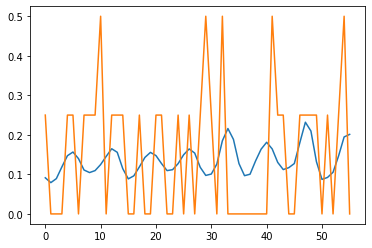

validation 0.027492374
24_lstm 22 0.016194886


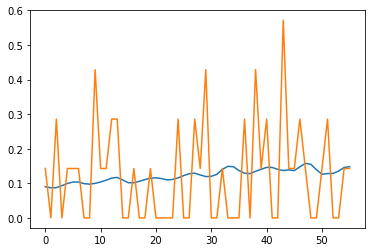

validation 0.027469942
24_lstm 23 0.01704409


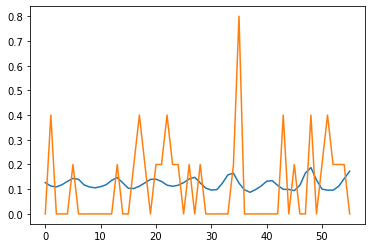

validation 0.02734384
24_lstm 24 0.016480068


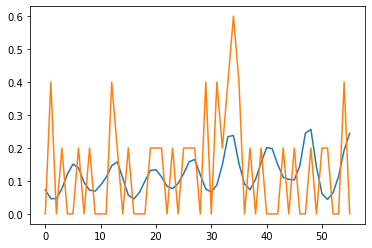

validation 0.027395384
24_lstm 25 0.01757341


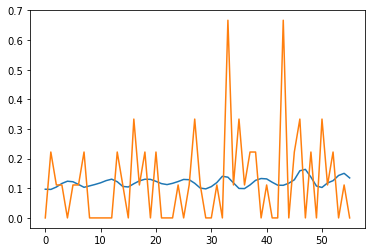

validation 0.027337955
24_lstm 26 0.016738495


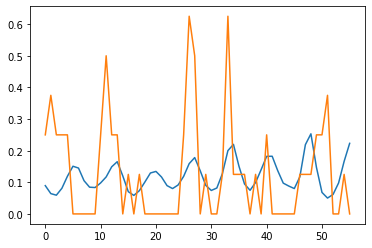

validation 0.027301332
24_lstm 27 0.016966216


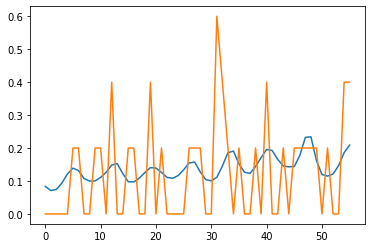

validation 0.027297398
24_lstm 28 0.01739438


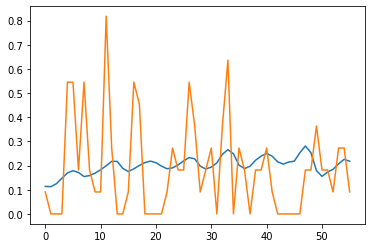

validation 0.0272044
24_lstm 29 0.017483955


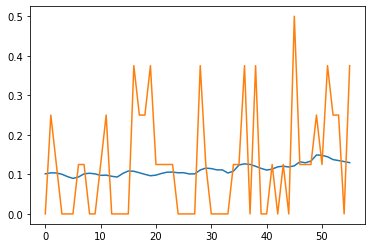

validation 0.027181942
INFO:tensorflow:Assets written to: m5autoreg/model_24_lstm/assets
df shape 17
starting at 1024
25_lstm 0 0.024793005


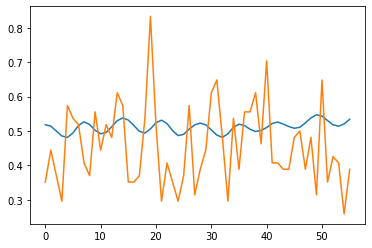

validation 0.038300786
25_lstm 1 0.025920117


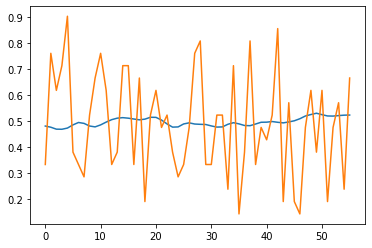

validation 0.03456987
25_lstm 2 0.022845471


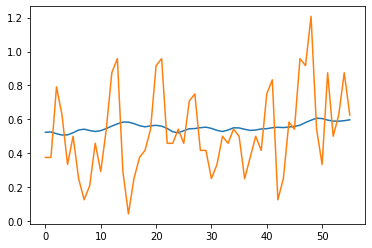

validation 0.034827296
25_lstm 3 0.02199257


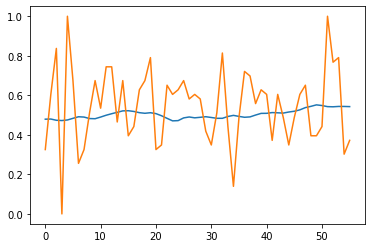

validation 0.0341607
25_lstm 4 0.022165915


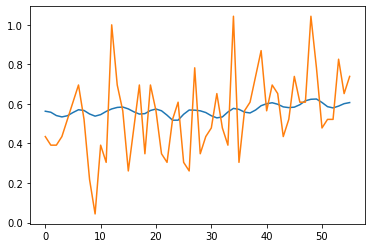

validation 0.032860797
25_lstm 5 0.020953521


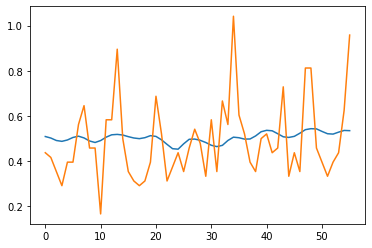

validation 0.033016477
25_lstm 6 0.020214722


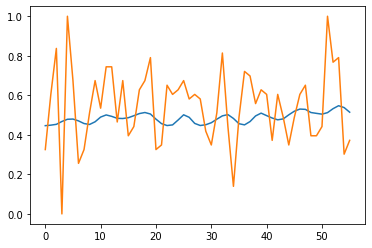

validation 0.032678343
25_lstm 7 0.019907584


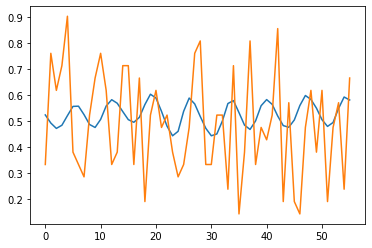

validation 0.03129797
25_lstm 8 0.018354854


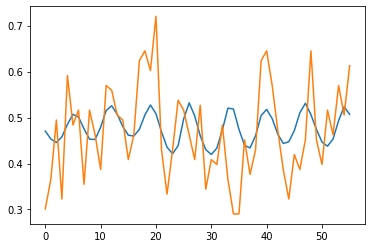

validation 0.030604372
25_lstm 9 0.018349284


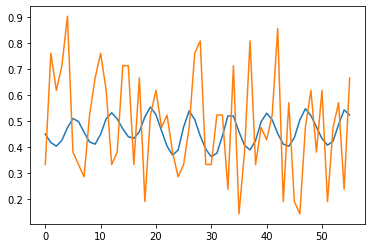

validation 0.03084637
25_lstm 10 0.01910827


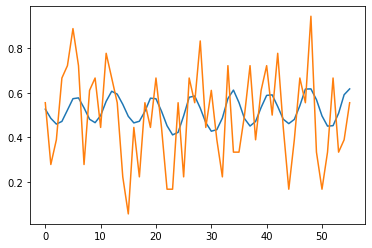

validation 0.02899522
25_lstm 11 0.0178479


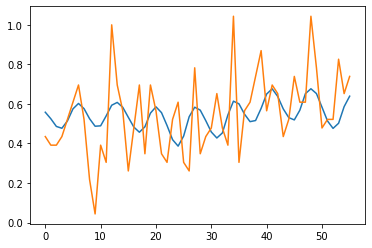

validation 0.028654724
25_lstm 12 0.018768758


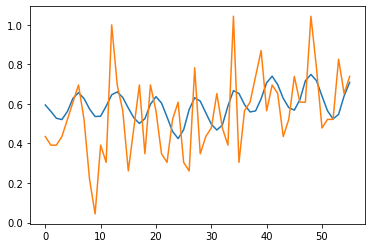

validation 0.028881783
25_lstm 13 0.018150875


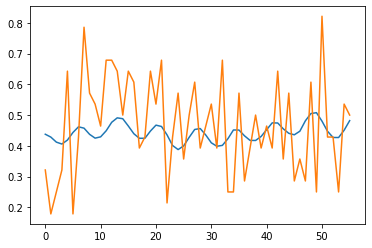

validation 0.029602319
25_lstm 14 0.016257675


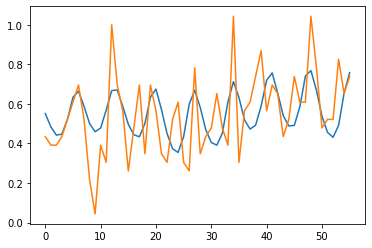

validation 0.02734057
25_lstm 15 0.019530954


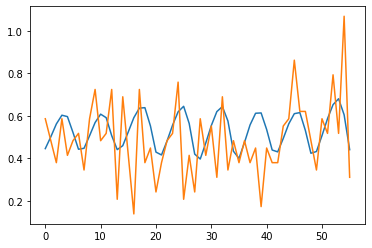

validation 0.027970493
25_lstm 16 0.020636138


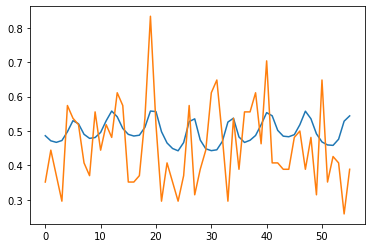

validation 0.027099786
25_lstm 17 0.018515058


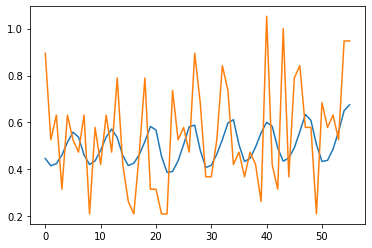

validation 0.027496828
25_lstm 18 0.015894718


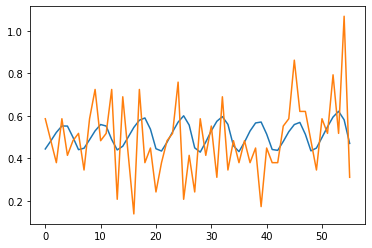

validation 0.027081292
25_lstm 19 0.01704429


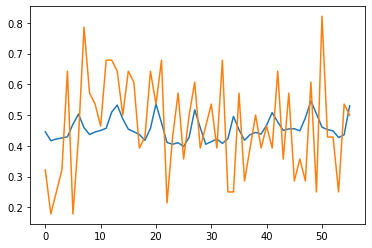

validation 0.026352989
25_lstm 20 0.017857125


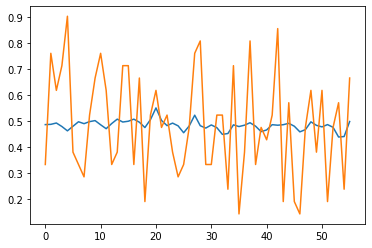

validation 0.028010698
25_lstm 21 0.016024498


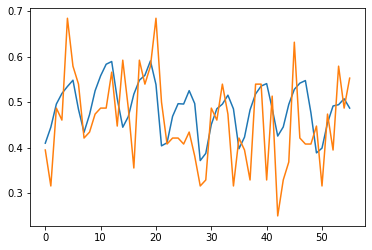

validation 0.028651893
25_lstm 22 0.016204273


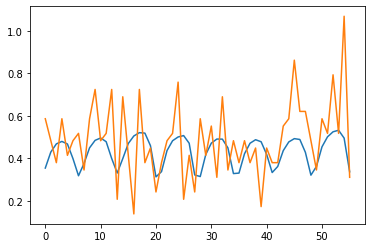

validation 0.026286552
25_lstm 23 0.014637791


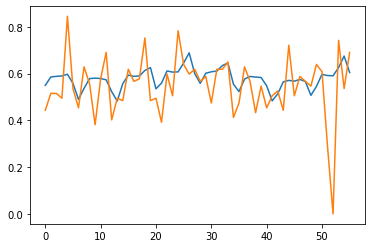

validation 0.025277393
25_lstm 24 0.017664686


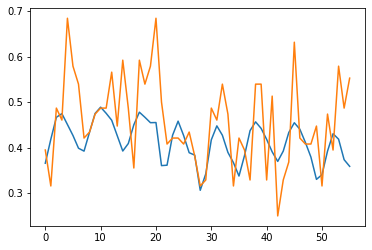

validation 0.02513569
25_lstm 25 0.015154668


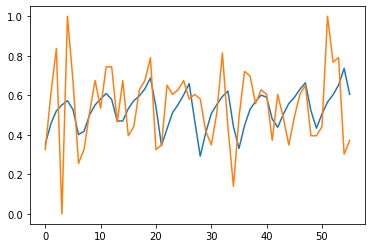

validation 0.025517464
25_lstm 26 0.014921252


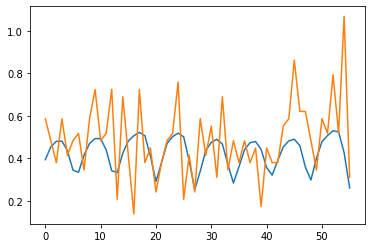

validation 0.025544483
25_lstm 27 0.016122265


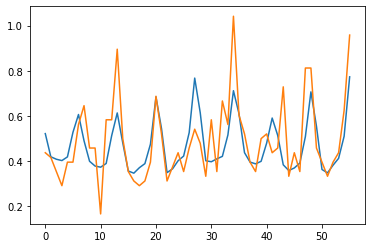

validation 0.024217973
25_lstm 28 0.01406372


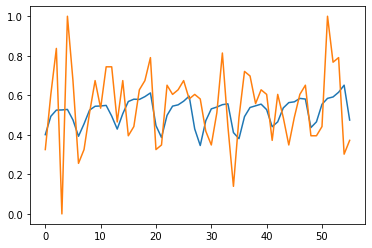

validation 0.023998663
25_lstm 29 0.015489394


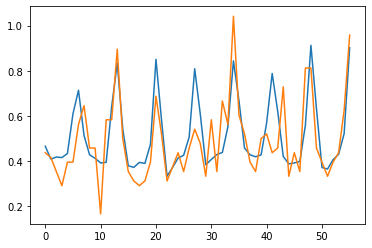

validation 0.02380298
INFO:tensorflow:Assets written to: m5autoreg/model_25_lstm/assets
df shape 634
starting at 1024
26_lstm 0 0.022696098


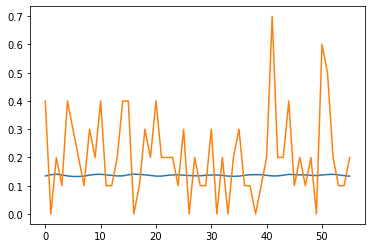

validation 0.035514854
26_lstm 1 0.020876499


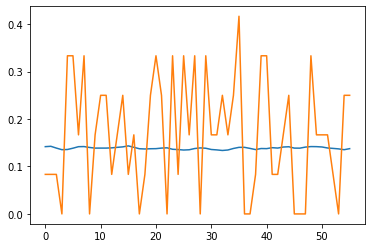

validation 0.033150587
26_lstm 2 0.020973312


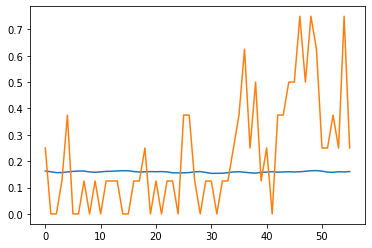

validation 0.0325852
26_lstm 3 0.021092307


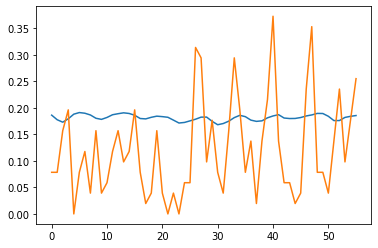

validation 0.032251522
26_lstm 4 0.021623444


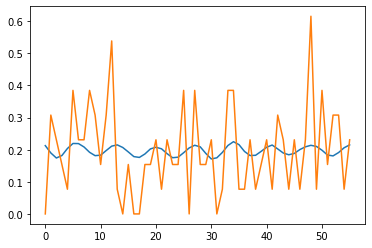

validation 0.03193773
26_lstm 5 0.021472922


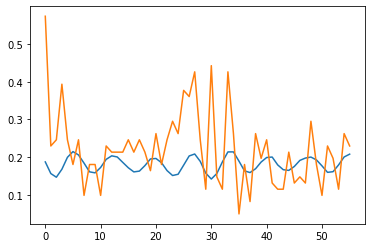

validation 0.031611826
26_lstm 6 0.020827634


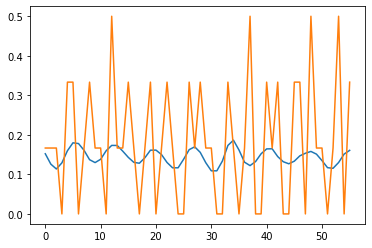

validation 0.031010713
26_lstm 7 0.020233214


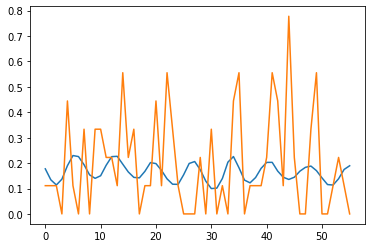

validation 0.03058814
26_lstm 8 0.02026088


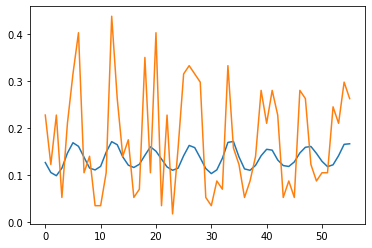

validation 0.030159486
26_lstm 9 0.022162972


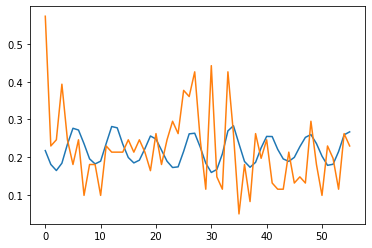

validation 0.030092137
26_lstm 10 0.019222561


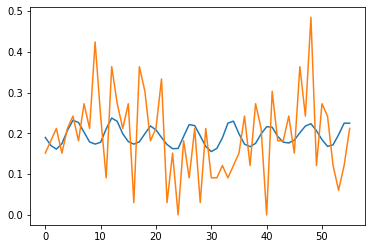

validation 0.02978349
26_lstm 11 0.019871442


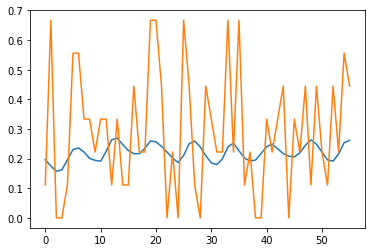

validation 0.029798407
26_lstm 12 0.020808319


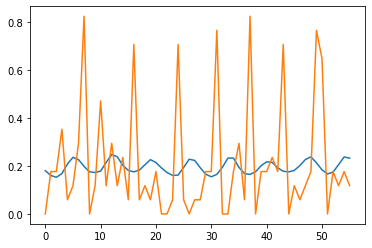

validation 0.02949147
26_lstm 13 0.021056477


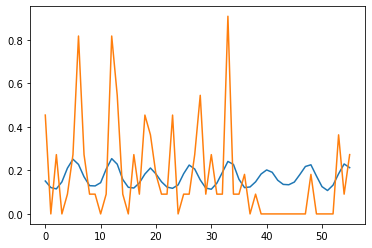

validation 0.0293157
26_lstm 14 0.020331798


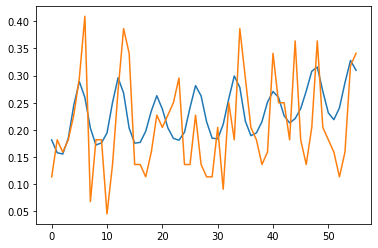

validation 0.028908342
26_lstm 15 0.020589389


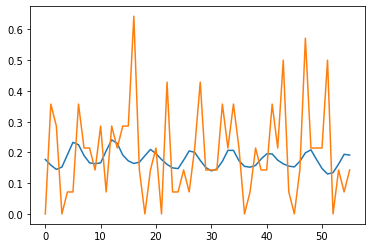

validation 0.028760776
26_lstm 16 0.021277882


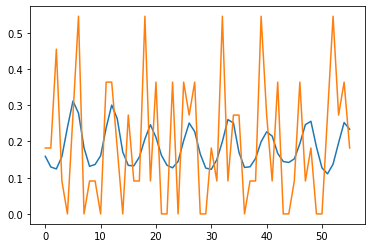

validation 0.0285756
26_lstm 17 0.019730799


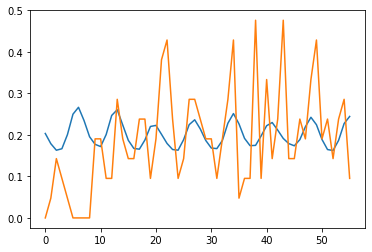

validation 0.028518034
26_lstm 18 0.018889828


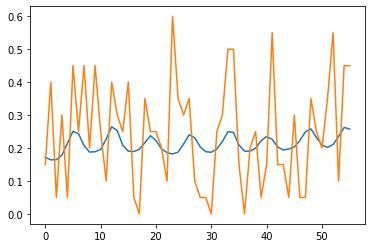

validation 0.028566191
26_lstm 19 0.019150568


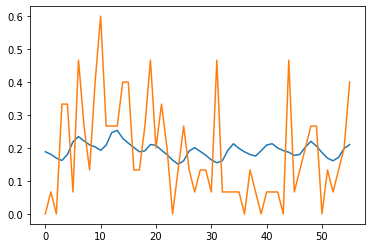

validation 0.028420826
26_lstm 20 0.01900064


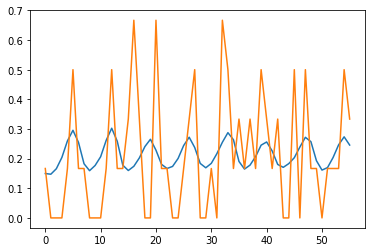

validation 0.0282564
26_lstm 21 0.018627362


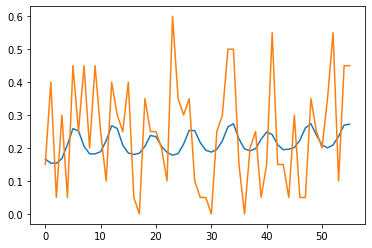

validation 0.028196117
26_lstm 22 0.020224078


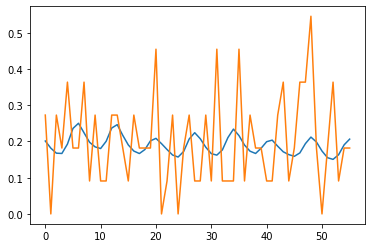

validation 0.028107414
26_lstm 23 0.019235944


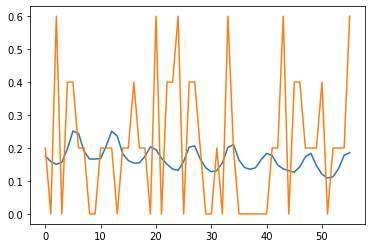

validation 0.028111761
26_lstm 24 0.020029683


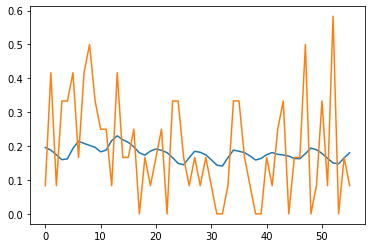

validation 0.028008366
26_lstm 25 0.018029531


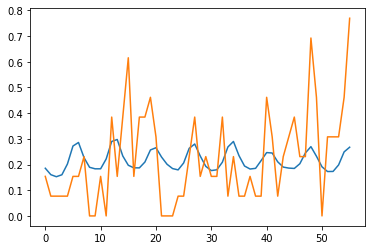

validation 0.027958209
26_lstm 26 0.019705014


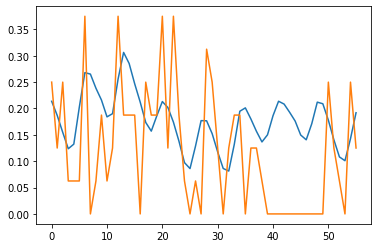

validation 0.027963715
26_lstm 27 0.019426394


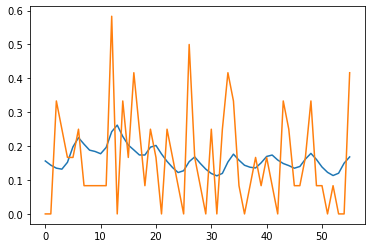

validation 0.027862573
26_lstm 28 0.01827031


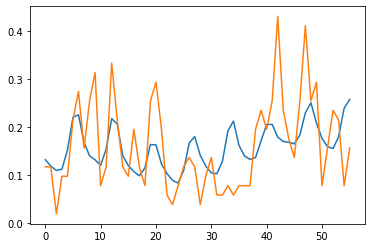

validation 0.027784957
26_lstm 29 0.018181942


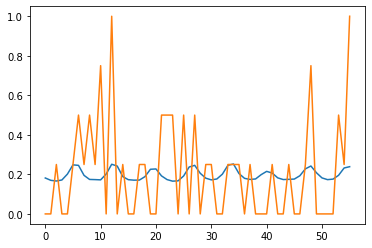

validation 0.027784334
INFO:tensorflow:Assets written to: m5autoreg/model_26_lstm/assets
df shape 1771
starting at 1024
27_lstm 0 0.014993198


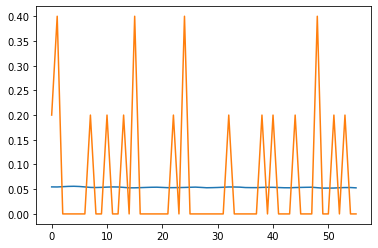

validation 0.018214345
27_lstm 1 0.014764035


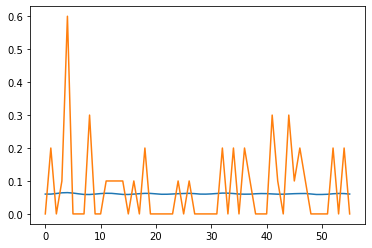

validation 0.018196119
27_lstm 2 0.015267582


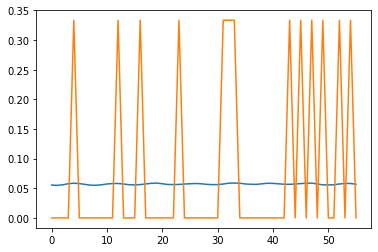

validation 0.018120022
27_lstm 3 0.014913304


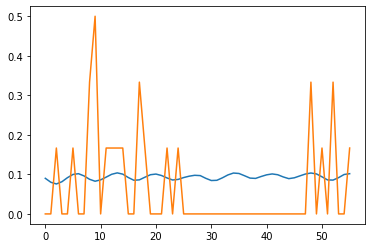

validation 0.018023858
27_lstm 4 0.013679018


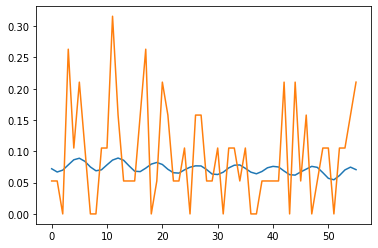

validation 0.018037796
27_lstm 5 0.01478962


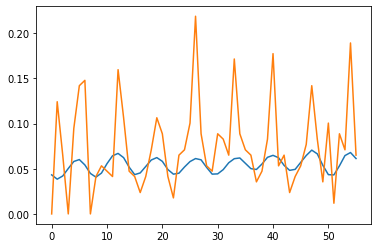

validation 0.017975757
27_lstm 6 0.0132560255


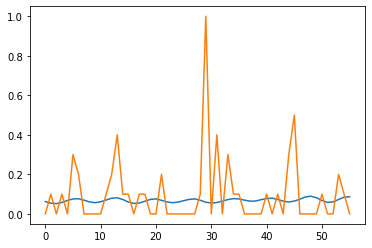

validation 0.01769787
27_lstm 7 0.014246784


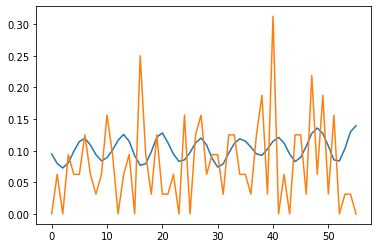

validation 0.017500978
27_lstm 8 0.013299661


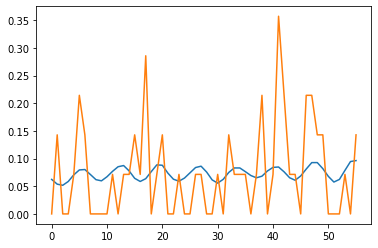

validation 0.017393887
27_lstm 9 0.014006789


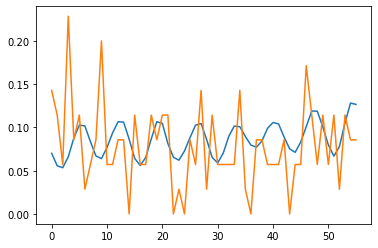

validation 0.017378937
27_lstm 10 0.014069009


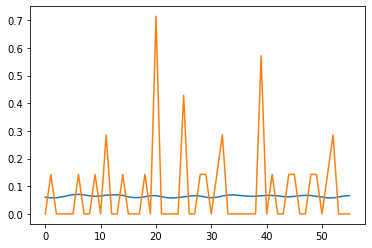

validation 0.017341103
27_lstm 11 0.013861935


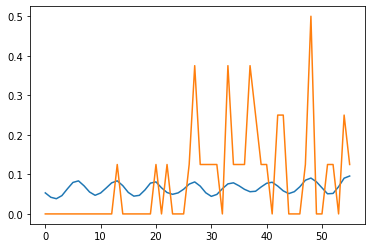

validation 0.01728903
27_lstm 12 0.0141509725


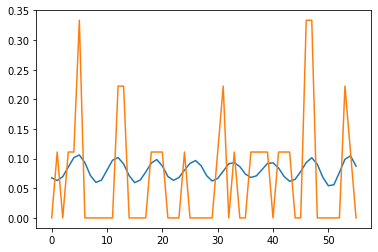

validation 0.017280217
27_lstm 13 0.013592477


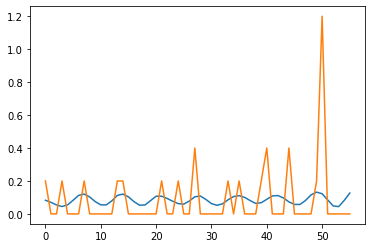

validation 0.017187493
27_lstm 14 0.013517017


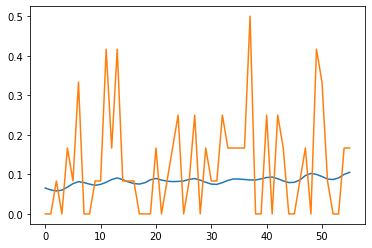

validation 0.017193124
27_lstm 15 0.014398509


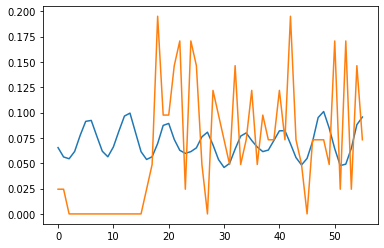

validation 0.01714535
27_lstm 16 0.013639124


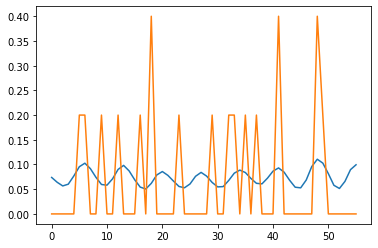

validation 0.01709813
27_lstm 17 0.013268744


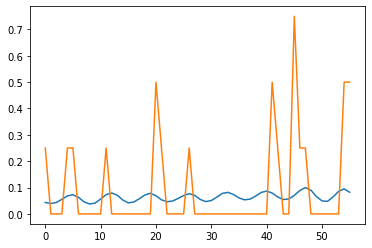

validation 0.017029837
27_lstm 18 0.013637164


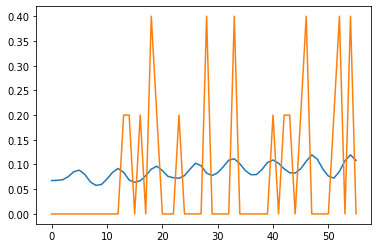

validation 0.017040338
27_lstm 19 0.013843509


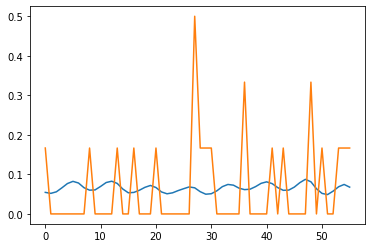

validation 0.017016986
27_lstm 20 0.013829917


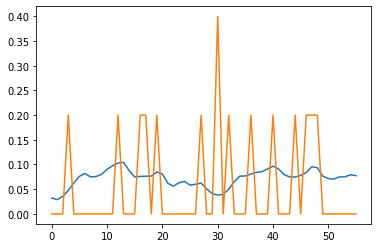

validation 0.01693567
27_lstm 21 0.01319388


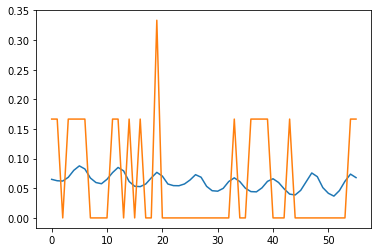

validation 0.016940976
27_lstm 22 0.014149788


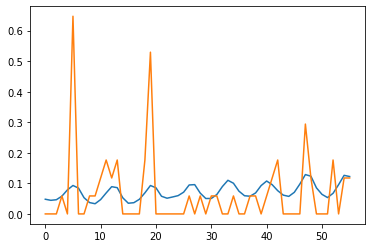

validation 0.016887365
27_lstm 23 0.013430292


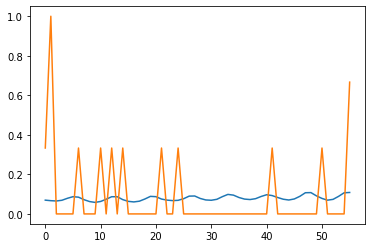

validation 0.016840523
27_lstm 24 0.013651354


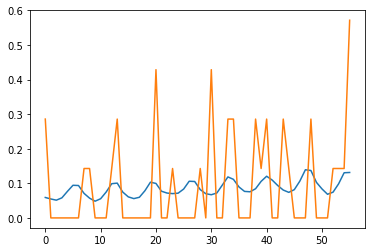

validation 0.016789626
27_lstm 25 0.013407434


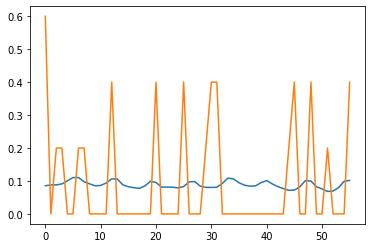

validation 0.016764577
27_lstm 26 0.013657859


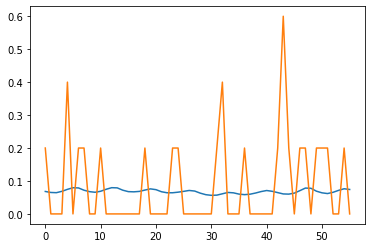

validation 0.016792914
27_lstm 27 0.01331101


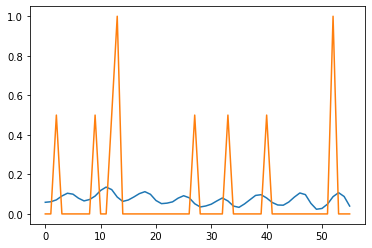

validation 0.016739596
27_lstm 28 0.013725227


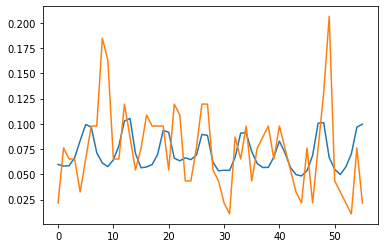

validation 0.016692827
27_lstm 29 0.013766097


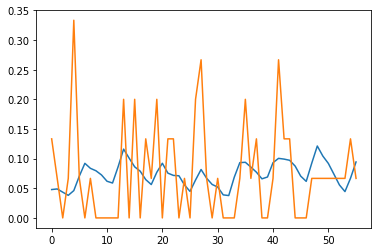

validation 0.01668916
INFO:tensorflow:Assets written to: m5autoreg/model_27_lstm/assets
df shape 333
starting at 1024
28_lstm 0 0.026899252


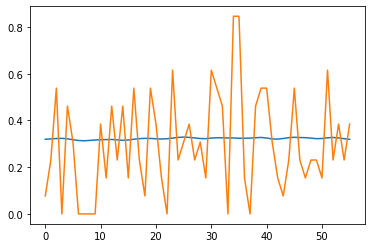

validation 0.043123014
28_lstm 1 0.027574603


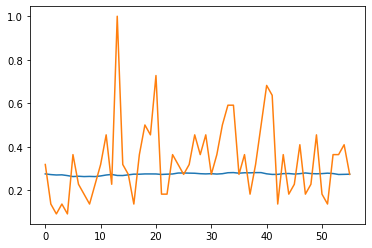

validation 0.040674593
28_lstm 2 0.02462223


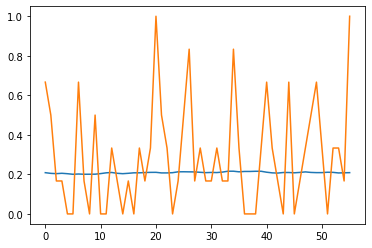

validation 0.039777573
28_lstm 3 0.025035053


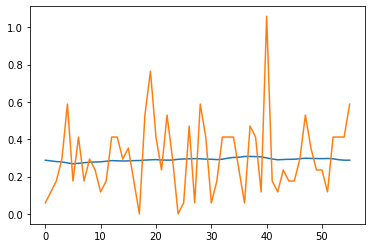

validation 0.03908038
28_lstm 4 0.023996456


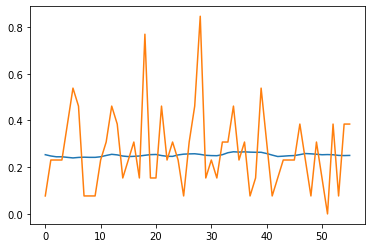

validation 0.037996065
28_lstm 5 0.024172774


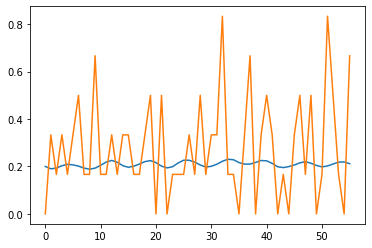

validation 0.037001718
28_lstm 6 0.02270709


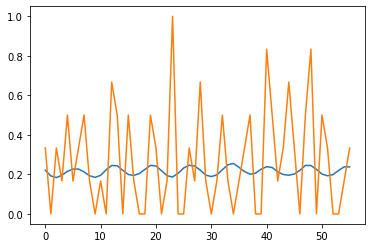

validation 0.036390234
28_lstm 7 0.024134286


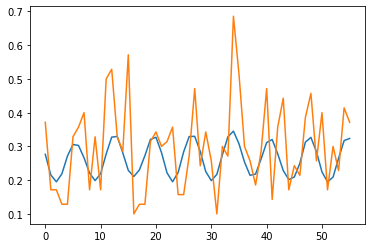

validation 0.035146464
28_lstm 8 0.022086814


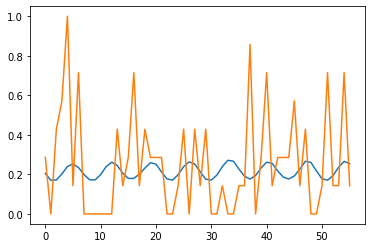

validation 0.035030693
28_lstm 9 0.02234951


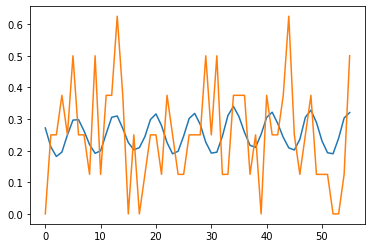

validation 0.034498762
28_lstm 10 0.023013396


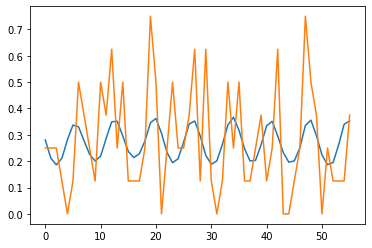

validation 0.034479193
28_lstm 11 0.021737177


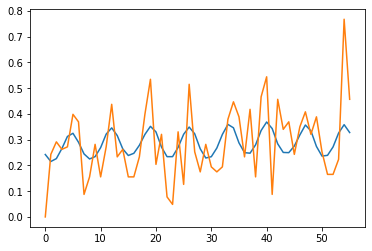

validation 0.03411742
28_lstm 12 0.021786302


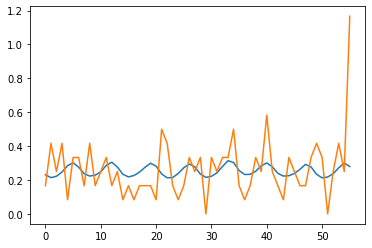

validation 0.033911493
28_lstm 13 0.022961102


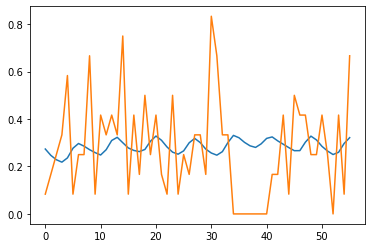

validation 0.033801924
28_lstm 14 0.022278845


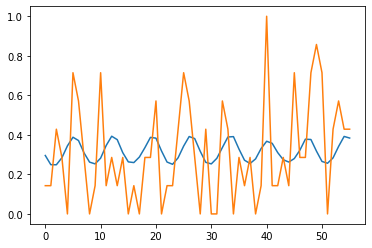

validation 0.033938568
28_lstm 15 0.02143618


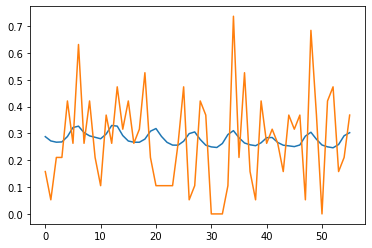

validation 0.033674907
28_lstm 16 0.022032741


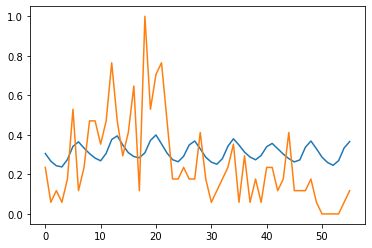

validation 0.03357499
28_lstm 17 0.02169649


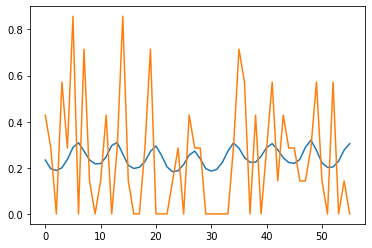

validation 0.033367123
28_lstm 18 0.021815117


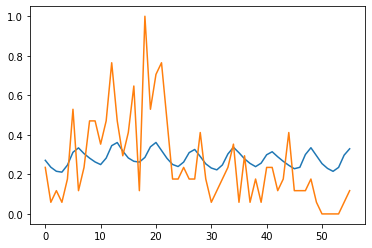

validation 0.03327411
28_lstm 19 0.019954134


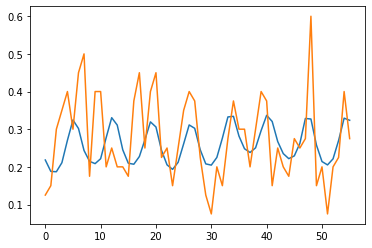

validation 0.033484012
28_lstm 20 0.020306641


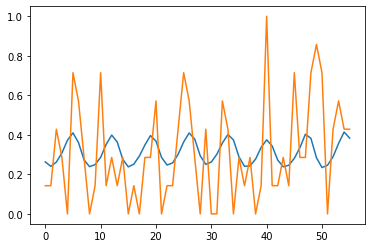

validation 0.033161514
28_lstm 21 0.021384079


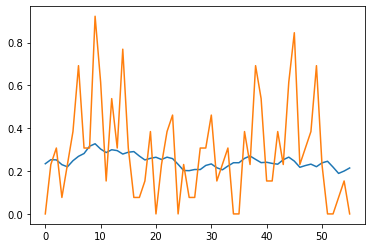

validation 0.032976467
28_lstm 22 0.020621905


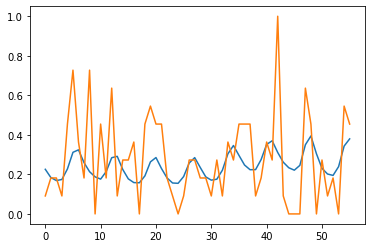

validation 0.032959044
28_lstm 23 0.018483289


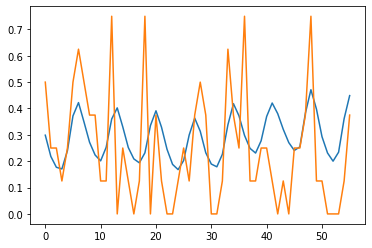

validation 0.03289075
28_lstm 24 0.021708893


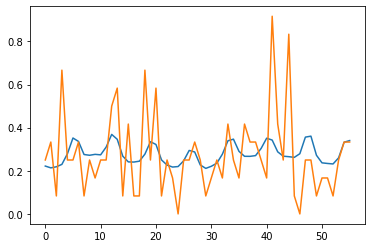

validation 0.032491524
28_lstm 25 0.018859811


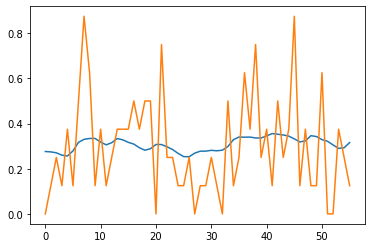

validation 0.03235011
28_lstm 26 0.020162648


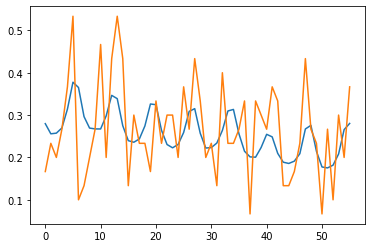

validation 0.032189287
28_lstm 27 0.020601189


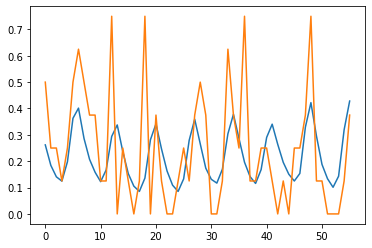

validation 0.031772245
28_lstm 28 0.02012733


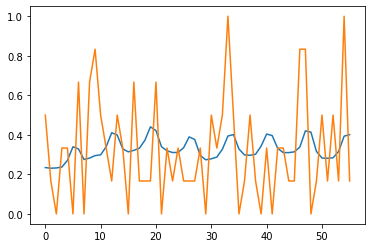

validation 0.031678587
28_lstm 29 0.020350084


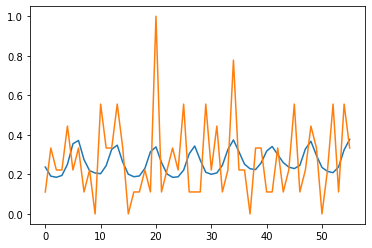

validation 0.031651124
INFO:tensorflow:Assets written to: m5autoreg/model_28_lstm/assets
df shape 834
starting at 1024
29_lstm 0 0.024830198


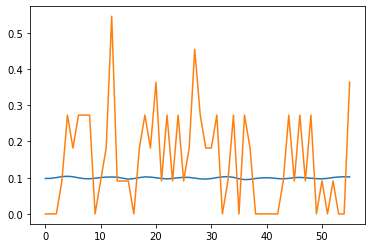

validation 0.030372653
29_lstm 1 0.023498233


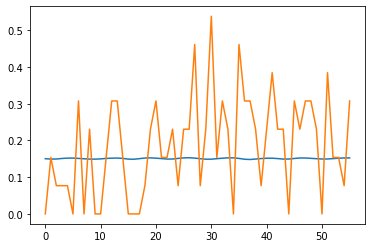

validation 0.02954788
29_lstm 2 0.021955654


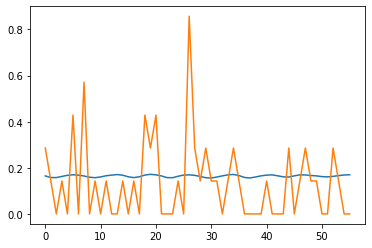

validation 0.028541137
29_lstm 3 0.020439176


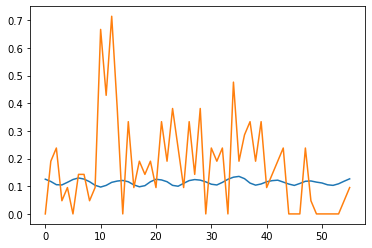

validation 0.028267473
29_lstm 4 0.021292757


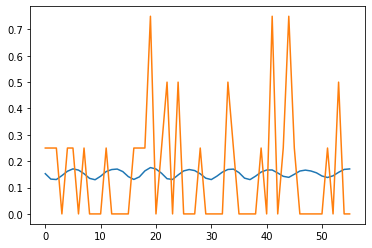

validation 0.02817656
29_lstm 5 0.02152539


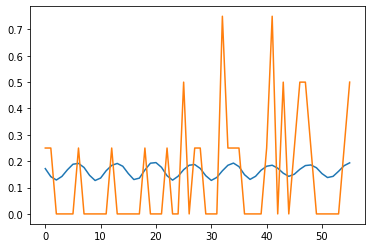

validation 0.027950453
29_lstm 6 0.021960119


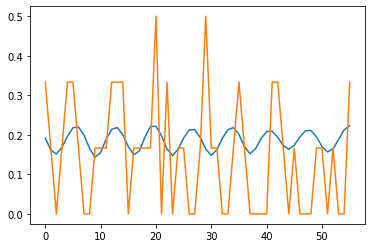

validation 0.027933476
29_lstm 7 0.021178665


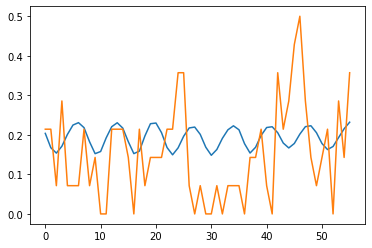

validation 0.027673047
29_lstm 8 0.022305587


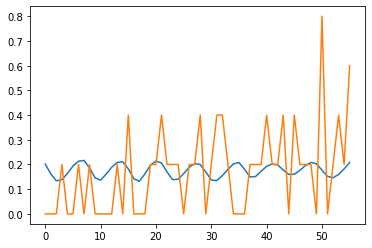

validation 0.027374348
29_lstm 9 0.019877462


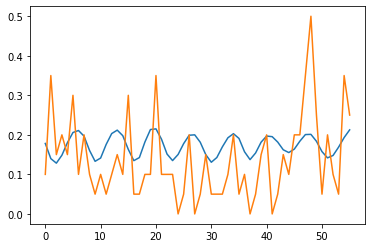

validation 0.027066836
29_lstm 10 0.019403448


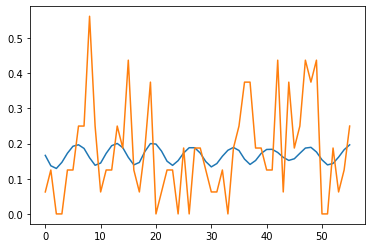

validation 0.026977858
29_lstm 11 0.020002736


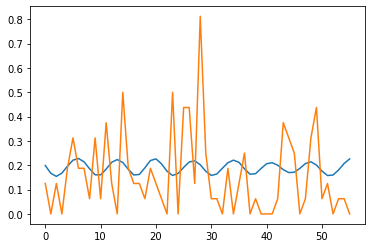

validation 0.02686255
29_lstm 12 0.019508194


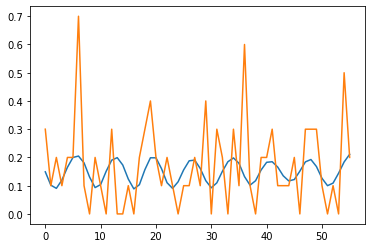

validation 0.027034657
29_lstm 13 0.021061977


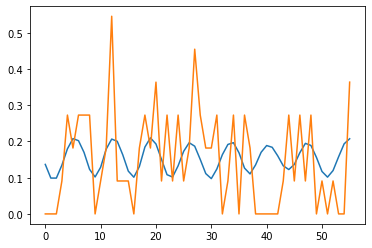

validation 0.026866406
29_lstm 14 0.020821495


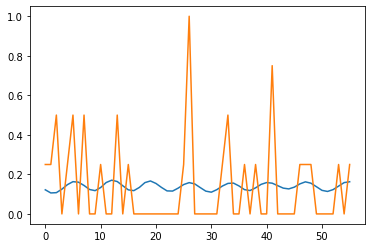

validation 0.026864016
29_lstm 15 0.021121912


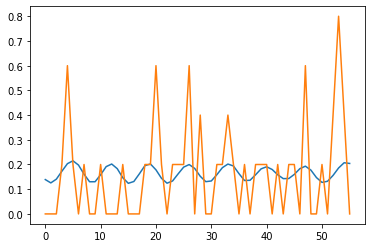

validation 0.026854992
29_lstm 16 0.019522024


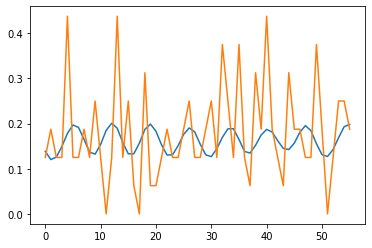

validation 0.026749274
29_lstm 17 0.020925906


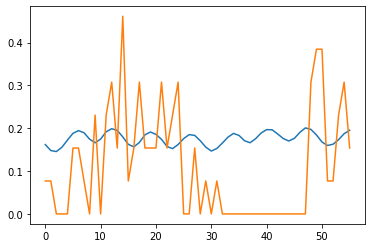

validation 0.026724273
29_lstm 18 0.019670088


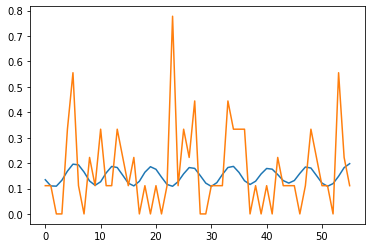

validation 0.02657192
29_lstm 19 0.020980831


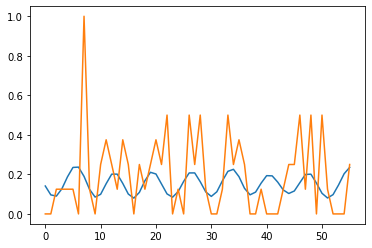

validation 0.026538905
29_lstm 20 0.020257017


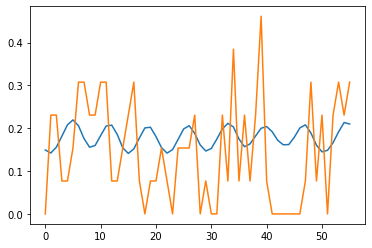

validation 0.026437666
29_lstm 21 0.019251319


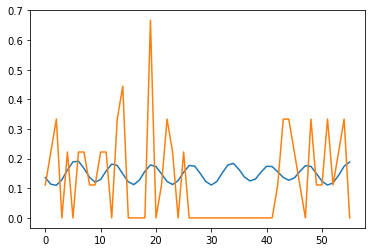

validation 0.026445106
29_lstm 22 0.020322831


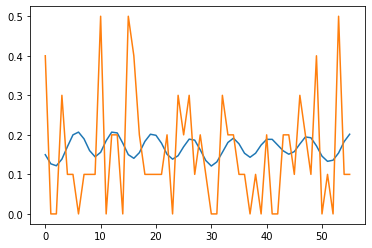

validation 0.026417077
29_lstm 23 0.01972961


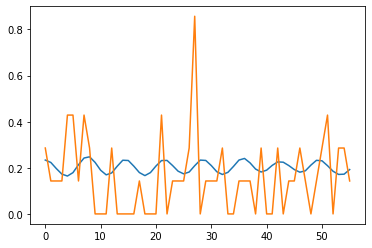

validation 0.026378097
29_lstm 24 0.01908738


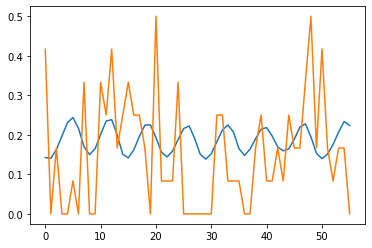

validation 0.026315188
29_lstm 25 0.019698808


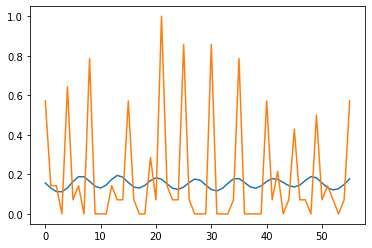

validation 0.026264967
29_lstm 26 0.018758634


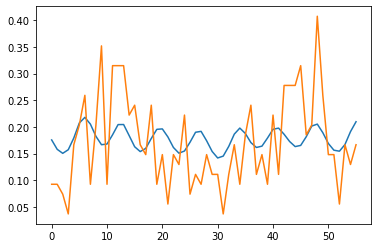

validation 0.026287565
29_lstm 27 0.018542722


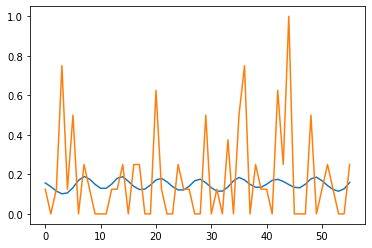

validation 0.026244279
29_lstm 28 0.019414188


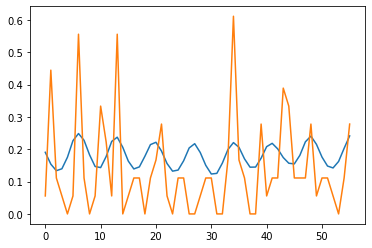

validation 0.026098099
29_lstm 29 0.018587943


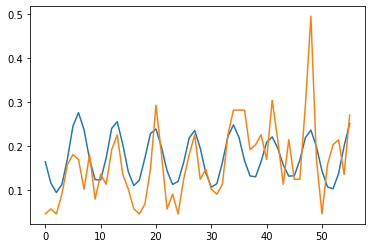

validation 0.02620348
INFO:tensorflow:Assets written to: m5autoreg/model_29_lstm/assets


In [79]:
import time

for clstrid in range(0,30):
    size = df_norm[(clstrs==clstrid)].shape[0]
    print('df shape',size)
    model = create_model(df_norm[(clstrs==clstrid)].shape[0],
                                layer_sizes=[128,256])

    model_id = str(clstrid)+'_lstm'
    train(df_norm[(clstrs==clstrid)],model,model_id,30)

    tf.keras.backend.clear_session()

In [102]:
#look at price changes
diff = price_series['d_1969']-price_series['d_1967']

In [103]:
pd.set_option('display.max_rows', 515)
price_series[(price_series.id.apply(lambda x: 'HOUSEHOLD_2' in x and 'WI_3' in x))&(diff>0)]

d,id,d_1,d_2,d_3,d_4,d_5,d_6,d_7,d_8,d_9,...,d_1960,d_1961,d_1962,d_1963,d_1964,d_1965,d_1966,d_1967,d_1968,d_1969
28299,HOUSEHOLD_2_297_WI_3,5.47,5.47,5.47,5.47,5.47,5.47,5.47,5.47,5.47,...,2.5,2.5,2.5,2.5,2.5,2.5,2.5,2.5,6.54,6.54


In [98]:
price_series[price_series.id=='HOUSEHOLD_2_297_WI_3']

d,id,d_1,d_2,d_3,d_4,d_5,d_6,d_7,d_8,d_9,...,d_1960,d_1961,d_1962,d_1963,d_1964,d_1965,d_1966,d_1967,d_1968,d_1969
28299,HOUSEHOLD_2_297_WI_3,5.47,5.47,5.47,5.47,5.47,5.47,5.47,5.47,5.47,...,2.5,2.5,2.5,2.5,2.5,2.5,2.5,2.5,6.54,6.54


In [80]:
import gc
gc.collect()

169924

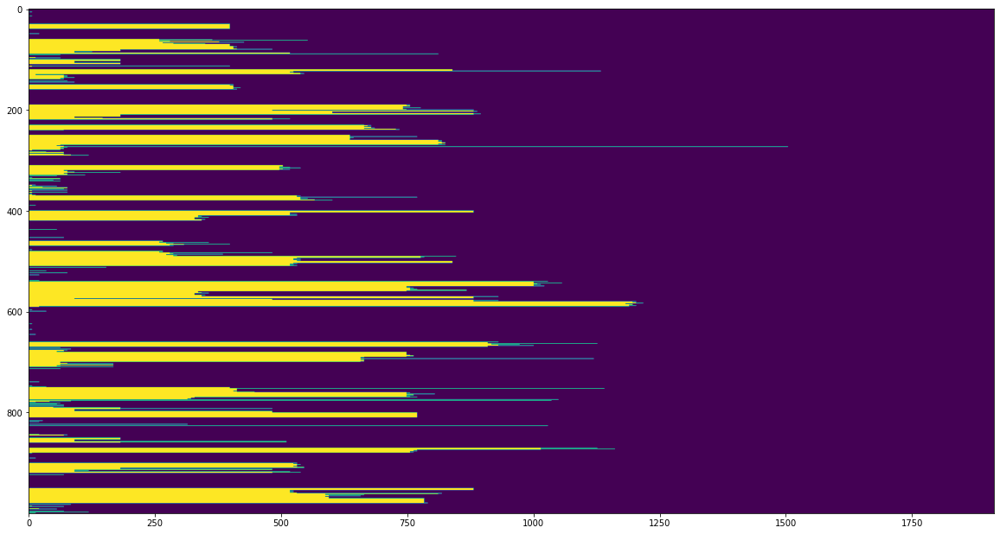

In [132]:
plt.figure(figsize=(20,20))
plt.imshow(no_sales[features].values[:1000])

In [99]:
#number of training dataset samples
N+28

1941

In [ ]:
# train(store_cat_df,model_store_cat,store_cat_wm,0,10)
# train(item_df,model_item,item_wm,1,5)
# train(state_dept_df,model_state_dept,state_dep_wm,2,5)

In [104]:
def forecast_v2(modelid,dfx,start,num_obs):
                
    _cat_ = []
    _tmi_ = []
    _y_ = []
    
    model = tf.keras.models.load_model('m5autoreg/model_'+modelid)

    
    tmi = dfx[get_prev_48_days(start)]    

    far_see = tmi.T.values.astype(np.float32)
    tmi = tmi.T.values.astype(np.float32)

    
    losses = []
    for day in np.arange(start-28,start+num_obs):
        


        tmi_48 = tmi[-48:]
        tmi_48 = tmi_48.astype(np.float32)

        feat = np.expand_dims(tmi_48,axis=0)


        inp = [feat]
        
        pred = model.predict(inp)
        

        wkday = prices[prices.d.isin(get_next_1_days(day))].wday.values[0]
        days_ = prices[prices.wday==wkday].d.values
        subset = dfx[prices[prices.d.isin(all_features)&prices.d.isin(days_)&prices.year.isin([2016])].d.values.flatten()]
        mu = np.nanmean(subset.values,axis=1).reshape(1,-1)

        if day<start:
            continue

        far_see = np.concatenate([far_see,pred],axis=0)

        if day<1941:
            y = dfx[get_next_1_days(day)].values.astype(np.float32).reshape(1,-1)
            losses.append((pred-y)**2)
            pred = y
        else:
            pred = mu
        

        
        tmi = np.concatenate([tmi,pred],axis=0)

        


        
    print(np.mean(losses))
    
    return far_see[-num_obs:]


# pred_store_cat,actual_store_cat = predict(model_store_cat,store_cat_df,N,56)
# pred_item,actual_item = predict(model_item,item_df,N,56)
# pred_state_dept,actual_state_dept = predict(model_state_dept,state_dept_df,N,56)

In [92]:
N=len(features)
submission = pd.read_csv('m5-forecasting-accuracy/sample_submission.csv')

F = []
for i in range(1,29):
    F.append('F'+str(i))


days=len(prices)

submission_list = []


for clstrid in range(0,30):
    size = df_norm[(clstrs==clstrid)].shape[0]
    modelid = str(clstrid)+'_lstm'
    print(modelid)

    dfx = df_norm[(clstrs==clstrid)].copy().reset_index(drop=True)
    mask = ((clstrs==clstrid)).flatten()

    y_pred = forecast_v2(modelid,dfx,N,28*2)
    y_pred = y_pred*(_max_[mask].T-_min_[mask].T) + _min_[mask].T
    y_pred = np.clip(y_pred,_min_[mask].T,_max_[mask].T)


    idcolval = dfx.id.apply(lambda x: str(x)+'_validation')
    idcoleva = dfx.id.apply(lambda x: str(x)+'_evaluation')


    y_pred = y_pred.T

    submission_val = pd.DataFrame(data=y_pred[:,:28],columns=F,index=idcolval)
    submission_eva = pd.DataFrame(data=y_pred[:,28:56],columns=F,index=idcoleva)

    submission_list.append(submission_val)
    submission_list.append(submission_eva)

    
submission = pd.concat(submission_list,axis=0).reset_index()

clstr_submission = submission.copy()

clstr_submission.to_csv('clstr_submission.csv',index=False)



0_lstm
0.024987716
1_lstm
0.0076234736
2_lstm
0.03157251
3_lstm
0.017982343
4_lstm
0.0024214392
5_lstm
0.02669857
6_lstm
0.03067015
7_lstm
0.03203204
8_lstm
0.019146243
9_lstm
0.017236818
10_lstm
0.0054203835
11_lstm
0.033493564
12_lstm
0.031606212
13_lstm
0.012158836
14_lstm
0.033466592
15_lstm
0.02379784
16_lstm
0.031276412
17_lstm
0.010427605
18_lstm
0.03375766
19_lstm
0.033625837
20_lstm
0.019936252
21_lstm
0.013541203
22_lstm
0.011905035
23_lstm
0.023329329
24_lstm
0.03064379
25_lstm
0.024655357
26_lstm
0.027563184
27_lstm
0.017578077
28_lstm
0.032320943
29_lstm
0.026488557


HOBBIES_1_001_CA_1


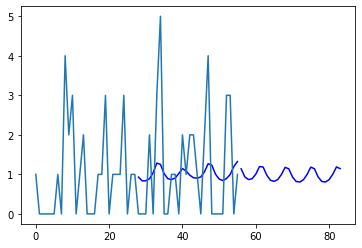

HOBBIES_1_002_CA_1


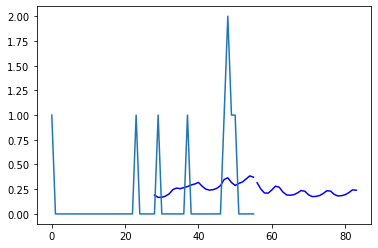

HOBBIES_1_003_CA_1


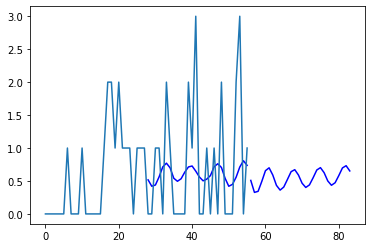

HOBBIES_1_004_CA_1


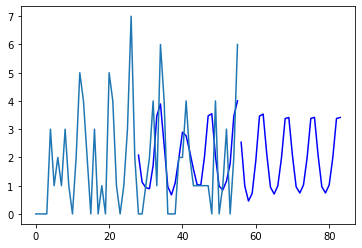

HOBBIES_1_005_CA_1


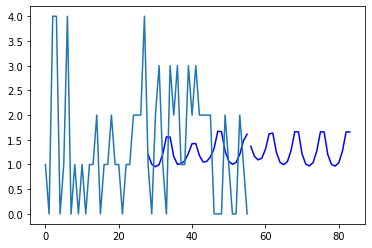

HOBBIES_1_006_CA_1


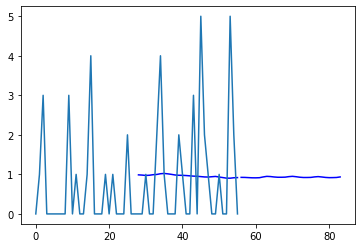

HOBBIES_1_007_CA_1


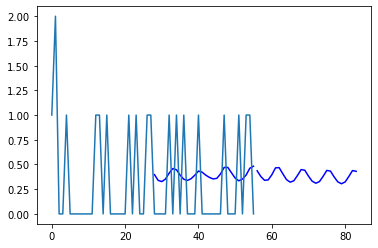

HOBBIES_1_008_CA_1


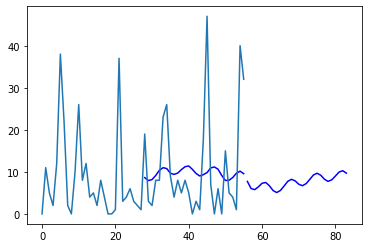

HOBBIES_1_009_CA_1


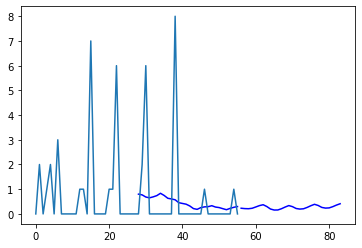

HOBBIES_1_010_CA_1


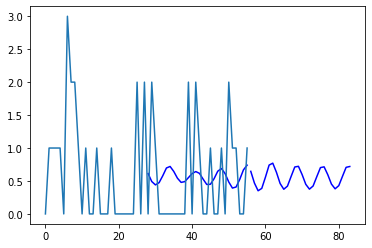

HOBBIES_1_011_CA_1


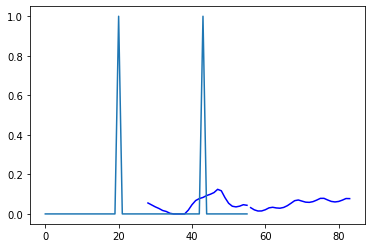

HOBBIES_1_012_CA_1


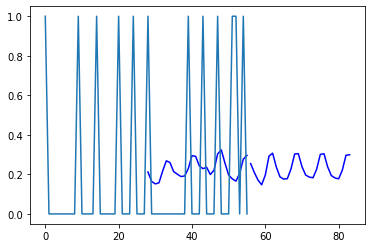

HOBBIES_1_013_CA_1


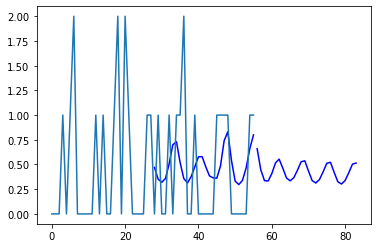

HOBBIES_1_014_CA_1


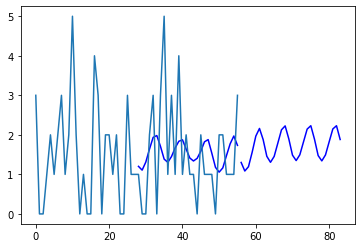

HOBBIES_1_015_CA_1


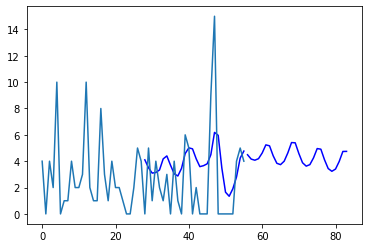

HOBBIES_1_016_CA_1


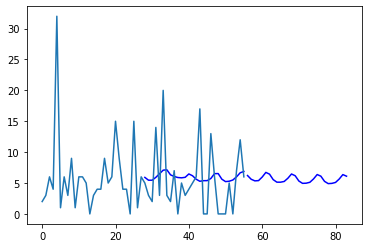

HOBBIES_1_017_CA_1


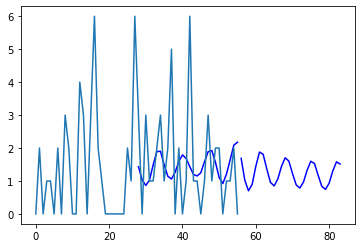

HOBBIES_1_018_CA_1


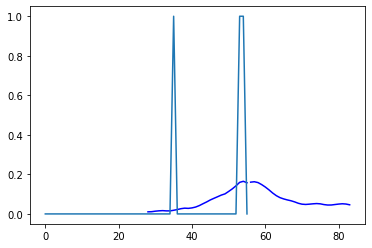

HOBBIES_1_019_CA_1


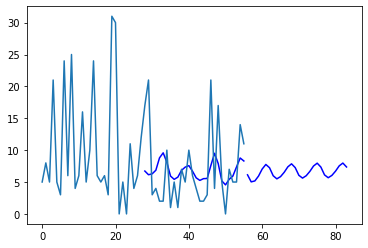

HOBBIES_1_020_CA_1


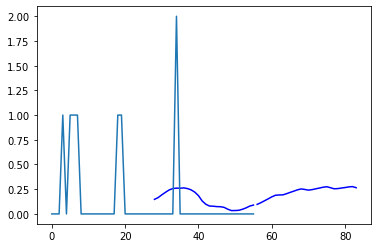

HOBBIES_1_021_CA_1


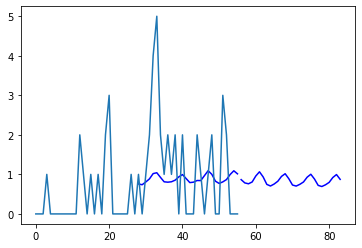

HOBBIES_1_022_CA_1


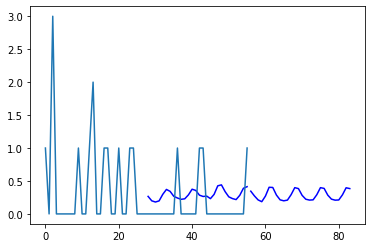

HOBBIES_1_023_CA_1


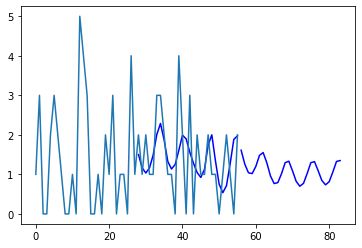

HOBBIES_1_024_CA_1


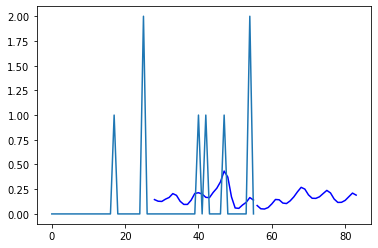

HOBBIES_1_025_CA_1


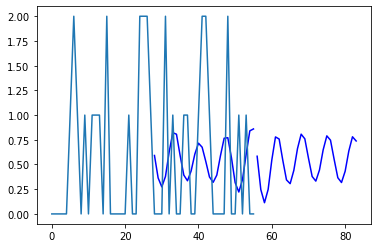

HOBBIES_1_026_CA_1


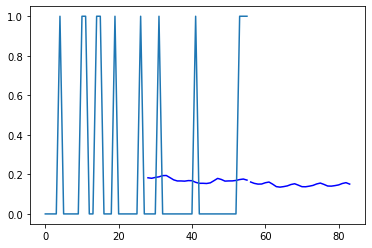

HOBBIES_1_027_CA_1


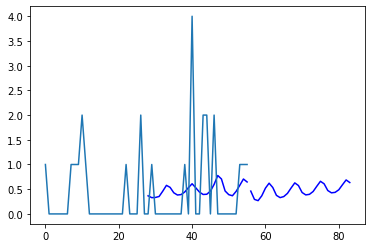

HOBBIES_1_028_CA_1


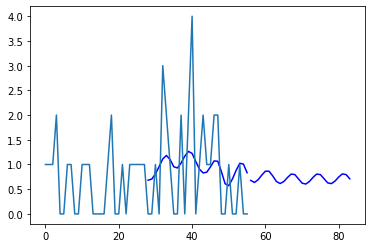

HOBBIES_1_029_CA_1


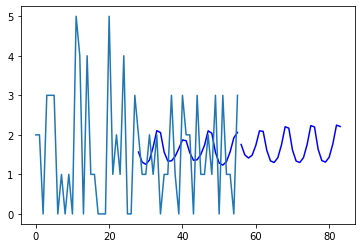

HOBBIES_1_030_CA_1


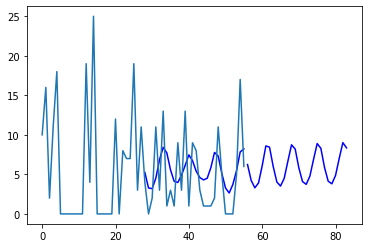

HOBBIES_1_031_CA_1


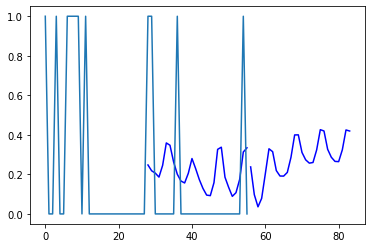

HOBBIES_1_032_CA_1


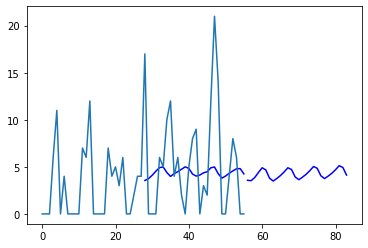

HOBBIES_1_033_CA_1


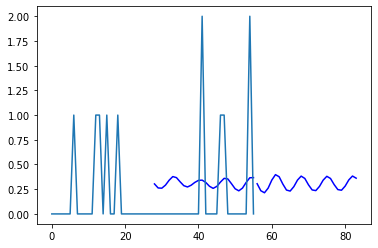

HOBBIES_1_034_CA_1


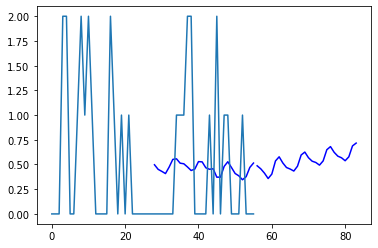

HOBBIES_1_035_CA_1


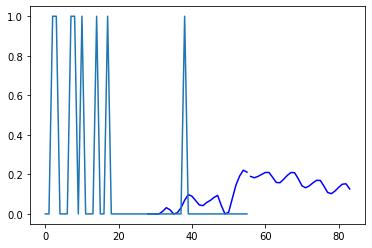

HOBBIES_1_036_CA_1


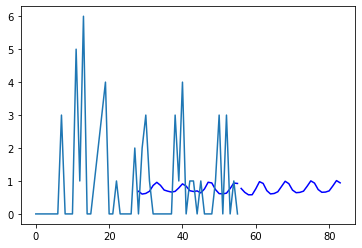

HOBBIES_1_037_CA_1


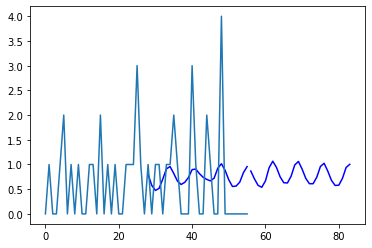

HOBBIES_1_038_CA_1


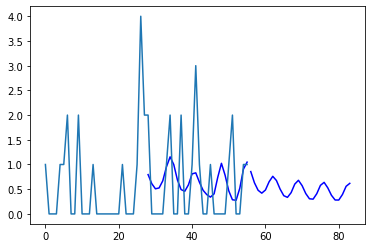

HOBBIES_1_039_CA_1


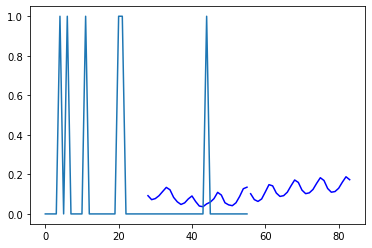

HOBBIES_1_040_CA_1


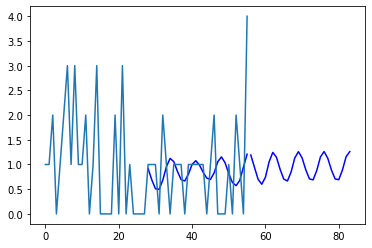

HOBBIES_1_041_CA_1


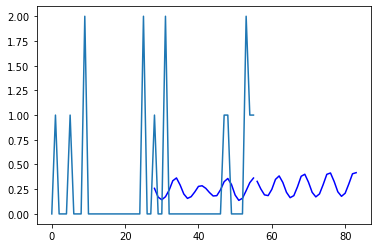

HOBBIES_1_042_CA_1


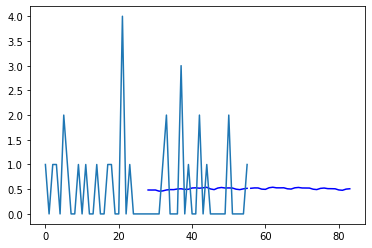

HOBBIES_1_043_CA_1


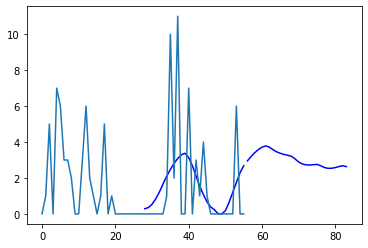

HOBBIES_1_044_CA_1


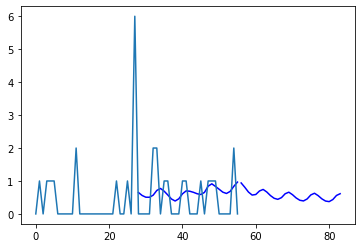

HOBBIES_1_045_CA_1


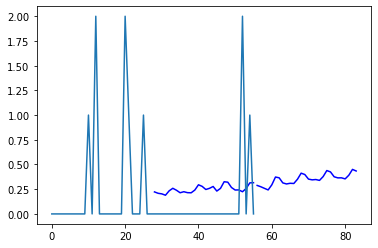

HOBBIES_1_046_CA_1


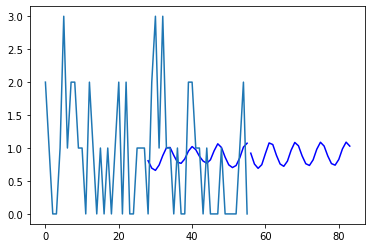

HOBBIES_1_047_CA_1


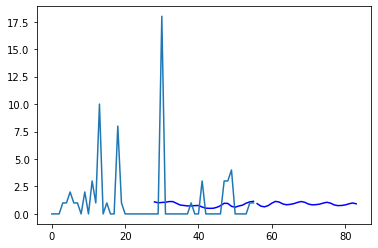

HOBBIES_1_048_CA_1


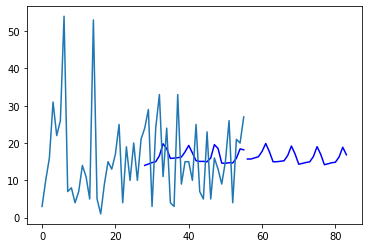

HOBBIES_1_049_CA_1


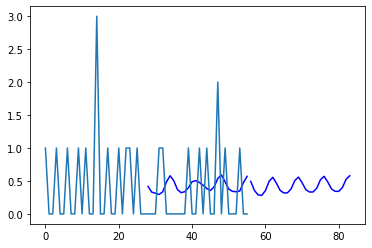

HOBBIES_1_050_CA_1


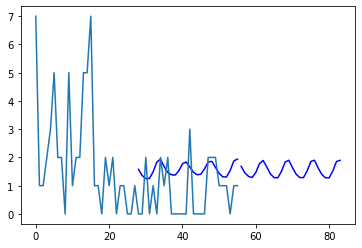

HOBBIES_1_051_CA_1


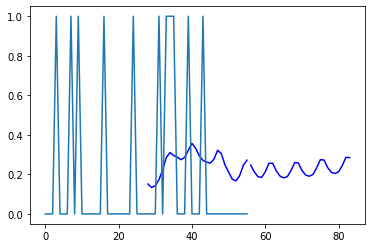

HOBBIES_1_052_CA_1


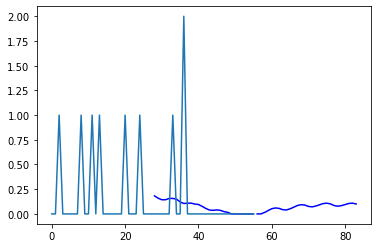

HOBBIES_1_053_CA_1


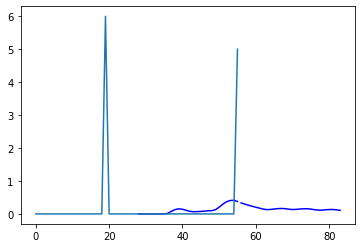

HOBBIES_1_054_CA_1


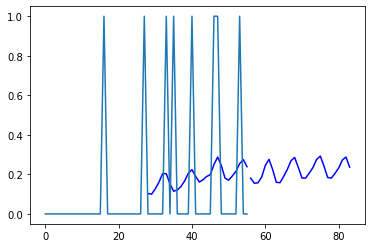

HOBBIES_1_055_CA_1


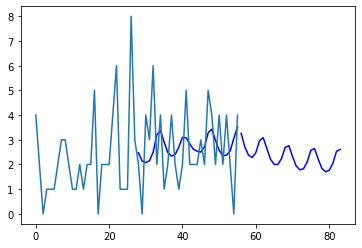

HOBBIES_1_056_CA_1


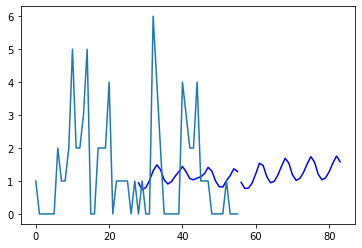

HOBBIES_1_057_CA_1


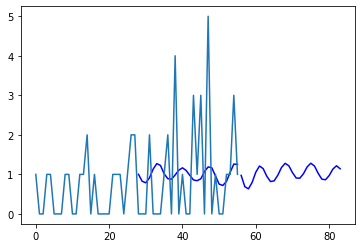

HOBBIES_1_058_CA_1


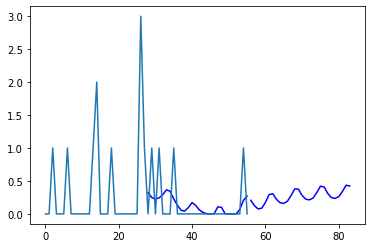

HOBBIES_1_060_CA_1


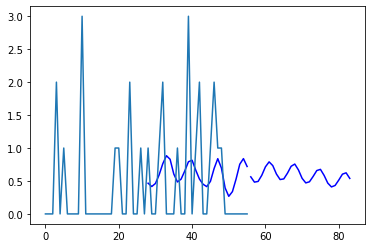

HOBBIES_1_061_CA_1


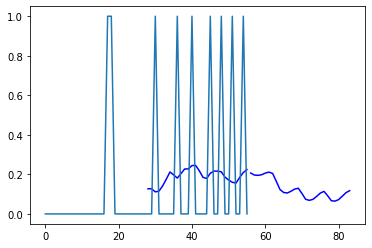

HOBBIES_1_062_CA_1


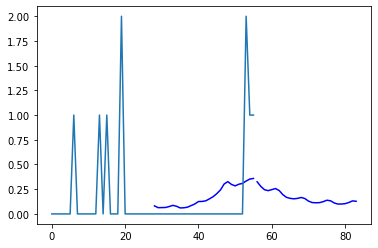

HOBBIES_1_063_CA_1


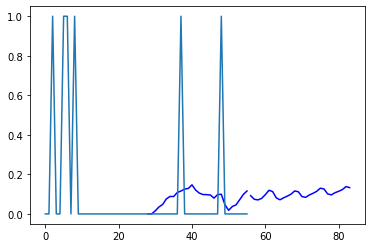

HOBBIES_1_064_CA_1


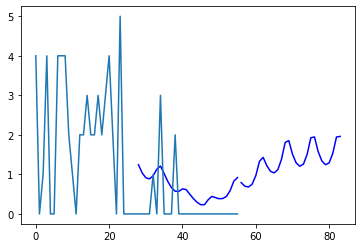

HOBBIES_1_065_CA_1


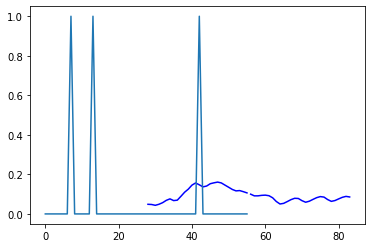

HOBBIES_1_066_CA_1


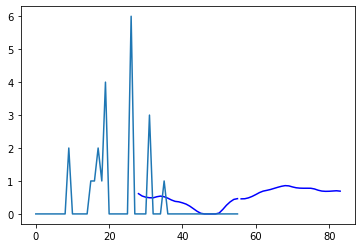

HOBBIES_1_067_CA_1


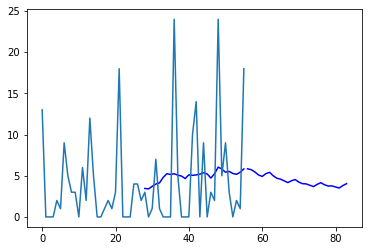

HOBBIES_1_068_CA_1


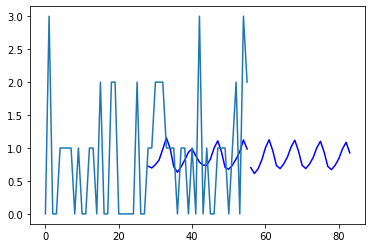

HOBBIES_1_069_CA_1


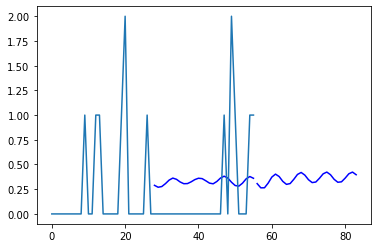

HOBBIES_1_070_CA_1


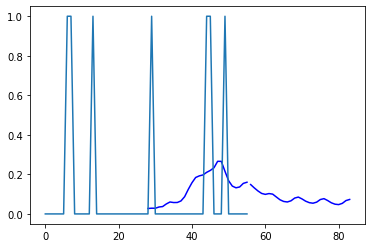

HOBBIES_1_072_CA_1


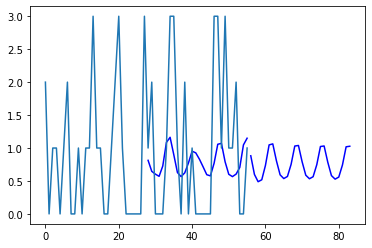

HOBBIES_1_073_CA_1


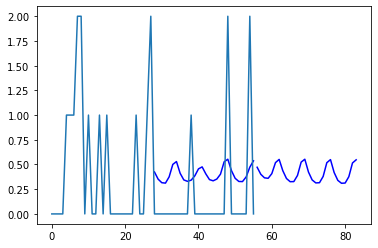

HOBBIES_1_074_CA_1


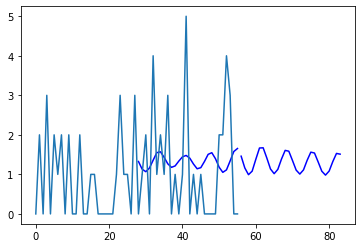

HOBBIES_1_075_CA_1


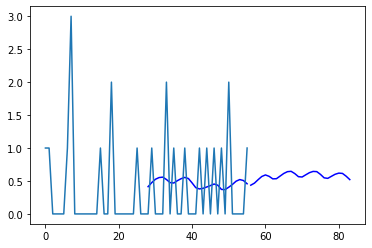

HOBBIES_1_076_CA_1


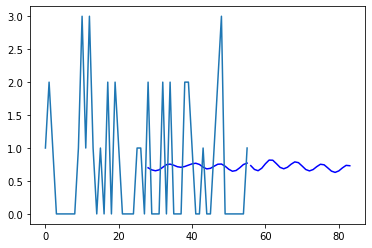

HOBBIES_1_077_CA_1


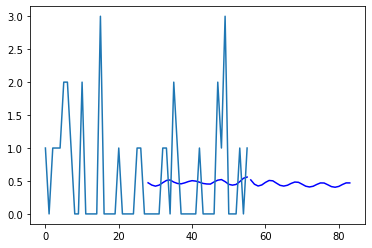

HOBBIES_1_078_CA_1


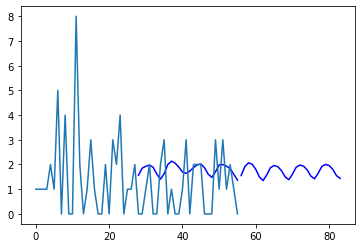

HOBBIES_1_079_CA_1


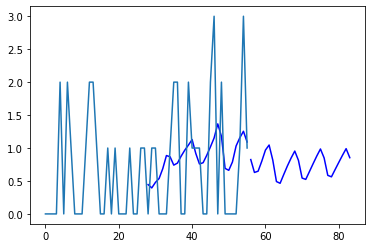

HOBBIES_1_080_CA_1


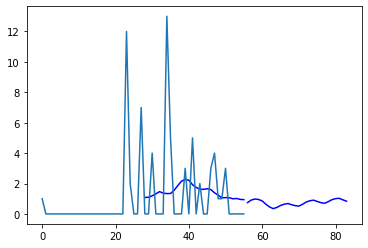

HOBBIES_1_081_CA_1


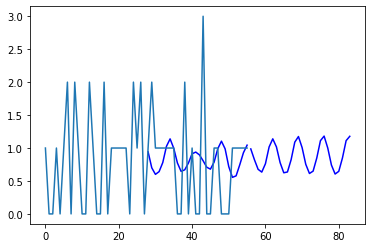

HOBBIES_1_082_CA_1


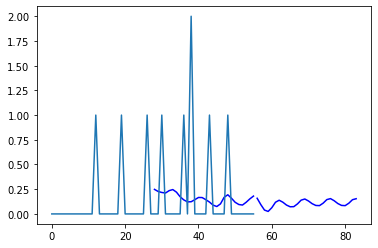

HOBBIES_1_083_CA_1


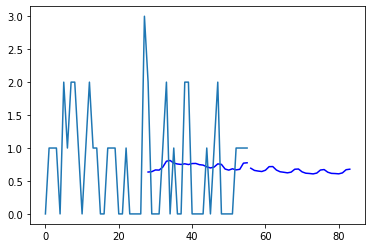

HOBBIES_1_084_CA_1


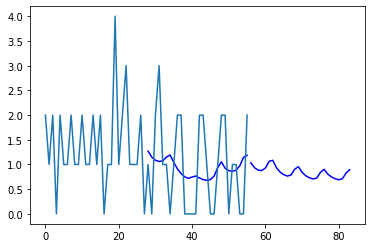

HOBBIES_1_085_CA_1


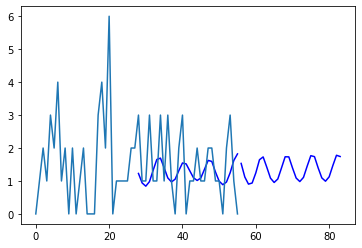

HOBBIES_1_086_CA_1


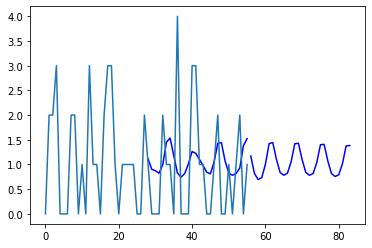

HOBBIES_1_087_CA_1


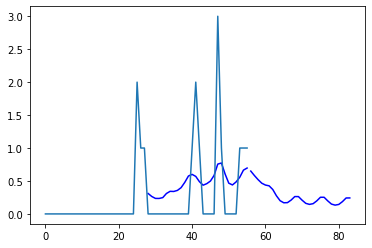

HOBBIES_1_088_CA_1


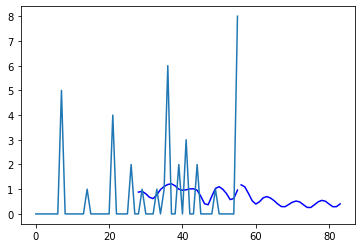

HOBBIES_1_089_CA_1


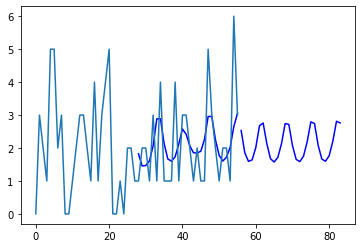

HOBBIES_1_090_CA_1


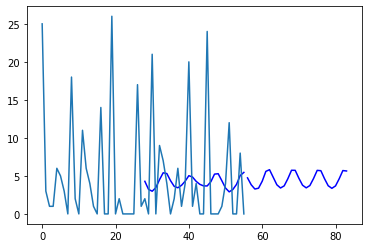

HOBBIES_1_091_CA_1


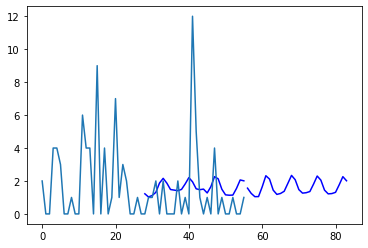

HOBBIES_1_092_CA_1


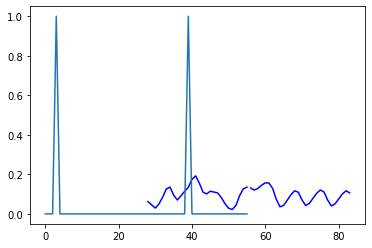

HOBBIES_1_093_CA_1


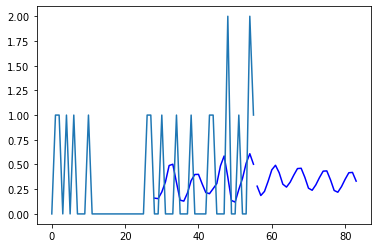

HOBBIES_1_094_CA_1


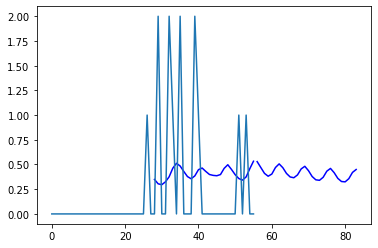

HOBBIES_1_095_CA_1


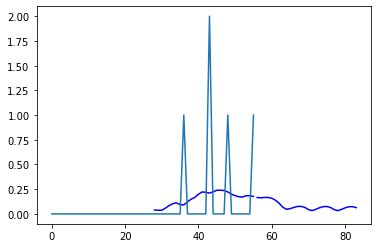

HOBBIES_1_097_CA_1


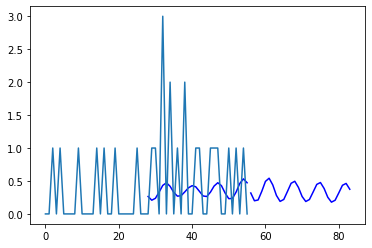

HOBBIES_1_098_CA_1


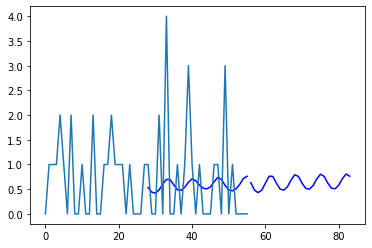

HOBBIES_1_099_CA_1


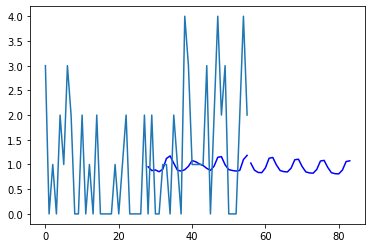

HOBBIES_1_100_CA_1


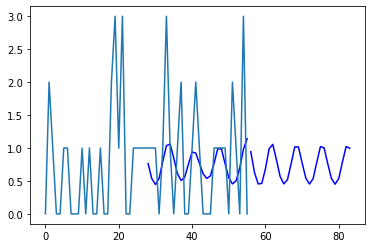

HOBBIES_1_102_CA_1


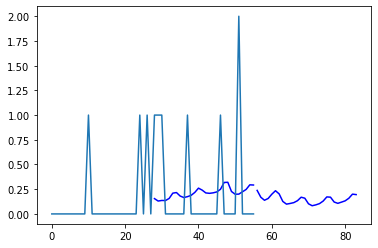

HOBBIES_1_103_CA_1


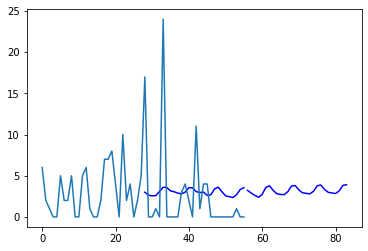

HOBBIES_1_104_CA_1


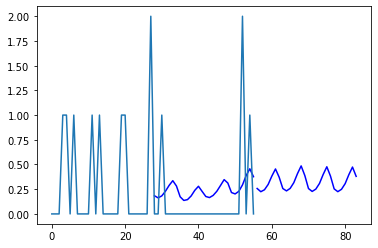

In [95]:
for i in df.id.values[:100]:
    print(i)
#     plt.show()
    plt.plot(np.arange(28,56),clstr_submission[clstr_submission.id==i+'_validation'][F].values.flatten(),'b')
    plt.plot(np.arange(56,56+28),clstr_submission[clstr_submission.id==i+'_evaluation'][F].values.flatten(),'b')
    
    plt.plot(np.arange(0,56),df[df.id==i][get_prev_56_days(N+28)].values.flatten())
    plt.show()
#     break